In [313]:
import os
import os.path 
import cv2
import tkinter as tk
import tkinter.filedialog as fd
from PIL import Image
from skimage import transform, img_as_int, exposure, img_as_ubyte
import skimage.io as io
import skimage as si
import tkinter.messagebox as mb
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import blob_log, blob_doh, blob_dog
from scipy import ndimage, spatial
from cmath import inf
import sys
import numpy as np
from scipy.optimize import curve_fit
import json
from Bio import SeqIO
from skimage.filters import gaussian
import pandas as pd
from skimage.feature import peak_local_max
from sklearn.metrics import mean_squared_error
from numpy.linalg import norm
from math import floor, ceil, exp
from skimage.registration import phase_cross_correlation
from scipy import ndimage as ndi
from scipy.io import savemat
import Polywarp
import lmfit
import itertools
import scipy.spatial
import star


root = tk.Tk()
root.attributes("-topmost", True)
root.withdraw()

''

In [314]:
def proposecands(uknquadlist, refquadlist, n=5, verbose=True):
    """
    Function that identifies similar quads between the unknown image and a reference.
    Returns a dict of (uknquad, refquad, dist, trans)
    """
    # Nothing to do if the quadlists are empty ...
    if len(uknquadlist) == 0 or len(refquadlist) == 0:
        if verbose:
            print("No quads to propose ...")
        return []

    if verbose:
        print("Finding %i best candidates among %i x %i (ukn x ref)" % (n, len(uknquadlist), len(refquadlist)))
    uknhashs = np.array([q.hash for q in uknquadlist])
    refhashs = np.array([q.hash for q in refquadlist])

    # Brute force...
    dists = scipy.spatial.distance.cdist(refhashs, uknhashs)
    uknmindistindexes = np.argmin(dists, axis=0)  # For each ukn, the index of the closest ref
    uknmindist = np.min(dists, axis=0)  # The corresponding distances
    uknbestindexes = np.argsort(uknmindist)

    candlist = []
    nmax = len(uknbestindexes)
    if verbose:
        print("We have a maximum of %i quad pairs" % (nmax))
    for i in range(min(n, nmax)):

        cand = {"uknquad": uknquadlist[uknbestindexes[i]], "refquad": refquadlist[uknmindistindexes[uknbestindexes[i]]],
                "dist": uknmindist[uknbestindexes[i]]}

        cand["trans"] = quadtrans(cand["uknquad"], cand["refquad"])
        print ((abs(cand["trans"].getrotation())), cand["dist"]) 
        if (abs(cand["trans"].getrotation()) < 5): 
             candlist.append(cand)
             if verbose:
                 print("Cand %2i (dist. %12.8f) : %s" % (i+1, cand["dist"], str(cand["trans"])))

    return candlist

In [315]:
"""
Overhaul of cosmouline's star module, for alipy2.
This module contains stuff for geometric matching algorithms.
"""

import sys
import os
import math
import numpy as np
import operator  # For sorting
import copy
import scipy.linalg
import scipy.spatial


class Dots:
    """
    Simple class to represent a single source (usually stars, but not necessarily).
    In this module we often manipulate lists of such Dots objects.
    """

    def __init__(self, x=0.0, y=0.0, props={}, fwhm=-1.0, elon=-1.0):
        """
        flux : Some "default" or "automatic" flux, might be a just good guess. Used for sorting etc.
        If you have several fluxes, colours, store them in the props dict.
        props : A placeholder dict to contain other properties of your choice (not required nor used by the methods).
        """
        self.x = float(x)
        self.y = float(y)
        
       
    def copy(self):
        return copy.deepcopy(self)

    def __getitem__(self, key):
        """
        Used for sorting list of stars.
        """
        if key == 'flux':
            return self.flux
        if key == 'fwhm':
            return self.fwhm
        if key == 'elon':
            return self.elon

  
    
    def coords(self, full=False):
        """
        Returns the coords in form of an array.

        :param full: If True, I also include flux, fwhm, elon
        :type full: boolean

        """
        if full:
            return np.array([self.x, self.y, self.flux, self.fwhm, self.elon])
        else:
            return np.array([self.x, self.y])

    def distance(self, otherstar):
        """
        Returns the distance between the two stars.
        """
        return math.sqrt(np.sum((self.coords() - otherstar.coords())**2))

    def distanceandsort(self, otherstarlist):
        """
        Returns a list of dicts(star, dist, origpos), sorted by distance to self.
        The 0th star is the closest.

        otherstarlist is not modified.
        """

        returnlist = []
        for i, star in enumerate(otherstarlist):
            dist = self.distance(star)
            returnlist.append({'dot': star, 'dist': dist, 'origpos': i})
        returnlist = sorted(returnlist, key=operator.itemgetter('dist'))  # sort stars according to dist

        return returnlist

# And now some functions to manipulate list of such stars ###


def listtoarray(starlist, full=False):
    """
    Transforms the starlist into a 2D numpy array for fast manipulations.
    First index is star, second index is x or y

    :param full: If True, I also include flux, fwhm, elon
    :type full: boolean

    """
    return np.array([star.coords(full=full) for star in starlist])


def area(dotlist, border=0.01):
    """
    Returns the area covered by the dots.
    Border is relative to max-min
    """
    if len(dotlist) == 0:
        return np.array([0, 1, 0, 1])

    if len(dotlist) == 1:
        dot = dotlist[0]
        return np.array([dot.x - 0.5, dot.x + 0.5, dot.y - 0.5, dot.y + 0.5])

    a = listtoarray(starlist)
    (xmin, xmax) = (np.min(a[:, 0]), np.max(a[:, 0]))
    (ymin, ymax) = (np.min(a[:, 1]), np.max(a[:, 1]))
    xw = xmax - xmin
    yw = ymax - ymin
    xmin = xmin - border*xw
    xmax = xmax + border*xw
    ymin = ymin - border*yw
    ymax = ymax + border*yw
    return np.array([xmin, xmax, ymin, ymax])


In [316]:
class Quad:
    """
    A geometric "hash", or asterism, as used in Astrometry.net :
    http://adsabs.harvard.edu/cgi-bin/bib_query?arXiv:0910.2233
    It is made out of 4 stars, and it is shift / scale / rotation invariant
    """

    def __init__(self, fourstars):
        """
        fourstars is a list of four stars

        We make the following attributes :
        self.hash
        self.stars (in the order A, B, C, D)

        """
        assert len(fourstars) == 4

        tests = [(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
        other = [(2, 3), (1, 3), (1, 2), (0, 3), (0, 2), (0, 1)]
        dists = np.array([fourstars[i].distance(fourstars[j]) for (i, j) in tests])
        assert np.min(dists) > 1.0

        maxindex = np.argmax(dists) # Returns the indices of the maximum values along an axis
        (Ai, Bi) = tests[maxindex]  # Indexes of stars A and B
        (Ci, Di) = other[maxindex]  # Indexes of stars C and D
        
        A = fourstars[Ai]
        B = fourstars[Bi]
        C = fourstars[Ci]
        D = fourstars[Di]

        # We look for matrix transform [[a -b], [b a]] + [c d] that brings A and B to 00 11 :
        
        
        x = B.x - A.x
        if x == 0:
            x = x+0.01
        y = B.y - A.y
        b = (x-y)/(x*x + y*y)
        a = (1.0/x) * (1.0 + b*y)
        c = b*A.y - a*A.x
        d = - (b*A.x + a*A.y)

        t = star.SimpleTransform((a, b, c, d))

        (xC, yC) = t.apply(C.x, C.y)
        (xD, yD) = t.apply(D.x, D.y)

        # Normal case
        self.hash = (xC, yC, xD, yD)

        # Break symmetries :
        testa = xC > xD
        testb = xC + xD > 1

        if testa and not testb:  # we switch C and D
            self.hash = (xD, yD, xC, yC)
            (C, D) = (D, C)

        if testb and not testa:  # We switch A and B
            self.hash = (1.0-xD, 1.0-yD, 1.0-xC, 1.0-yC)
            (A, B) = (B, A)
            (C, D) = (D, C)

        if testa and testb:
            self.hash = (1.0-xC, 1.0-yC, 1.0-xD, 1.0-yD)
            (A, B) = (B, A)

        # Checks :
        assert self.hash[0] <= self.hash[2]
        assert self.hash[0] + self.hash[2] <= 1

        self.stars = [A, B, C, D]  # Order might be different from the fourstars !

    def __str__(self):
        return "Hash : %6.3f %6.3f %6.3f %6.3f " % (
            self.hash[0], self.hash[1], self.hash[2], self.hash[3])


In [317]:
def distance(self, otherstar):
        """
        Returns the distance between the two stars.
        """
        return math.sqrt(np.sum((self.coords() - otherstar.coords())**2))

def mindist(fourstars):
    """
    Function that tests if 4 stars are suitable to make a good quad...
    """
    tests = [(0, 1), (0, 2), (0, 3), (1, 2), (1, 3), (2, 3)]
    dists = np.array([fourstars[i].distance(fourstars[j]) for (i, j) in tests])
    return np.min(dists)



def makequads1(center_coord, n=10, s=0, d=10, verbose=True):
    """
    First trivial quad maker.
    Makes combis of the n brightest stars.

    :param n: number of stars to consider (brightest ones).
    :type n: int
    :param s: how many of the brightest stars should I skip ?
        This feature is useful to avoid building quads with nearly saturated stars that are not
        available in other exposures.
    :type s: int
    :param d: minimal distance between stars
    :type d: float

    """
    quadlist = []
     

    for fourdots in itertools.combinations(center_coord[s:s+n], 4):
        if mindist(fourdots) > d:
                quadlist.append(Quad(fourdots))

    if verbose:
        print("Made %4i quads from %4i stars (combi n=%i s=%i d=%.1f)" % (len(quadlist), len(center_coord), n, s, d))

    return quadlist

In [318]:
def makequads2(dotlist, f=5.0, n=6, s=0, d=50.0, verbose=True):
    """
    Similar, but fxf in subareas roughly f times smaller than the full frame.
    s allows to skip the brightest stars in each region

    :param f: smallness of the subareas
    :type f: float
    :param n: number of stars to consider in each subarea
    :type n: int
    :param d: minimal distance between stars
    :type d: float
    :param s: number of brightest stars to skip in each subarea
    :type s: int

    """
    quadlist = []
    
    (xmin, xmax, ymin, ymax) = star.area(dotlist)

    r = 2.0 * max(xmax - xmin, ymax - ymin) / f

    for xc in np.linspace(xmin, xmax, int(f)+2)[1:-1]:
        for yc in np.linspace(ymin, ymax, int(f)+2)[1:-1]:
            dot = Dots(x=xc, y=yc)
            das = dot.distanceandsort(dotlist)
            elmnt = [element["dot"] for element in das if element["dist"] <= r]
            brightestwithinr = elmnt[s:s+n]
            for fourstars in itertools.combinations(brightestwithinr, 4):
                if mindist(fourstars) > d:
                    quadlist.append(Quad(fourstars))

    if verbose:
        print("Made %4i quads from %4i stars (combi sub f=%.1f n=%i s=%i d=%.1f)" % (len(quadlist), len(dotlist),
                                                                                     f, n, s, d))
    return quadlist

In [319]:
class ImgCat:
    """
    Represent an individual image and its associated catalog, starlist, quads etc.
    """

    def __init__(self, centers):
        """

        :param filepath: Path to the FITS file, or alternatively just a string to identify the image.
        :type filepath: string

        
        """
        self.filepath = 'default'
#         print (self.filepath)
#         (imgdir, filename) = path.split(filepath)
#         (common, ext) = path.splitext(filename)
        self.name = 'default'

       
        self.dotlist = []
        for row in centers: 
            self.dotlist.append(Dots(row[0], row[1]))      
        (xmin, xmax, ymin, ymax) = star.area(self.dotlist, border=0.01)
        self.xlim = (xmin, xmax)
        self.ylim = (ymin, ymax)
        
        self.mindist = 0.0
        self.xlim = (0.0, 0.0)  # Will be set using the catalog -- no need for the FITS image.
        self.ylim = (0.0, 0.0)

        self.quadlist = []
        self.quadlevel = 0  # encodes what kind of quads have already been computed

    def __str__(self):
        return "%20s: approx %4i x %4i, %4i stars, %4i quads, quadlevel %i" % (path.basename(self.filepath),
                                                                               self.xlim[1] - self.xlim[0],
                                                                               self.ylim[1] - self.ylim[0],
                                                                               len(self.starlist), len(self.quadlist),
                                                                               self.quadlevel)

    def makemorequads(self, verbose=True):
        """
        We add more quads, following the quadlevel.
        """
        # if not add:
        #    self.quadlist = []
        if verbose:
            print("Making more quads, from quadlevel %i ..." % self.quadlevel)
        if self.quadlevel == 0:
            self.quadlist.extend(makequads1(self.dotlist, n=10, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 1:
            self.quadlist.extend(makequads2(self.dotlist, f=3, n=10, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 2:
            self.quadlist.extend(makequads2(self.dotlist, f=6, n=10, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 3:
            self.quadlist.extend(makequads2(self.dotlist, f=12, n=10, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 4:
            self.quadlist.extend(makequads2(self.dotlist, f=15, n=10, s=0, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 5:
            self.quadlist.extend(makequads2(self.dotlist, f=18, n=10, s=0, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 6:
            self.quadlist.extend(makequads2(self.dotlist, f=21, n=10, s=0, d=self.mindist, verbose=verbose))
        elif self.quadlevel == 7:
            self.quadlist.extend(makequads2(self.dotlist, f=24, n=10, s=0, d=self.mindist, verbose=verbose))  
        elif self.quadlevel == 8:
            self.quadlist.extend(makequads2(self.dotlist, f=27, n=10, s=0, d=self.mindist, verbose=verbose))  
        elif self.quadlevel == 9:
            self.quadlist.extend(makequads2(self.dotlist, f=30, n=10, s=0, d=self.mindist, verbose=verbose)) 
        elif self.quadlevel == 10:
            self.quadlist.extend(makequads2(self.dotlist, f=33, n=10, s=0, d=self.mindist, verbose=verbose))   
        elif self.quadlevel == 11:
            self.quadlist.extend(makequads2(self.dotlist, f=36, n=10, s=0, d=self.mindist, verbose=verbose))  
        elif self.quadlevel == 12:
            self.quadlist.extend(makequads2(self.dotlist, f=39, n=10, s=0, d=self.mindist, verbose=verbose))    
        elif self.quadlevel == 13:
            self.quadlist.extend(makequads2(self.dotlist, f=42, n=10, s=0, d=self.mindist, verbose=verbose)) 
        elif self.quadlevel == 14:
            self.quadlist.extend(makequads2(self.dotlist, f=45, n=10, s=0, d=self.mindist, verbose=verbose)) 
        else:
            return False

        self.quadlist = removeduplicates(self.quadlist, verbose=verbose)
        self.quadlevel += 1
        return True
    
def removeduplicates(quadlist, verbose=True):
    """
    Returns a quadlist without quads with identical hashes...
    """
    # To avoid crash in lexsort if quadlist is too small :
    if len(quadlist) < 2:
        return quadlist
    hasharray = np.array([q.hash for q in quadlist])

    order = np.lexsort(hasharray.T)
    hasharray = hasharray[order]
    diff = np.fabs(np.diff(hasharray, axis=0))
    ui = np.ones(len(hasharray), 'bool')
    ui[1:] = (diff >= 0.000001).any(axis=1)
    if verbose:
        print("Removing %i/%i duplicates" % (len(quadlist) - np.sum(ui), len(quadlist)))

    return [quad for (quad, u) in zip(quadlist, ui) if u]
def quadtrans(uknquad, refquad):
    """
    Quickly return a transform estimated from the stars A and B of two quads.
    """
    return star.fitstars(uknquad.stars[:2], refquad.stars[:2])



class Identification:
    """
    Represents the identification of a transform between two ImgCat objects.
    Regroups all the star catalogs, the transform, the quads, the candidate, etc.

    All instance attributes are listed below.

    :ivar ref: ImgCat object of the reference image
    :ivar ukn: ImgCat object of the unknown image
    :ivar ok: boolean, True if the idendification was successful.
    :ivar trans: The SimpleTransform object that represents the geometrical transform from ukn to ref.
    :ivar uknmatchstars: A list of Star objects of the catalog of the unknown image...
    :ivar refmatchstars: ... that correspond to these Star objects of the reference image.
    """

    def __init__(self, ref, ukn):
        """
        :param ref: The reference image
        :type ref: ImgCat object
        :param ukn: The unknown image, whose transform will be adjusted to match the ref
        :type ukn: ImgCat object
        """
        self.ref = ref
        self.ukn = ukn

        self.ok = False

        self.trans = None
        self.uknmatchstars = []
        self.refmatchstars = []
        self.cand = None

    def findtrans(self, r=5.0, verbose=False):
        """
        Find the best trans given the quads, and tests if the match is sufficient
        """

        # Some robustness checks
        if len(self.ref.dotlist) < 4:
            if verbose:
                print("Not enough dot in the reference catalog.")
            return
        if len(self.ukn.dotlist) < 4:
            if verbose:
                print("Not enough dot in the unknown catalog.")
            return

        # First question : how many stars should match ?
        if len(self.ukn.dotlist) < 5:  # Then we should simply try to get the smallest distance...
            minnident = 4
        else:
            minnident = max(4, min(8, len(self.ukn.dotlist)/5.0))  # Perfectly arbitrary, let's see how it works

        # Hmm, arbitrary for now :
        minquaddist = 0.02

        # Let's start :
        if self.ref.quadlevel == 0:
            self.ref.makemorequads(verbose=verbose)
        if self.ukn.quadlevel == 0:
            self.ukn.makemorequads(verbose=verbose)

        while self.ok is False:
            # Find the best candidates
            cands = proposecands(self.ukn.quadlist, self.ref.quadlist, n=4, verbose=verbose)

            if len(cands) != 0 and cands[0]["dist"] < minquaddist:
                # If no quads are available, we directly try to make more ones.
                for cand in cands:
                    # Check how many stars are identified...
                    nident = star.identify(self.ukn.dotlist, self.ref.dotlist, trans=cand["trans"],
                                           r=r, verbose=verbose, getstars=False)
                    if nident >= minnident:
                        self.trans = cand["trans"]
                        self.cand = cand
                        self.ok = True
                        break  # get out of the for

            if self.ok is False:
                # We add more quads...
                addedmorerefquads = self.ref.makemorequads(verbose=verbose)
                addedmoreuknquads = self.ukn.makemorequads(verbose=verbose)

                if addedmorerefquads is False and addedmoreuknquads is False:
                    break  # get out of the while, we failed.

        #if  ((self.ok) and (abs(self.trans.getrotation()))<5):  # we refine the transform
        if  (self.ok) :
            # get matching stars :
            (self.uknmatchstars, self.refmatchstars) = star.identify(self.ukn.dotlist, self.ref.dotlist,
                                                                     trans=self.trans, r=r, verbose=False,
                                                                     getstars=True)
            # refit the transform on them :
            if verbose:
                print("Refitting transform (before/after) :")
                print(self.trans)
            newtrans = star.fitstars(self.uknmatchstars, self.refmatchstars)
            if newtrans is not None:
                self.trans = newtrans
                if verbose:
                    print(self.trans)
            # Generating final matched star lists :
            (self.uknmatchstars, self.refmatchstars) = star.identify(self.ukn.dotlist, self.ref.dotlist,
                                                                     trans=self.trans, r=r, verbose=verbose,
                                                                     getstars=True)

            if verbose:
                print("I'm done!")

        else:
            if verbose:
                print("Failed to find transform!")

 
def run(ref, ukns, skipsaturated=False, r=5.0, n=500, sexkeepcat=False, sexrerun=True,
        verbose=False, polarMode=None, refpolar=False, camera=None):
    """
    Top-level function to identify transorms between images.
    Returns a list of Identification objects that contain all the info to go further.

    :param ref: coordinates of beads in a reference image.
    :type ref: np.array(:,2)

    :param ukns: coordinates of beads in an unknown image.
    :type ukns: np.array(:,2)

    :param hdu: The hdu of the fits files (same for all) that you want me to use. 0 is somehow "automatic".
    If multihdu, 1 is usually science.

    if the identification fails).

    :param skipsaturated: Should I skip saturated stars ?
    :type skipsaturated: boolean

    :param r: Identification radius in pixels of the reference image (default 5.0 should be fine).
    :type r: float
    :param n: Number of brightest stars of each image to consider (default 500 should be fine).
    :type n: int

    :param sexkeepcat: Put this to True if you want me to keep the SExtractor catalogs (in a dir "alipy_cats").
    :type sexkeepcat: boolean
    :param sexrerun: Put this to False if you want me to check if I have some previously kept catalogs
    (with sexkeepcat=True), instead of running SExtractor again on the images.
    :type sexrerun: boolean
    """

    if verbose:
        print(10*"#", " Preparing reference ...")
    ref = ImgCat(ref)
    
    ref.makemorequads(verbose=verbose)

    identifications = []

   

    if verbose:
            print(10*"#", "Processing %s" % (ukns))

    ukn = ImgCat(ukns)
        
    idn = Identification(ref, ukn)
    idn.findtrans(verbose=verbose, r=r)
    identifications.append(idn)

    return identifications

def identify(uknstars, refstars, trans=None, r=5.0, verbose=True, getstars=False):
    """
    Allows to:
     * get the number or matches, i.e. evaluate the quality of the trans
     * get corresponding stars from both lists (without the transform applied)

    :param getstars: If True, I return two lists of corresponding stars, instead of just the number of matching stars
    :type getstars: boolean

    Inspired by the "formpairs" of alipy 1.0 ...

    """

    if trans is not None:
        ukn = listtoarray(trans.applystarlist(uknstars))
    else:
        ukn = listtoarray(uknstars)
    ref = listtoarray(refstars)

    dists = scipy.spatial.distance.cdist(ukn, ref)  # Big table of distances between ukn and ref
    mindists = np.min(dists, axis=1)  # For each ukn, the minimal distance
    minok = mindists <= r  # booleans for each ukn
    minokindexes = np.argwhere(minok).flatten()  # indexes of uknstars with matches

    if verbose:
        print("%i/%i stars with distance < r = %.1f (mean %.1f, median %.1f, std %.1f)" % (np.sum(minok),
                                                                                           len(uknstars), r,
                                                                                           np.mean(mindists[minok]),
                                                                                           np.median(mindists[minok]),
                                                                                           np.std(mindists[minok])))
    matchuknstars = []
    matchrefstars = []

    for i in minokindexes:  # we look for the second nearest ...
        sortedrefs = np.argsort(dists[i, :])
        firstdist = dists[i, sortedrefs[0]]
        seconddist = dists[i, sortedrefs[1]]
        if seconddist > 2.0*firstdist:  # Then the situation is clear, we keep it.
            matchuknstars.append(uknstars[i])
            matchrefstars.append(refstars[sortedrefs[0]])
        else:
            pass  # Then there is a companion, we skip it.

    if verbose:
        print("Filtered for companions, keeping %i/%i matches" % (len(matchuknstars), np.sum(minok)))

    if getstars is True:
        return (matchuknstars, matchrefstars)
    else:
        return len(matchuknstars)


In [320]:
# coords_t = a
# n_t = int(len(coords_t)/2)
# coords_t_seq = coords_t[:n_t,:]
# coords_t_FRET = coords_t[n_t:,:]
# [deltax, deltay] = np.mean(np.subtract(coords_t_seq,coords_t_FRET), axis = 0)


In [321]:
# Skip by default! Figuring out the displacement for tiles.
file_path = fd.askopenfilename(title = "Choose the position list")

pos_file = open(file_path)
data = json.load(pos_file)
POS = data['POSITIONS']

labels = [P['LABEL'] for P in POS]
posX = [P['DEVICES'][0]['X'] for P in POS]
posY = [P['DEVICES'][0]['Y'] for P in POS]
# print(min(posX), max(posX), min(posY), max(posY))
upper_left_um_x = min(posX)
upper_left_um_y = max(posY)
file_path_coords = fd.askopenfilename(title = "Choose the coordinate .npy file", initialdir = os.path.dirname(file_path))
coords_t = np.load(file_path_coords)
n_t = int(len(coords_t)/2)
coords_t_seq = coords_t[:n_t,:]
coords_t_FRET = coords_t[n_t:,:]
[deltax, deltay] = np.mean(np.subtract(coords_t_seq,coords_t_FRET), axis = 0)
print(deltax,deltay)
print(upper_left_um_x, upper_left_um_y)

-3418.928302825079 373.85090453851814
26529.7 -913.1


In [322]:
# Initial match smFRET vs Seq
# deltax = 4660 # for tile 1 220815
# deltay = -25
# upper_left_um_x = 26091.3
# upper_left_um_y = -690

def get_pos(record):
    
    des = record.description
    tile_num = int(des.split(' ')[0].split(':')[4])
    x_pos = int(des.split(' ')[0].split(':')[5])
    y_pos = int(des.split(' ')[0].split(':')[6])
    return tile_num, x_pos, y_pos


def generate_img(x, y, x_min, y_min, x_max, y_max, r, blurred, sigma):
    # x_min = min(x)
    # x_max = max(x)
    # y_min = min(y)
    # y_max = max(y)
    x_range = x_max - x_min
    y_range = y_max - y_min
    # x_range = 27994
    # y_range = 27174
    img = np.zeros(shape=(x_range, y_range))
    for i in range(0, len(x)):
        img[min(x_range-1,max(0,int(x[i]-r))):min(x_range-1,max(0,int(x[i]+r+1))),min(y_range-1,max(0,int(y[i]-r))):min(y_range-1,max(0,int(y[i]+r+1)))] = 200

    if blurred:
        img = gaussian(img, sigma=sigma)
    im = Image.fromarray(img)
    new_im = im.convert("L")
#     new_im.save(op_path)
    return new_im


def generate_with_marker(x, y, marker_x, marker_y, op_path, csv_path):
    x_min = min(x)
    x_max = max(x)
    y_min = min(y)
    y_max = max(y)
    x_range = x_max - x_min + 1
    y_range = y_max - y_min + 1
    img = np.zeros(shape=(x_range, y_range, 3))
    marker_dic = {'index': range(0, len(marker_x)), 'x': [], 'y': []}
    for i in range(0, len(x)):
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, x[i] - x_min - j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    max(0, y[i] - y_min - k), 0:3] = 255
                img[min(x_range - 1, x[i] - x_min + j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
                img[max(0, x[i] - x_min - j),
                    min(y_range - 1, y[i] - y_min + k), 0:3] = 255
    for i in range(0, len(marker_x)):
        marker_dic['x'].append(marker_x[i] - x_min)
        marker_dic['y'].append(marker_y[i] - y_min)
        for j in range(0, 5):
            for k in range(0, 5):
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    max(0, marker_y[i] - y_min - k), 1:3] = 0
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[min(x_range - 1, marker_x[i] - x_min + j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 0] = 255
                img[max(0, marker_x[i] - x_min - j),
                    min(y_range - 1, marker_y[i] - y_min + k), 1:3] = 0
    blurred_img = gaussian(img, sigma=3, multichannel=True)
    im = Image.fromarray(blurred_img.astype(np.uint8))
    new_im = im.convert("P")
    new_im.save(op_path)
    df = pd.DataFrame(marker_dic)
    df.to_csv(csv_path, index=True, header=True)


def get_coordinates(fastq_path):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                x_coordinate_01.append(x_pos)
                y_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                x_coordinate_02.append(x_pos)
                y_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, x_coordinate_02, y_coordinate_02


def get_xy_coordinates(fastq_path, with_seq):
    x_coordinate_01 = []
    y_coordinate_01 = []
    x_coordinate_02 = []
    y_coordinate_02 = []
    x_seq_coordinate_01 = []
    y_seq_coordinate_01 = []
    x_seq_coordinate_02 = []
    y_seq_coordinate_02 = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == 1101:
                if with_seq != seq:
                    x_coordinate_01.append(x_pos)
                    y_coordinate_01.append(y_pos)
                else:
                    x_seq_coordinate_01.append(x_pos)
                    y_seq_coordinate_01.append(y_pos)
            elif tile_num == 1102:
                if with_seq != seq:
                    x_coordinate_02.append(x_pos)
                    y_coordinate_02.append(y_pos)
                else:
                    x_seq_coordinate_02.append(x_pos)
                    y_seq_coordinate_02.append(y_pos)
#     print('Coordinates are found.')
    return x_coordinate_01, y_coordinate_01, \
        x_coordinate_02, y_coordinate_02, \
        x_seq_coordinate_01, y_seq_coordinate_01, \
        x_seq_coordinate_02, y_seq_coordinate_02


def get_seq_coordinates(fastq_path, tile):
    x_coordinate = []
    y_coordinate = []
    sequences = []
    for record in SeqIO.parse(fastq_path, "fastq"):
        if record is not None:
            tile_num, x_pos, y_pos = get_pos(record)
            seq = str(record.seq)
            if tile_num == tile:
                x_coordinate.append(x_pos/10)
                y_coordinate.append(y_pos/10)
                sequences.append(seq)
#     print('Coordinates are found.')
    return x_coordinate, y_coordinate, sequences

def scaling_seq (x, y):
    
    x = int(deltax+(335-x_border)/2 + (x - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (y - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     
#     x = int(-850+(305-x_border)/2 + (x - 26384)/0.34) # tile 2 06/09/2022;
#     y = int(-385+(154-y_border)/2  - (y + 407.1)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(-3967+(305-x_border)/2 + (x - 26384)/0.34) # tile 1 06/09/2022; 
#     y = int(-405+(154-y_border)/2  - (y + 407.1)/0.34)   

#     x = int(1700+(330-x_border)/2  + (x - 27246.18)/0.34 ) ### tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2 - (y + 1149.66)/0.34)
#     x = int(2329+(330-x_border)/2 + (x - 28522.9)/0.34)  ### tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (y + 1313.3)/0.34)

    
    
    return (x,y)
    

def blob_detection(img, min_sigma, max_sigma, threshold, method=0):
    """This function is mostly used for detecting the beads in any image.

    Args:
        img_path (string): The absolute path of the input image.
        min_sigma (int): The minimum sigma, lower it is, smaller the blob will be detected.
        max_sigma (int): The maximum sigma, higher it is, bigger the blob will be detected.
        threshold (float): Higher it is, higher the intensities of blobs.
        method (int, optional): 0 for Difference of Gaussian (DoG) and 1 for Determinant of Hessian (DoH). 
        They should be applied with different combination of parameters. DoG is more suitable for fret movies,
        while DoH is more suitable for sequencing images. Defaults to 0.

    Returns:
        centers: A numpy array containing the coordinates of all the centers.
    """
    #img = io.imread(img_path)
    fig, ax = plt.subplots()
    ax.imshow(img)
    if method == 0:
        blob = blob_dog(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    else:
        blob = blob_doh(
            img, min_sigma=min_sigma, max_sigma=max_sigma, threshold=threshold
        )
    i = 0
    r = 3
    centers = []
    h, w = img.shape
    for blob in blob:
        y, x, r = blob
        if y > r and y < (h - r) and x > r and x < (w - r):
            centers.append(
                ndimage.measurements.center_of_mass(
                    img[int(y - r) : int(y + r + 1), int(x - r) : int(x + r + 1)]
                )
            )
            centers[i] = list(np.add(np.flip(centers[i]), [x - r, y - r]))
            x1, y1 = centers[i]
            c = plt.Circle([x1, y1], 3, color="red", linewidth=1, fill=False)
            ax.add_patch(c)
            
            i += 1
    ax.set_axis_off()
    plt.show()
    return np.array(centers)

def count_nearest_pts(src, dst, radius):
    """Counting the number of nearest neighbors for each given point.

    Args:
        src (numpy array): (N, 2) shape array. Build the kd tree based on this.
        dst (numpy array): (N, 2) shape array. For each point in this array, find the nearest neighbors in src array.
        radius (int): The maximum searching radius.

    Returns:
        res, idx: res is the distance for the point and its neighbor, 'inf' means no neighbor in given search radius. 
        idx is the index for the neighbor in src array.
    """
    tree = spatial.KDTree(src)
    res, idx = tree.query(dst, k=1, distance_upper_bound=radius)
    for i in range(0, len(idx)):
        idx_t = np.argwhere(idx == idx[i])
        if len(idx_t) > 1:
            res_t = [res[j] for j in idx_t]
            if res[i] > min(res_t): res[i] = inf
    return res, idx

class App(tk.Tk):
    
    def __init__(self):
        super().__init__()
        btn_file = tk.Button(self, text="Choose file",
                             command=self.choose_file)
        btn_dir = tk.Button(self, text="Choose folder",
                             command=self.choose_directory)
        btn_file.pack(padx=60, pady=10)
        btn_dir.pack(padx=60, pady=10)
        

    def choose_file(self):
        filetypes = (("All formats ", "*"),
                     ("Text file", "*.txt"),
                     ("Image", "*.jpg *.gif *.png *.bmp *.tif"))
        filename = fd.askopenfilename(title="Open file", initialdir="/",
                                      filetypes=filetypes)
        if filename:
            self.st = filename
            #print (filename)
           
            
    def choose_directory(self):
        directory = fd.askdirectory(title="Open folder", initialdir="/")
        if directory:
            self.dir = directory
#             print (directory)


In [268]:
#Instead of calculating the bead mapping we can load the transformation generated with channel_map


tr_G2R = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the forward transform file", initialdir = "C:/Users/Anton/Documents/Jupyter home/ExampleData/Test_folder/220717_FC_Nano_200nm_Multicolor/original")
tr_G2R.params = np.load(file_path)
tr_R2G = transform.PolynomialTransform()
file_path = fd.askopenfilename(title = "Choose the inverse transform file", initialdir = os.path.dirname(file_path))
tr_R2G.params = np.load(file_path)



In [269]:
# x_border = int(input("Enter the x border"))
# y_border = int(input("Enter the y border"))
x_border = 400
y_border = 200

apriori_tr = transform.SimilarityTransform()
apriori_tr.params = np.array([[ 5.98278480e-01, -2.04811207e-03,  0],
 [ 2.04811207e-03,  5.98278480e-01,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([x_border,y_border],apriori_tr([512,256]))
dx, dy = delta[0]
apriori_tr.params[0,2] = dx
apriori_tr.params[1,2] = dy

apriori_tr_inv = transform.SimilarityTransform()
apriori_tr_inv.params = np.array([[ 1.67127284e+00,  5.72133913e-03,  0],
 [-5.72133913e-03,  1.67127284e+00,  0],
 [ 0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

# Centering the tranformation to the x_border and y_border
delta = 0.5*np.subtract([512,256],apriori_tr_inv([x_border,y_border]))
dx, dy = delta[0]
apriori_tr_inv.params[0,2] = dx
apriori_tr_inv.params[1,2] = dy


In [323]:
# fastq_path = 'E:/MUSCLE data/0722.fastq'
fastq_path = fd.askopenfilename(title = "Choose the FASTQ file", initialdir = "D:/Experiments/MUSCLE DONUTS/")
base_path = os.path.dirname(fastq_path)

# x_coord, y_coord, sequence = get_seq_coordinates(fastq_path,  tile=1102)
x_coord, y_coord, sequence = get_seq_coordinates(fastq_path,  tile=1101)

# print(len(x_coordinate_01))
# print(len(x_coordinate_02))
# print(np.max(x_coordinate_01))
# print(np.min(x_coordinate_01))

# max_y  = max (y_coord)
# max_x = max (x_coord)
max_y  = max_x = 3000 # To ensure that the alignment is not affected by changes in max x and y


x_coord1 = np.subtract(max_y, y_coord)
y_coord = np.subtract(max_x, x_coord)

x_coord = x_coord1

# Correction for the shift between FASTQ and cluster images
x_coord = np.subtract(x_coord, 97.5)
y_coord = np.subtract(y_coord, 3)

max_x1 = ceil(max_y)
max_y = ceil(max_x)
max_x = max_x1
# max_x = ceil(max_x)
# max_y = ceil(max_y)

# generate_with_marker(x_coordinate_01, y_coordinate_01, x_coordinate_01m, y_coordinate_01m,
#   '/Users/qinhanhou/Desktop/DeindlLab/220722/SeqImg/1101_marked_sigma3.png',
#   '/Users/qinhanhou/Desktop/DeindlLab/220722/SeqImg/1101_marked_sigma3.csv')

library_seq =  'GGTCTC'

In [297]:

library_seq =  'GGTCTC'

['Pos181', 'Pos182', 'Pos183', 'Pos184', 'Pos185', 'Pos186', 'Pos187', 'Pos188', 'Pos213', 'Pos214', 'Pos215', 'Pos216', 'Pos217', 'Pos218', 'Pos219', 'Pos220', 'Pos247', 'Pos248', 'Pos249', 'Pos250', 'Pos251', 'Pos252', 'Pos253', 'Pos254', 'Pos279', 'Pos280', 'Pos281', 'Pos282', 'Pos283', 'Pos284', 'Pos285', 'Pos286', 'Pos313', 'Pos314', 'Pos315', 'Pos316', 'Pos317', 'Pos318', 'Pos319', 'Pos320', 'Pos345', 'Pos346', 'Pos347', 'Pos348', 'Pos349', 'Pos350', 'Pos351', 'Pos352', 'Pos379', 'Pos380', 'Pos381', 'Pos382', 'Pos383', 'Pos384', 'Pos385', 'Pos386', 'Pos411', 'Pos412', 'Pos413', 'Pos414', 'Pos415', 'Pos416', 'Pos417', 'Pos418', 'Pos445', 'Pos446', 'Pos447', 'Pos448', 'Pos449', 'Pos450', 'Pos451', 'Pos452', 'Pos477', 'Pos478', 'Pos479', 'Pos480', 'Pos481', 'Pos482', 'Pos483', 'Pos484', 'Pos511', 'Pos512', 'Pos513', 'Pos514', 'Pos515', 'Pos516', 'Pos517', 'Pos518', 'Pos543', 'Pos544', 'Pos545', 'Pos546', 'Pos547', 'Pos548', 'Pos549', 'Pos550', 'Pos577', 'Pos578', 'Pos579', 'Pos580',

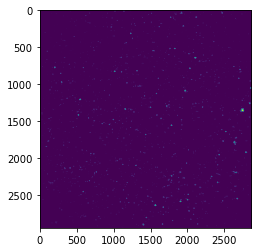

In [324]:
file_path = fd.askopenfilename(title = "Choose the position list", initialdir = base_path)
current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)


pos_file = open(file_path)
data = json.load(pos_file)
POS = data['POSITIONS']

labels = [P['LABEL'] for P in POS]
posX = [P['DEVICES'][0]['X'] for P in POS]
posY = [P['DEVICES'][0]['Y'] for P in POS]


#X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos287']
#Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos287']

labels_res = []
posX_res = []
posY_res = []
for i,x in enumerate(labels):
#     x = int(-850+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 2 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-385+(154-y_border)/2  - (posY[i] + 407.1)/0.34)  
#     x = int(-3967+(305-x_border)/2 + (posX[i] - 26384)/0.34) # tile 1 06/09/2022; 305 and 154 are the size of tfd 512 by 256 image
#     y = int(-405+(154-y_border)/2  - (posY[i] + 407.1)/0.34)   
#     x = int(1700+(330-x_border)/2 + (posX[i] - 27246.18)/0.34) # tile 2 19/07/2022
#     y = int(1571+(170-y_border)/2  - (posY[i] + 1149.66)/0.34)   
    x = int(deltax+(335-x_border)/2 + (posX[i] - upper_left_um_x)/0.34) # tile 2 06/09/2022;
    y = int(deltay+(150-y_border)/2  - (posY[i] - upper_left_um_y)/0.34)  # 305 and 154 are the size of tfd 512 by 256 image
#     x = int(2329+(330-x_border)/2 + (posX[i] - 28522.9)/0.34) # tile 1 19/07/2022
#     y = int(2042+(170-y_border)/2 - (posY[i] + 1313.3)/0.34) 
    if (x > 0 ) and (y > 0):
        if (y+y_border< 2944) and (x+x_border <2866) :
            labels_res.append (labels[i])
            posX_res.append (posX[i])
            posY_res.append( posY[i])


print (labels_res)

#print(usable_green_beads)
#print(usable_red_beads)
fastq_image = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
fastq_image.save(os.path.join(current_direct, 'FASTQ_image.png'))


counter = 0  

file_path = fd.askopenfilename(title = "Choose the MIN projection image", initialdir = base_path)
seq = io.imread(file_path)#reading the sequence image
seq = seq.astype("ushort") 

file_path = fd.askopenfilename(title = "Choose the MAX projection image", initialdir = base_path)
seq_max = io.imread(file_path)#reading the sequence image
seq_max = seq_max.astype("ushort")
image_array_max = np.asarray(seq_max)
good_pos = []
matched_sequences = []
matched_centers_red = []
matched_centers_green = []

image_array_seq = np.asarray(seq) #array from sequence image
image_array_FQ = np.asarray(fastq_image) #array from fastq_image
beads_dir = fd.askdirectory(title = "Choose the beads folder", initialdir = base_path)
path_smFRET = fd.askdirectory(title = "Choose the smFRET folder", initialdir = base_path)
# path_smFRET = fd.askdirectory(title = "Choose the smFRET movie", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/Cas9/green")
plt.figure()
plt.imshow(seq)


In [177]:
# current_direct = fd.askdirectory(title = "Choose the output folder", initialdir = base_path)


In [88]:
# temp = path_smFRET
# path_smFRET = beads_dir
# beads_dir = path_smFRET
# print(path_smFRET, beads_dir)

H:/MUSCLE data/20220824_FC_Nano_Cas9_CCR5/Cas9/green H:/MUSCLE data/20220824_FC_Nano_Cas9_CCR5/Cas9/green


In [329]:
processed_pos = []

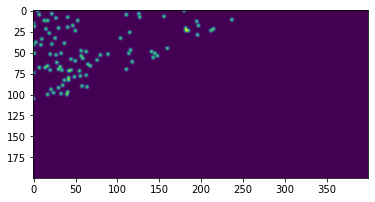

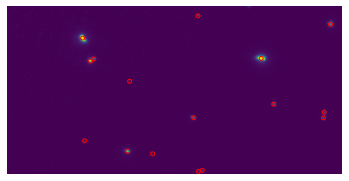

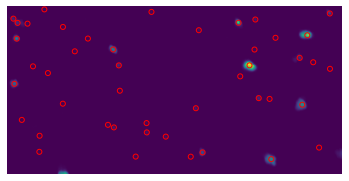

2.2561838768635893 0.0503861332363897
161.95435990534367 0.06982595392720581
162.79790908295382 0.07034181927203384
117.23624435927069 0.0721019220788954
1.2558308689037778 0.013101530865387895
1.2558308689037778 0.013101530865387895
1.2558308689037778 0.01386814373347053
1.5689944309078396 0.014151579470436474
Pos183
 [[126.11581011  50.94098596]
 [288.99351823  69.91400039]
 [132.86511091  70.00674677]
 [166.27699877 150.02546125]
 [224.9056281  121.15056281]
 [228.43338762  27.94153094]
 [300.01073337 109.08528412]
 [132.86511091  70.00674677]
 [232.90873362 173.94262841]
 [126.96875    144.07349537]
 [232.90873362 173.94262841]
 [188.95667447 155.07025761]
 [115.78633771  51.8062653 ]
 [279.04434294  71.01262963]
 [122.9019151   72.87553904]
 [156.68044841 155.47191021]
 [217.19643288 125.08182377]
 [221.31939568  31.78808928]
 [290.36693506 112.88810023]
 [125.88506272  71.01921786]
 [224.79905057 173.18275626]
 [117.22851175 145.78382216]
 [221.30794573 174.17400611]
 [179.368200

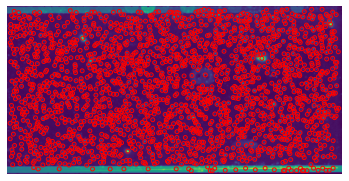

Matched clusters before polywarp:  5
Matched clusters after polywarp:  5
Out of  1970  smFRET peaks and  22  clusters
Percentage of matched smFRET peaks:  0
Percentage of matched clusters:  22


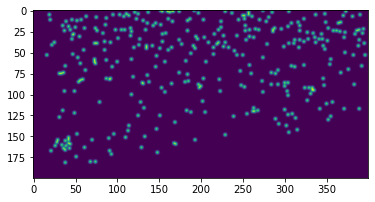

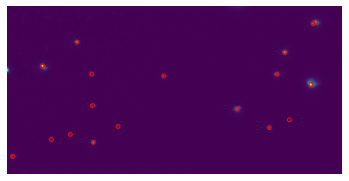

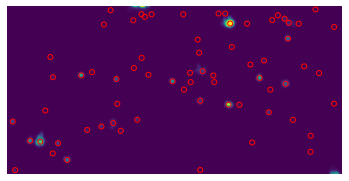

1.168347689878275 0.009226683881457486
1.7566657763895592 0.014346774689097149
1.168347689878275 0.015010447648395295
154.27889841981457 0.015774502394982095
Pos184
 [[ 88.00485712  81.94182523]
 [332.11792311  92.01712236]
 [306.29986708  64.2865751 ]
 [135.18843996 148.10875421]
 [334.95485269  38.01734903]
 [334.95485269  38.01734903]
 [263.96601866 116.90457282]
 [197.12536272  89.04984716]
 [301.09504363  84.93315881]
 [131.07699531 115.94929577]
 [ 60.26895623 163.01791246]
 [112.07477083 142.99166999]
 [129.97005741  86.17726947]
 [154.86132277 134.92136544]
 [ 95.02906209 147.09687362]
 [312.03731707 125.96463415]
 [ 79.16599797  77.36837389]
 [324.43672473  95.03607517]
 [300.631864    65.62281627]
 [125.12872335 147.12791122]
 [328.88227025  38.18679575]
 [326.47842164  39.38709891]
 [256.85655966 117.07497476]
 [189.81117241  86.80081547]
 [293.34142522  85.44132005]
 [124.49839098 113.59850392]
 [ 51.38419535 159.87579325]
 [104.14053201 139.86502621]
 [124.08515874  84.764

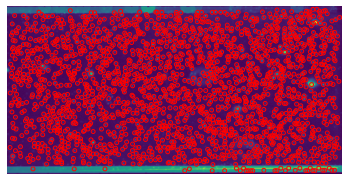

Matched clusters before polywarp:  19
Matched clusters after polywarp:  19
Out of  2014  smFRET peaks and  46  clusters
Percentage of matched smFRET peaks:  0
Percentage of matched clusters:  41


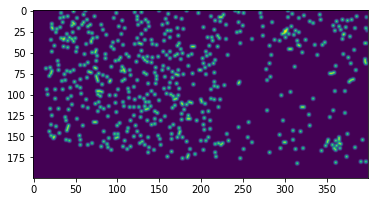

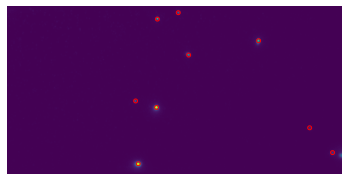

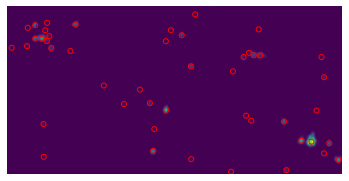

0.8389344593469877 0.02140723408820555
93.60056415167462 0.034965451058184605
15.255099480091689 0.04852586847782244
168.24331740844335 0.08362531190580968
1.1901191733576073 0.012023015888635455
0.3359572437294403 0.014513064553099706
0.3359572437294403 0.014513064553100152
1.1901191733576073 0.01589651523191909
Pos185
 [[189.28811493 123.06240991]
 [174.00744433 172.09305417]
 [189.03015075  41.08542714]
 [281.91296151  59.96520031]
 [219.04172261  71.10591125]
 [170.00363783 115.08771221]
 [208.04563538  33.89936813]
 [351.00354556 159.95013996]
 [330.19062883 137.01382197]
 [183.13460997 115.49022017]
 [166.22667305 166.93978002]
 [184.19043241  34.67487545]
 [276.70776436  54.81076192]
 [212.66722637  67.66981162]
 [164.00402566 109.50575067]
 [203.28653155  28.89162077]
 [344.02719289 157.35487852]
 [323.15531286 134.60816371]]
Automatically matched beads:  9


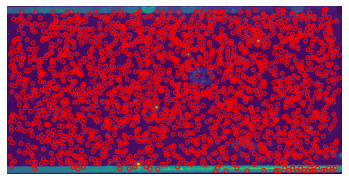

Matched clusters before polywarp:  86
Matched clusters after polywarp:  87
Out of  2025  smFRET peaks and  113  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  76


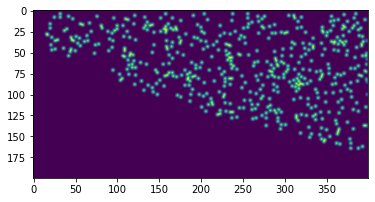

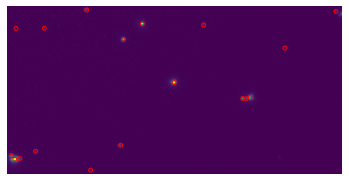

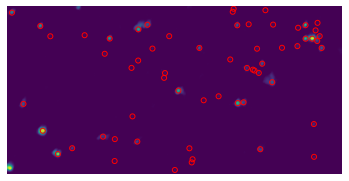

26.64692499058618 0.01815877383083326
1.3533488363106112 0.019241967609710406
25.74173823221221 0.03145341452619088
1.4092582960541529 0.03153997602710051
Pos186
 [[204.11510169 100.08576374]
 [173.04132231  49.90633609]
 [ 60.07366263 175.92089741]
 [155.98245614  64.18947368]
 [275.00792531 115.01035142]
 [275.00792531 115.01035142]
 [154.97739362 160.97562057]
 [121.97003861  37.95073359]
 [ 60.07366263 175.92089741]
 [229.0841729   49.10659734]
 [ 77.08730615 168.9178633 ]
 [304.19793256  67.95648536]
 [ 60.07366263 175.92089741]
 [127.86315789 184.23157895]
 [199.37779984  92.79816105]
 [170.31752023  38.93186979]
 [ 53.22864875 162.42045473]
 [152.96292213  53.17589962]
 [268.76115264 106.80463321]
 [265.27867408 107.92389034]
 [150.22470827 150.01855145]
 [119.50908202  26.12346688]
 [ 50.27575676 159.36313773]
 [226.57139189  40.21447132]
 [ 72.43039846 155.30968998]
 [300.68500876  61.5494478 ]
 [ 57.88020053 161.76901514]
 [122.61985235 172.63374859]]
Automatically matched be

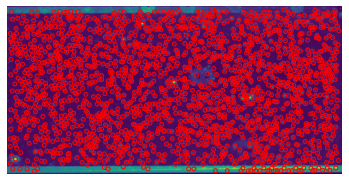

Matched clusters before polywarp:  55
Matched clusters after polywarp:  52
Out of  2029  smFRET peaks and  78  clusters
Percentage of matched smFRET peaks:  2
Percentage of matched clusters:  66


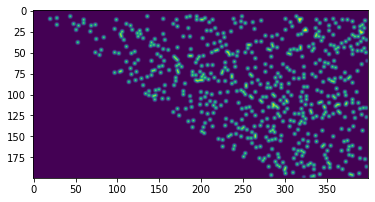

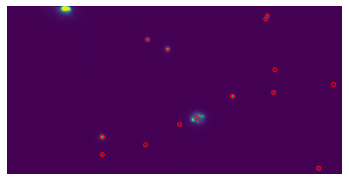

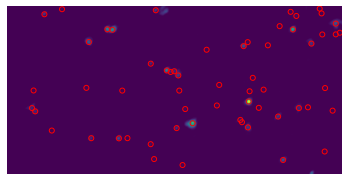

0.9418722554593654 0.016180334625948308
0.9418722554593654 0.017178318255646818
0.8645726890342078 0.018272666660676413
0.9418722554593654 0.01885909570439625
Pos214
 [[132.96251843 157.13901504]
 [190.18924242  76.01848485]
 [250.00337838 117.89189189]
 [221.06081227 139.10411806]
 [171.03830846  67.90845771]
 [282.02402789  47.00592652]
 [282.02402789  47.00592652]
 [288.09614264 113.11127754]
 [329.17803439 182.96812933]
 [201.9143986  144.90210711]
 [170.94494238 164.09731114]
 [133.50172397 142.26762861]
 [193.61416903  62.3107301 ]
 [252.71788126 105.50059834]
 [220.10033797 125.42645937]
 [175.11800613  53.33333222]
 [284.74596317  32.13000681]
 [283.35172778  35.00922234]
 [290.28545211 102.19365153]
 [331.35072873 171.6279971 ]
 [204.12845256 131.11982839]
 [172.98359245 149.65442711]]
Automatically matched beads:  11


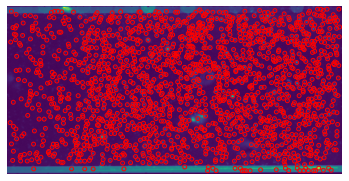

Matched clusters before polywarp:  90
Matched clusters after polywarp:  85
Out of  1730  smFRET peaks and  158  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  53


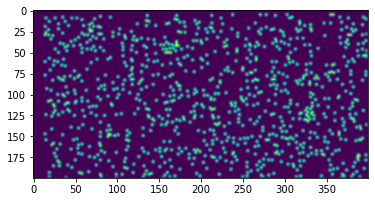

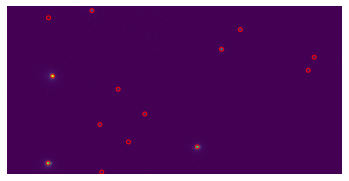

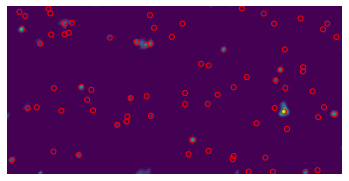

0.886457871746029 0.007478413743871223
5.38891039325856 0.04503768294374455
170.04862087367587 0.05198293951717492
48.98918914766169 0.057664548523185886
Pos215
 [[ 88.11614589  95.94484075]
 [ 85.04623438 177.06514691]
 [221.0607519  159.02290164]
 [240.23103448  70.00344828]
 [121.99524457  36.8267663 ]
 [258.07702334  51.04775447]
 [171.16055756 130.1244192 ]
 [130.99797489 140.99392467]
 [320.1238451   87.87300963]
 [146.9304799  109.0720709 ]
 [325.94566445  75.10252227]
 [ 88.15420015  86.4650146 ]
 [ 83.7464501  166.0500724 ]
 [220.21465328 151.68019978]
 [242.73737218  62.49673624]
 [124.30714014  26.76395959]
 [260.03330878  44.53842233]
 [172.40280367 121.47478797]
 [131.19195032 130.92443924]
 [322.10207668  81.94795277]
 [148.03513493  98.63907161]
 [327.5532571   70.00511999]]
Automatically matched beads:  11


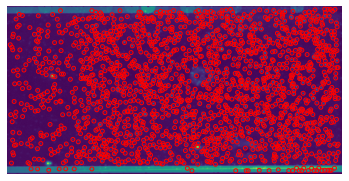

Matched clusters before polywarp:  148
Matched clusters after polywarp:  145
Out of  1753  smFRET peaks and  228  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  63


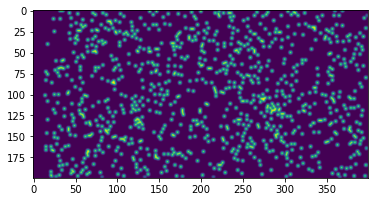

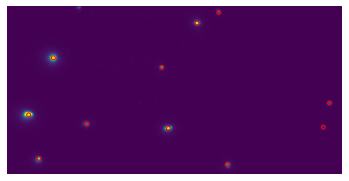

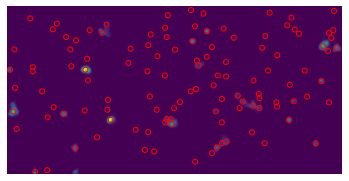

1.0203088161686082 0.02412104661114097
1.929175519659166 0.02980251086752049
1.929175519659166 0.03384486838654782
1.929175519659166 0.03469218187277328
0.7547897188953743 0.012001173795003954
1.0539828124409931 0.014571574510106157
0.7547897188953743 0.016069260280031448
0.7547897188953743 0.016069260280031517
Pos216
 [[ 93.02020175  75.17659603]
 [220.98912093  41.19085721]
 [ 66.96614656 127.99613867]
 [ 80.95567421 168.90633632]
 [187.89498807  82.0477327 ]
 [250.01254303 167.99583578]
 [123.11823945 135.09151684]
 [238.07609063  29.06112614]
 [341.92352941 112.97338936]
 [336.20385808 135.07571478]
 [ 88.82302013  69.72405778]
 [220.50279158  38.52434067]
 [ 66.13811312 121.93580076]
 [ 75.39147116 161.82191503]
 [188.07299054  78.9358633 ]
 [247.68036582 167.79664493]
 [119.19631645 130.2918925 ]
 [240.33762999  28.89403953]
 [341.26378601 111.97603534]
 [335.67740351 133.98799863]]
Automatically matched beads:  10


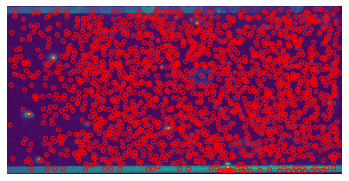

Matched clusters before polywarp:  121
Matched clusters after polywarp:  117
Out of  1786  smFRET peaks and  234  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  50


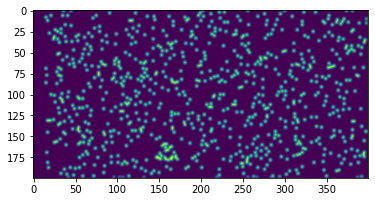

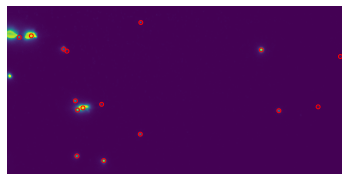

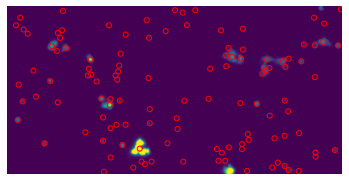

1.091855647055139 0.028331266536004103
0.24358684475597533 0.03303264404033331
10.605919039512578 0.03321324349659657
10.605919039512578 0.039880040613230174
38.28905750323286 0.02503308964017563
38.28905750323286 0.02503308964017563
107.47808911942921 0.026937044421100117
107.47808911942921 0.026937044421100117
149.00681277049077 0.01091226825767023
3.469519463072705 0.010996832634910261
3.469519463072705 0.010996832634910261
3.469519463072705 0.01099683263491031
Pos217
 [[112.13510886 109.95591926]
 [114.03313609 132.11400394]
 [112.13510886 109.95591926]
 [112.13510886 109.95591926]
 [106.22264151  89.11698113]
 [122.87621483 110.28439898]
 [106.22264151  89.11698113]
 [115.80035077 115.7014121 ]
 [110.13284293 159.64976768]
 [110.82907922 117.58015981]
 [108.9487134  109.27084884]
 [ 98.43279278  61.90905049]
 [132.90706477 112.46943904]
 [101.33899252  63.70227976]]
Automatically matched beads:  7


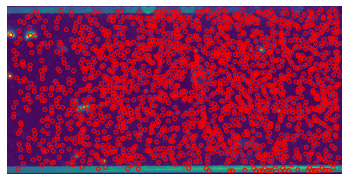

Matched clusters before polywarp:  30
Matched clusters after polywarp:  29
Out of  1850  smFRET peaks and  234  clusters
Percentage of matched smFRET peaks:  1
Percentage of matched clusters:  12


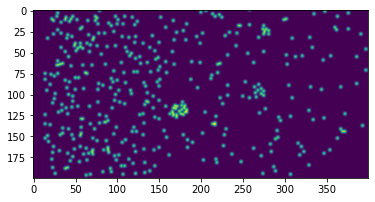

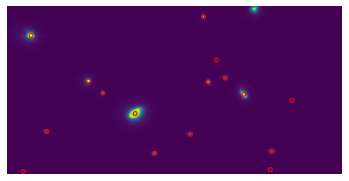

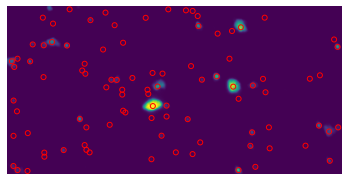

1.8140615227636872 0.03872510128831237
45.29610600176358 0.053460447582844496
50.63032016885433 0.057735934442076406
149.0414251889363 0.05817329538542548
77.80634716242 0.016949689126028036
45.2511340085395 0.017039621470508085
45.2511340085395 0.017039621470508123
61.0920233073956 0.017548489365960075
77.80634716242 0.01694968912602796
77.80634716242 0.016949689126028036
77.80634716242 0.016949689126028036
61.0920233073956 0.017548489365959145
13.198809193452377 0.008280148440986835
13.198809193452377 0.008280148440986835
77.80634716242 0.016949689126028036
61.0920233073956 0.017548489365959145
13.198809193452377 0.008280148440986835
13.198809193452377 0.008280148440986835
65.97180138327802 0.014282977943655155
61.0920233073956 0.017548489365959145
13.198809193452377 0.008280148440986835
13.198809193452377 0.008280148440986835
65.97180138327802 0.014282977943655155
178.0266523935924 0.02244077787924948
178.0266523935924 0.02244077787924948
21.040040580537486 0.02256811806637577
169.3

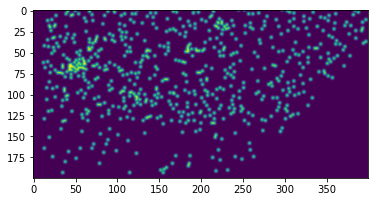

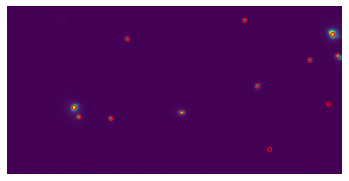

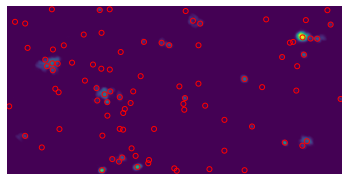

0.457125382752303 0.014886033423430955
0.3869984921816033 0.016355680513855476
0.457125382752303 0.02034394247912362
0.5806641818735392 0.0216220924056752
Pos248
 [[115.85676042 104.51768402]
 [352.44587424  36.55447982]
 [211.93983954 109.07128256]
 [353.9583671   57.12685574]
 [119.04933698 113.88551182]
 [146.94749403 114.92243437]
 [283.11786654  86.20953545]
 [327.93060472  59.97964602]
 [162.91239958  41.89703109]
 [344.91136601 100.07716371]
 [291.98840666 142.97086801]
 [107.824825   115.23512459]
 [344.62636088  49.25145328]
 [206.44953185 120.3309687 ]
 [349.11110977  68.90248771]
 [111.9654498  123.73066898]
 [141.29117238 125.45409664]
 [275.44771133  96.1271947 ]
 [323.35942596  72.8664619 ]
 [156.54149933  52.68085459]
 [340.53475879 113.09051601]
 [286.56110748 154.24869192]]
Automatically matched beads:  11


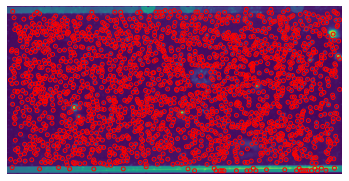

Matched clusters before polywarp:  76
Matched clusters after polywarp:  74
Out of  1955  smFRET peaks and  124  clusters
Percentage of matched smFRET peaks:  3
Percentage of matched clusters:  59


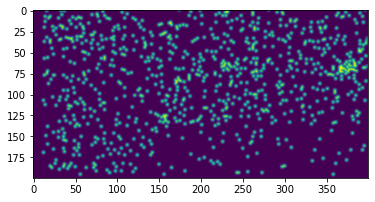

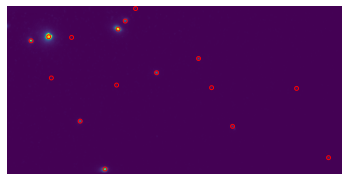

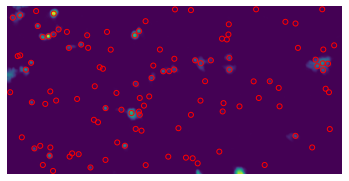

0.9399615205767874 0.03158460605244489
119.08677625822355 0.04465418063794689
104.03794989755129 0.07553896435585444
70.5516818670761 0.07644007988253225
139.04717018293567 0.025736705932307972
59.27164443571153 0.028723224386775974
59.27164443571153 0.028723224386775974
0.9399615205767874 0.03158460605244489
92.53525057766812 0.014674584304414153
92.53525057766812 0.014674584304414153
29.517252647645996 0.020141977673562298
126.13531505622882 0.021819505540285083
92.53525057766812 0.014674584304414153
92.53525057766812 0.014674584304414153
126.13531505622882 0.021819505540285083
126.13531505622882 0.021819505540285274
92.53525057766812 0.014674584304414153
175.25101374143324 0.014731941876865232
175.25101374143324 0.014731941876865232
126.13531505622882 0.021819505540285083
92.53525057766812 0.014674584304414153
175.25101374143324 0.014731941876865048
175.25101374143324 0.014731941876865048
68.69911145603677 0.024035482706281936
175.25101374143324 0.014731941876865048
175.251013741433

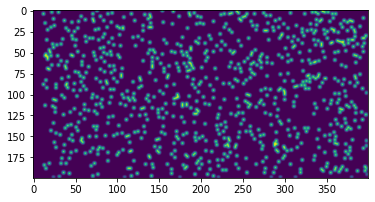

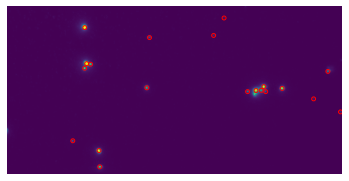

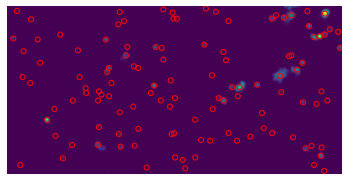

112.50485531060006 0.06357967749536429
164.427072091583 0.06400085092711116
141.40858542519265 0.0641799452032902
80.00429665772421 0.06928557076680361
144.67301251078118 0.02333755272400923
144.67301251078118 0.02333755272400923
19.084585413273626 0.029092114256863387
19.084585413273626 0.029092114256863436
7.028309156663254 0.013493347521590206
7.028309156663254 0.01349334752159033
24.556209400381547 0.022309083510526014
24.556209400381547 0.02230908351052617
5.033003307007041 0.015584366366315154
90.7587330992497 0.01854232273136216
90.7587330992497 0.01854232273136219
90.7587330992497 0.01854232273136219
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
9.056224708964988 0.02097660109916692
88.95363457462255 0.030862409433397093
88.95363457462255 0.030862409433397093
88

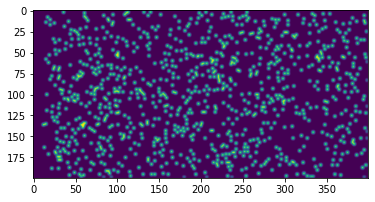

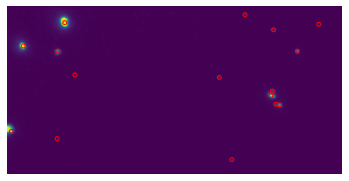

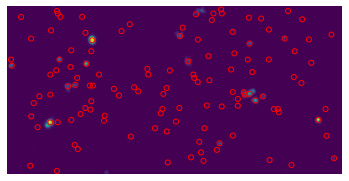

1.3117205752014018 0.006092674402304532
1.579723066056905 0.006343659408304962
1.3117205752014018 0.007802884044631026
0.3036939528277575 0.00882643132036692
Pos251
 [[ 61.97810634  62.93389252]
 [101.1313726   39.89446158]
 [289.05426286 103.99646038]
 [ 51.06834753 138.12456443]
 [296.08362471 111.95728438]
 [312.04390244  62.98861789]
 [ 94.12989601  68.13697392]
 [240.99382716  87.79012346]
 [288.97445092  43.94150605]
 [296.08362471 111.95728438]
 [330.84853368  37.9081534 ]
 [253.17237878 162.98502158]
 [ 61.27966711  58.86513987]
 [ 99.42391485  37.64247841]
 [287.91368575 105.07138258]
 [ 50.26775541 137.0740976 ]
 [295.66903089 113.57732552]
 [312.12237633  64.5326658 ]
 [ 92.9820983   63.70974253]
 [240.60389133  88.23437106]
 [290.51133829  44.81835012]
 [292.20488269 112.96165284]
 [331.7978746   39.88663574]
 [251.85559092 163.54065052]]
Automatically matched beads:  12


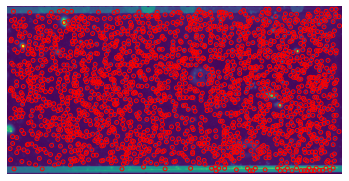

Matched clusters before polywarp:  155
Matched clusters after polywarp:  151
Out of  1938  smFRET peaks and  280  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  53


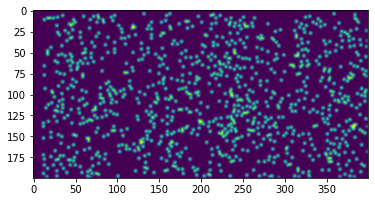

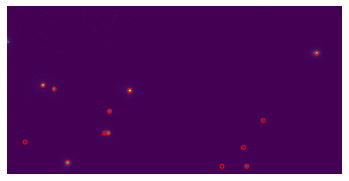

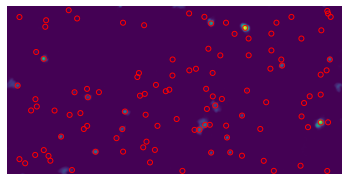

9.138489113302361 0.0293352291823385
8.602850842341242 0.030866995173490334
8.602850842341242 0.03778181614567177
9.138489113302361 0.04134968330584206
1.2915205878761418 0.016436415212813943
168.53137932176384 0.021068530227082185
8.602850842341242 0.030866995173490334
84.70895818704197 0.036427135177869996
Pos252
 [[158.12477064 106.16513761]
 [ 79.94370284 102.07835171]
 [105.07463219 173.17235845]
 [327.9818872   70.18156182]
 [137.01533879 146.08920328]
 [265.95477273 173.92090909]
 [140.08233793 125.12211527]
 [137.01533879 146.08920328]
 [280.05492686 129.93596467]
 [ 63.88505044 155.01375726]
 [262.14220907 156.1061144 ]
 [243.1213843  174.1402376 ]
 [158.73628027  99.93333026]
 [ 79.25809003  94.82059174]
 [101.68906394 165.5341727 ]
 [329.90986302  66.38321101]
 [138.90192955 138.70342304]
 [265.48510837 169.53537192]
 [140.10611522 118.84735735]
 [135.36290825 138.66441092]
 [280.6969723  127.73689323]
 [ 62.81637608 146.76613236]
 [262.5663719  152.37079561]
 [242.80328918 

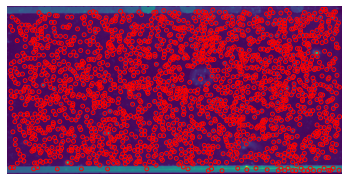

Matched clusters before polywarp:  141
Matched clusters after polywarp:  137
Out of  1939  smFRET peaks and  259  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  52


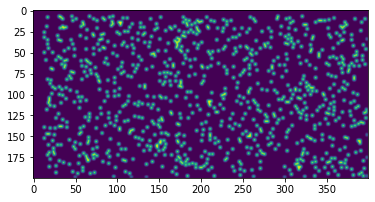

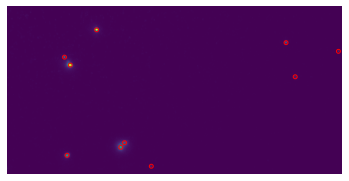

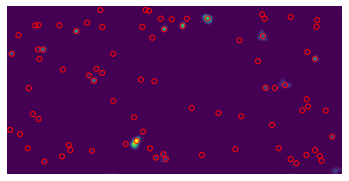

61.82737110288335 0.035722198926511385
2.93585358430225 0.06806186055274843
7.629337632235041 0.07441087860318522
157.315781062274 0.07536338176097118
93.4497205441965 0.020265093220598676
93.4497205441965 0.02113868846343083
1.3511496200237472 0.022223869708717394
72.14379066079726 0.02241680376571314
62.74798279049912 0.015229353701642124
62.74798279049912 0.015229353701642636
154.1293496926358 0.018209047456384395
154.1293496926358 0.018209047456384395
62.74798279049912 0.015229353701642119
62.74798279049912 0.015229353701642632
93.4497205441965 0.020265093220598544
139.92724840213276 0.021018558503150278
93.4497205441965 0.02113868846343048
97.69905289581332 0.02846704361800312
110.09662438682342 0.030056879046470433
31.708780478345282 0.03050746775952747
93.4497205441965 0.02113868846343083
97.69905289581332 0.028467043618001054
110.09662438682342 0.030056879046470433
110.09662438682342 0.04403305476898208
93.4497205441965 0.02113868846343083
153.58160480673618 0.04565180225768675

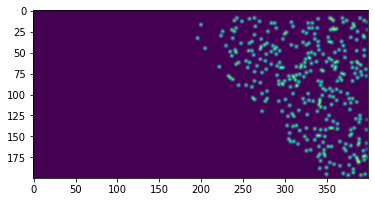

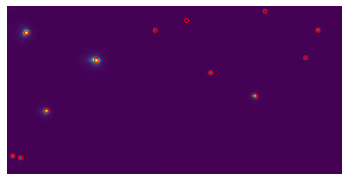

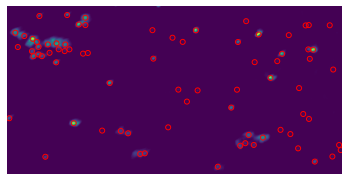

13.385846573727354 0.02152829137049085
2.05810404398764 0.022272373015305585
2.0684951514544743 0.02456632510090306
159.45666014640958 0.029890977838076427
1.6701912752367594 0.009481615355768564
1.6701912752367594 0.009481615355768823
1.6701912752367594 0.009481615355768823
13.385846573727354 0.02152829137049085
Pos254
 [[ 58.05351921  66.33080585]
 [121.99354567  91.03910567]
 [ 78.97299825 139.01040327]
 [267.16851199 120.38148801]
 [226.96503497  99.86946387]
 [ 45.06280455 179.13102328]
 [174.10422871  61.92167957]
 [314.09563178  84.9166823 ]
 [275.14868656  42.04259118]
 [ 64.35171968  46.87660739]
 [128.25046014  72.31730959]
 [ 82.6048445  118.24357337]
 [273.03141664 105.17774578]
 [232.89099525  83.98232783]
 [ 51.45005223 159.38203362]
 [182.19846234  44.94897779]
 [319.71182903  70.55990097]
 [282.69640568  27.82629859]]
Automatically matched beads:  9


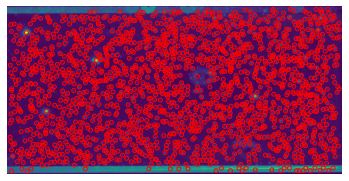

Matched clusters before polywarp:  17
Matched clusters after polywarp:  16
Out of  1929  smFRET peaks and  58  clusters
Percentage of matched smFRET peaks:  0
Percentage of matched clusters:  27


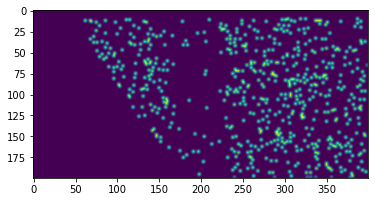

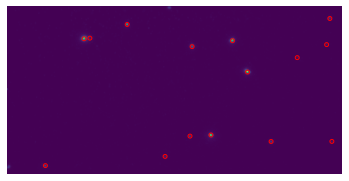

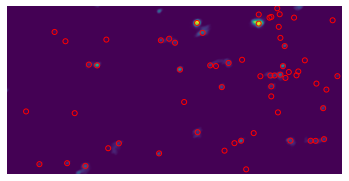

1.3705605114056485 0.005151747638170182
81.4703118775124 0.032724732667332154
47.90454398091158 0.059925732825537606
17.593764806753143 0.06998767056810476
Pos279
 [[255.9165      95.936     ]
 [242.03891051  69.95871163]
 [107.02705422  69.95368131]
 [205.95997288  75.00466805]
 [ 71.10825325 186.8281515 ]
 [278.95483936 159.96352799]
 [331.02435089  46.89584861]
 [180.96207124 175.09647098]
 [301.98341232  82.90995261]
 [328.95923117  70.87371424]
 [337.9091042  159.8867485 ]
 [107.02705422  69.95368131]
 [266.45529154  83.38471071]
 [252.80893416  54.66392303]
 [117.0414202   52.39756643]
 [215.85300222  59.97869019]
 [ 81.27383045 168.36722465]
 [287.82658296 147.00475117]
 [341.97380033  34.66872871]
 [190.80430046 160.33615053]
 [311.99337187  70.38362509]
 [338.93618467  58.55180521]
 [343.43995727 147.12214517]
 [122.3269093   51.88960277]]
Automatically matched beads:  12


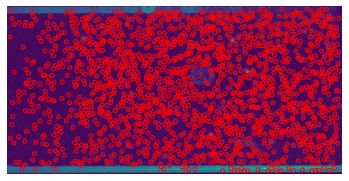

Matched clusters before polywarp:  90
Matched clusters after polywarp:  84
Out of  1725  smFRET peaks and  155  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  54


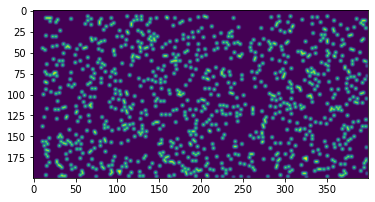

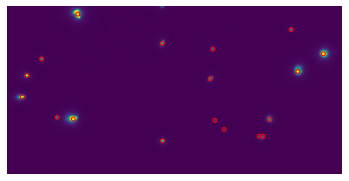

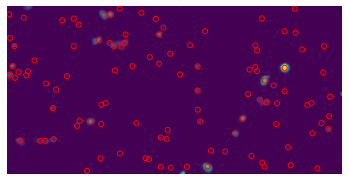

1.0176919691091955 0.04349273926262527
2.2062936914605187 0.0461819476647632
175.63141105811277 0.056280817279863594
63.58984602169556 0.058189478087751864
134.91697795022552 0.01689782604463386
163.65936620703195 0.019099018478700543
179.92098272154726 0.027766655341555986
179.92098272154726 0.027766655341555986
31.789640907879484 0.016839672748067306
1.5326958527015686 0.019502642169738987
1.5326958527015686 0.019502642169739487
1.5326958527015686 0.019502642169739487
Pos280
 [[ 57.8806489   98.88760139]
 [330.98824633  72.95469044]
 [ 98.98525827 136.97713291]
 [307.16430183  88.04742077]
 [ 54.02229249 121.09928854]
 [182.97807333 156.0790798 ]
 [ 70.99652605  82.83970223]
 [180.86808794  67.96002665]
 [ 86.02966102 136.22033898]
 [281.05515275 133.11323829]
 [227.01015655 100.06233932]
 [298.02581369  52.03872054]
 [227.01137441  71.08436019]
 [271.82364721 151.10514855]
 [271.82364721 151.10514855]
 [229.97955487 136.90036232]
 [ 64.83312182  85.91796167]
 [335.89946372  66.95478

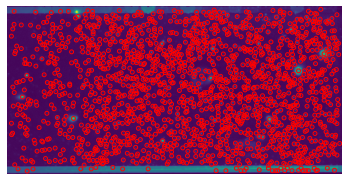

Matched clusters before polywarp:  122
Matched clusters after polywarp:  120
Out of  1726  smFRET peaks and  256  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  46


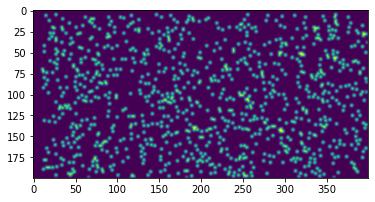

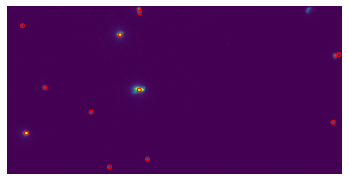

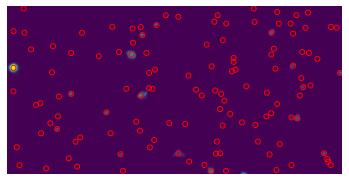

11.876929878137043 0.04061266213285248
2.6690936611548732 0.04333299818441725
2.6690936611548732 0.05023159753896272
2.6690936611548732 0.05349907717125784
0.309501730445068 0.010384677711125834
0.309501730445068 0.010384677711125834
0.12563951843029986 0.025133559902169672
2.555111247554082 0.02724833679579139
Pos281
 [[ 59.06372258 145.94487255]
 [148.07842709  56.9779613 ]
 [159.0022936  106.0633965 ]
 [160.94108513  33.93067227]
 [341.05917994  70.27516323]
 [ 54.14141414  47.        ]
 [339.09064112 132.16912307]
 [170.01622718 167.89790399]
 [135.01144414 176.03542234]
 [118.08656652 126.0846212 ]
 [160.94108513  33.93067227]
 [ 75.93983276 104.00785234]
 [341.05917994  70.27516323]
 [ 64.00900836 138.50923127]
 [149.97101998  49.00076353]
 [167.36770809  99.53527804]
 [167.34137101  25.6621362 ]
 [346.69344025  68.7699962 ]
 [ 60.69627248  40.33976536]
 [344.64529259 129.7380408 ]
 [174.68093897 162.71196218]
 [139.87125371 169.75414606]
 [123.32163248 119.50799346]
 [167.898169

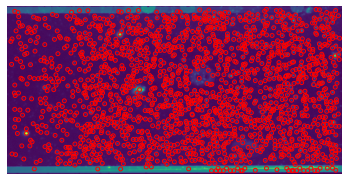

Matched clusters before polywarp:  139
Matched clusters after polywarp:  134
Out of  1753  smFRET peaks and  268  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  50


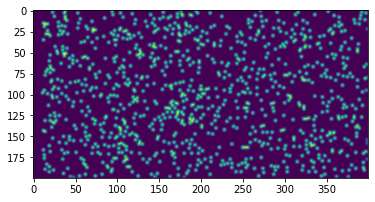

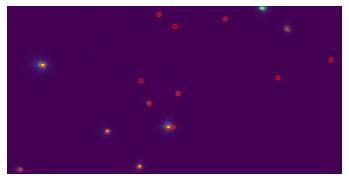

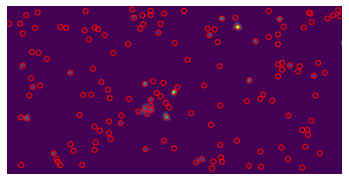

1.5208440817284163 0.0061541881255019115
1.4521642338146088 0.009465762668649886
1.4521642338146088 0.010573828611065868
1.4521642338146088 0.010860298793983111
Pos282
 [[ 74.9138336   78.90357275]
 [164.87662195 170.00637783]
 [189.97980749 131.89737806]
 [134.97576828 138.97329566]
 [ 55.01690751 175.01372832]
 [296.07091837  41.04081633]
 [170.96831169 110.92831169]
 [241.07738009  33.95826692]
 [180.11961176  30.92634884]
 [198.97706444 102.07437175]
 [164.08225951  91.96643692]
 [288.88491587  87.94441106]
 [189.97980749 131.89737806]
 [337.08782799  69.94460641]
 [ 79.21414055  76.37780496]
 [167.48158144 169.32040796]
 [193.92651534 133.50270048]
 [138.19959459 136.96581329]
 [ 58.54686731 171.86529138]
 [302.60097869  44.21043712]
 [176.61053229 111.90728614]
 [246.31715705  35.00784672]
 [185.82127234  30.59762858]
 [202.90278522 103.00668641]
 [169.01514821  91.0287169 ]
 [294.52679411  88.93371089]
 [198.59312323 133.51766164]
 [343.09275197  72.37335862]]
Automatically matc

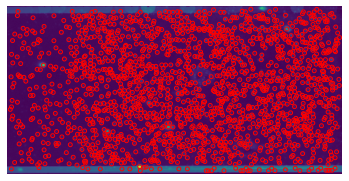

Matched clusters before polywarp:  148
Matched clusters after polywarp:  144
Out of  1729  smFRET peaks and  280  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  51


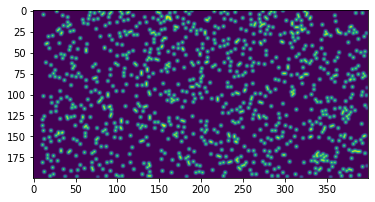

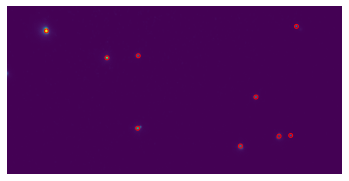

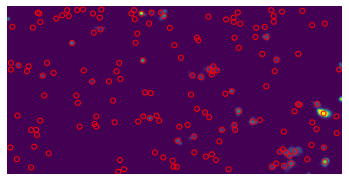

0.9475548678828122 0.02051757386948716
0.23626283011138025 0.042886056047576136
0.9475548678828122 0.046962928938134446
0.9475548678828122 0.050635317752638395
0.9475548678828122 0.02051757386948716
111.2763975688086 0.02409051180044866
111.2763975688086 0.02409051180044866
111.2763975688086 0.024090511800448914
0.9475548678828122 0.02051757386948716
73.58729451998373 0.03024494089544148
73.58729451998373 0.03024494089544168
2.3630004532598785 0.034386230873903106
73.58729451998373 0.03024494089544148
73.58729451998373 0.03024494089544168
93.30543391788828 0.03027503946449501
14.13921964009085 0.04013931723301471
73.58729451998373 0.030244940895441604
73.58729451998373 0.030244940895441805
143.14522521386488 0.03464234682379903
143.14522521386488 0.03464234682379903
73.58729451998373 0.030244940895441805
13.883131270004768 0.04176652243604412
13.883131270004768 0.04176652243604428
13.883131270004768 0.04176652243604428
13.883131270004768 0.04176652243604446
13.883131270004768 0.0417665

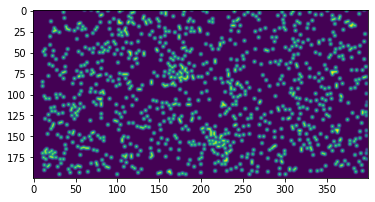

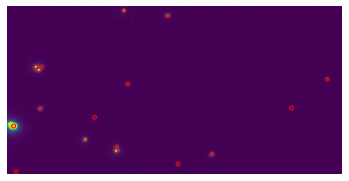

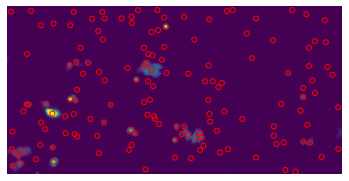

2.0046988578294966 0.018177505854195614
140.2883028150215 0.04206098456098913
140.88933711210336 0.04730103667472613
134.81801990672858 0.052939816942615715
Pos284
 [[ 53.48677717 127.51689141]
 [148.47031963  19.34246575]
 [146.99340622 147.11150526]
 [115.21632653 138.08938084]
 [ 74.14609629  69.82111256]
 [189.11133734  23.92594352]
 [229.93240366 150.93889717]
 [ 75.08669409 110.13971082]
 [335.18153741  79.08510638]
 [146.99340622 147.11150526]
 [153.88394919  86.97205543]
 [123.1039031  117.10524899]
 [199.88616695 159.02575377]
 [ 53.88871847 168.01090661]
 [ 74.14609629  69.82111256]
 [ 52.33041136 132.10097767]
 [153.63600424  26.85500783]
 [146.05689264 154.89637478]
 [117.93632353 144.58238474]
 [ 72.71078849  78.05059056]
 [193.63358555  31.80026748]
 [233.98534684 158.17693776]
 [ 76.70726234 116.32519499]
 [339.38388908  90.24808869]
 [146.58189517 151.38002361]
 [156.94128332  94.04895699]
 [126.30962114 124.2668589 ]
 [202.73217097 167.16454903]
 [ 54.35396672 173.6680

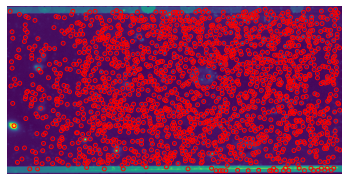

Matched clusters before polywarp:  136
Matched clusters after polywarp:  128
Out of  1749  smFRET peaks and  270  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  47


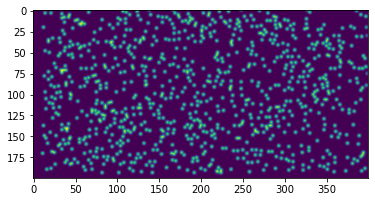

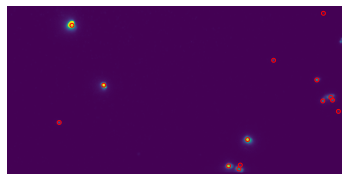

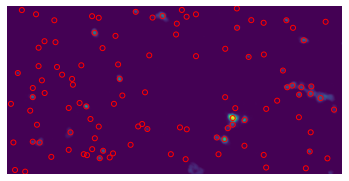

1.5938502785040072 0.011542278986423187
1.5435617775633643 0.01756444030920614
27.604197987662367 0.019629007084538085
1.5938502785040072 0.02366225971973263
Pos285
 [[103.94298589  30.99462825]
 [133.97158207  86.09850199]
 [268.97983251 132.89674686]
 [249.96538934 156.06875767]
 [328.9386814   76.14066311]
 [259.07839488 158.03343268]
 [334.01706783  96.11403893]
 [ 94.02356983 118.95509748]
 [340.11686535  94.09473613]
 [340.11686535  94.09473613]
 [287.95930423  59.84443715]
 [348.25995018 104.94442292]
 [333.04130758  16.07488856]
 [259.07839488 158.03343268]
 [105.97909775  40.09890441]
 [134.91991152  94.95386445]
 [266.30397429 145.1598842 ]
 [248.88989102 169.18607161]
 [329.8682108   90.849724  ]
 [258.27502802 172.05689548]
 [335.24728049 110.07191219]
 [ 94.02545795 128.95139443]
 [344.14254094 109.36620657]
 [342.64384362 106.86528808]
 [290.38272933  72.72728533]
 [349.50862071 119.69122759]
 [336.09599365  29.91563497]
 [259.55095475 168.49951139]]
Automatically matched

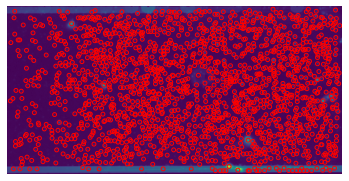

Matched clusters before polywarp:  89
Matched clusters after polywarp:  85
Out of  1769  smFRET peaks and  187  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  45


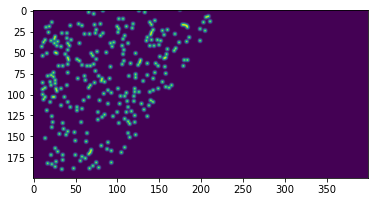

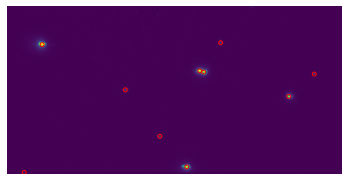

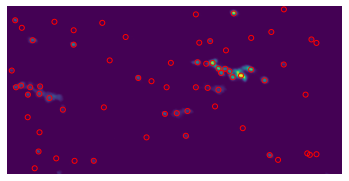

2.2586458347791214 0.051396571314576804
172.05257092339542 0.05163289053113917
32.85899716011086 0.06684374532985679
41.23951531576427 0.06773316664923303
79.8247241128485 0.040383097160568704
30.56177009150596 0.05114485357641609
30.56177009150596 0.05114485357641609
2.2586458347791214 0.051396571314576624
28.427670014606488 0.012521492372037478
133.21087880445742 0.02650885424077688
56.07723149154295 0.028833471087651396
56.07723149154295 0.028833471087651438
28.427670014606488 0.012521492372037452
56.07723149154295 0.028833471087651396
132.7575340110408 0.0377545523255183
132.7575340110408 0.0377545523255183
28.427670014606488 0.012521492372037478
127.43290603359137 0.025254088587588014
56.07723149154295 0.028833471087651396
132.7575340110408 0.0377545523255183
28.427670014606488 0.012521492372037478
56.07723149154295 0.028833471087651396
132.7575340110408 0.0377545523255183
151.61750120921113 0.04941086382819705
141.15431766423805 0.05778711454863825
159.53561222744347 0.0608669149

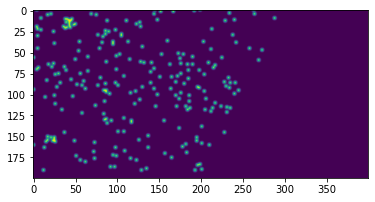

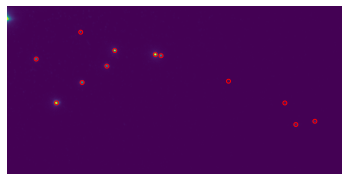

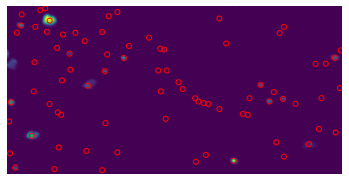

178.3588739374926 0.02788728959635884
167.01857876535323 0.039792021841361866
23.20738061840471 0.04161001447397974
141.39211863793577 0.04557500709595422
35.24317703244843 0.00472773895054051
35.24317703244843 0.00472773895054051
35.24317703244843 0.00472773895054051
35.24317703244843 0.00472773895054082
35.24317703244843 0.00472773895054051
35.24317703244843 0.00472773895054082
0.7056132439398235 0.01152015429898658
0.7056132439398235 0.01152015429898658
Pos313
 [[182.25675676  50.07297297]
 [144.97484277  46.79245283]
 [ 96.06527716  94.21203915]
 [116.05795207  76.94655047]
 [187.06241185  51.05535966]
 [138.94158976  61.20456853]
 [ 74.05839232  55.96132457]
 [113.09559214  30.09559214]
 [329.05917331 110.10159536]
 [312.9519118  113.05764365]
 [302.16398272  93.25469044]
 [182.22900243  67.12069989]
 [145.10178602  63.32894726]
 [ 91.61504375 111.05287167]
 [115.12303656  92.45644715]
 [187.43662118  68.18436747]
 [137.81294753  77.57314148]
 [ 73.21414118  70.87487377]
 [113.977

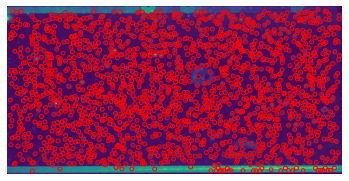

Not enough smFRET peaks (<4)


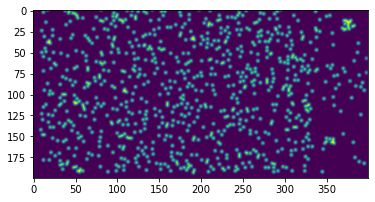

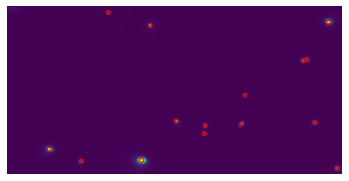

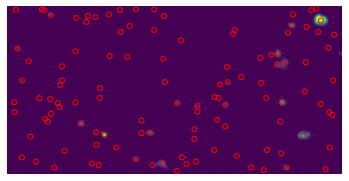

0.7602153064384977 0.0217800286779568
0.6765019188178483 0.024609347528027424
0.6765019188178483 0.0328513753392536
0.6765019188178483 0.03768713824033195
131.50728742141402 0.020318085666163367
150.3441126704492 0.024327022705414453
37.351397187396785 0.036918556966668625
37.351397187396785 0.036918556966668625
49.99495807946586 0.01747882960520897
116.47825134094235 0.018980029450141694
116.47825134094235 0.018980029450141694
116.47825134094235 0.018980029450141694
49.99495807946586 0.01747882960520897
116.47825134094235 0.018980029450141694
116.47825134094235 0.018980029450141694
84.44706634759358 0.024508902867162126
49.99495807946586 0.01747882960520893
116.47825134094235 0.018980029450141694
116.47825134094235 0.018980029450141694
15.69305557455319 0.028235622498922783
49.99495807946586 0.01747882960520893
15.69305557455319 0.028235622498922783
38.788688697440826 0.030231252077600097
132.32984615766003 0.03123915146954365
49.99495807946586 0.01747882960520893
15.69305557455319 0.

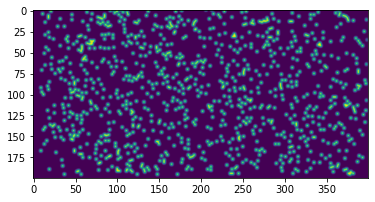

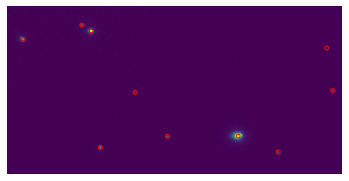

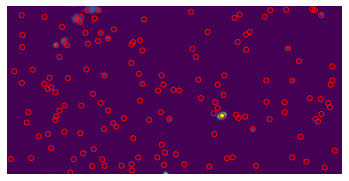

1.0632304186366968 0.0054964089995560485
0.9883920898330891 0.005794007484621328
1.0632304186366968 0.008215765323358187
0.9883920898330891 0.008447779435565118
Pos315
 [[119.99846326  37.87692093]
 [256.11206071 130.07923121]
 [129.89403292 143.00514403]
 [ 57.87235071  45.9188816 ]
 [111.17187068  31.19894999]
 [193.14019608 134.05921569]
 [292.96314026 146.05919898]
 [340.21480197  88.1274935 ]
 [160.97442186  91.99264191]
 [335.02822308  49.83924136]
 [123.60895999  45.4178404 ]
 [257.69548171 141.99894259]
 [131.58920558 151.87427845]
 [ 61.3187214   52.87701004]
 [115.14565161  39.94238349]
 [193.14589707 142.01176693]
 [294.40579025 156.58509234]
 [344.31716722 100.56817567]
 [163.61866165 101.68023335]
 [338.97380244  61.59677766]]
Automatically matched beads:  10


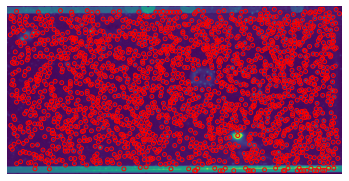

Matched clusters before polywarp:  156
Matched clusters after polywarp:  150
Out of  1926  smFRET peaks and  258  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  58


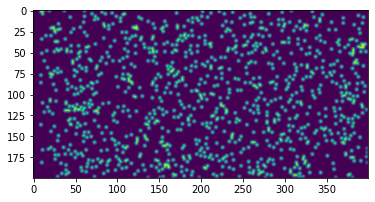

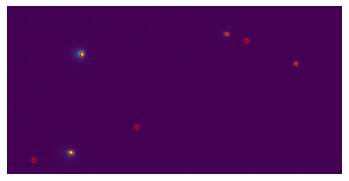

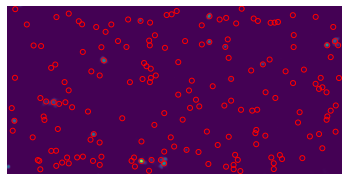

179.48884992235065 0.023986449721154383
1.2894567262136025 0.030190732706065003
178.91988704980474 0.052989453565758356
16.26154932304104 0.12520590507340001
179.48884992235065 0.023986449721154383
179.48884992235065 0.023986449721154476
1.2894567262136025 0.030190732706065
1.2894567262136025 0.030190732706065003
179.48884992235065 0.023986449721154383
179.48884992235065 0.023986449721154476
1.2894567262136025 0.030190732706065
1.2894567262136025 0.030190732706065003
147.22661802464768 0.028690643382465332
1.2894567262136025 0.030190732706065
1.2894567262136025 0.030190732706065003
173.77531230883267 0.03164140893727753
147.22661802464768 0.028690643382465332
1.2894567262136025 0.030190732706065
1.2894567262136025 0.030190732706065003
179.73381434035545 0.03484457572446855
179.73381434035545 0.03484457572446855
45.553392627292524 0.040638479819249715
9.083342133545415 0.041238918234491335
35.21112847450002 0.044959921240244304
45.553392627292524 0.040638479819249715
9.083342133545415 0

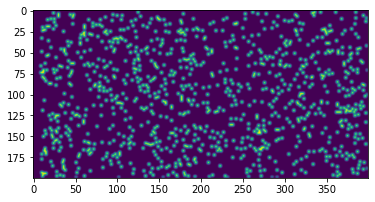

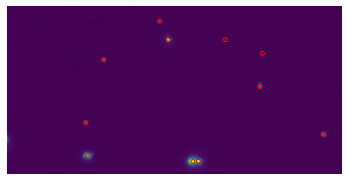

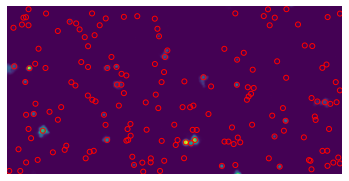

1.258684444681995 0.012068299885888402
1.258684444681995 0.03857908682554484
1.258684444681995 0.03980529961584894
1.474261656276242 0.04727244117585732
Pos317
 [[190.8728783   52.13344168]
 [212.95523109 161.92635183]
 [219.02417064 162.94108405]
 [118.93976241 159.03832547]
 [273.91596476  93.10562494]
 [130.08188839  71.76759435]
 [115.11131757 128.94662162]
 [332.13120329 136.11892634]
 [180.89398281  35.20594556]
 [274.19618913  63.16549047]
 [194.15453712  53.83322031]
 [216.19721154 165.1119806 ]
 [221.30228522 164.82645702]
 [120.17276173 158.99928816]
 [277.80416908  96.67621832]
 [134.93598151  71.65034409]
 [118.43249915 129.10450812]
 [335.7198749  140.60602768]
 [186.31617225  36.54266698]
 [280.19214119  66.28708495]]
Automatically matched beads:  10


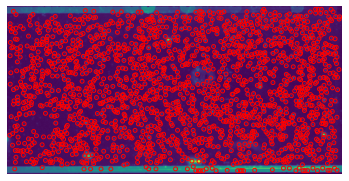

Matched clusters before polywarp:  134
Matched clusters after polywarp:  127
Out of  1839  smFRET peaks and  259  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  49


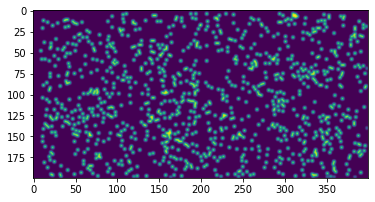

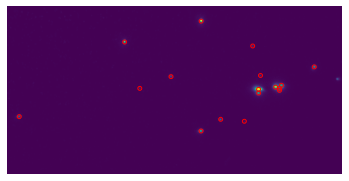

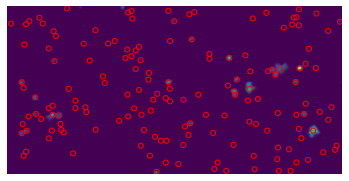

165.8641247116221 0.044424023724982116
165.81978758257276 0.05368463580888499
4.159090544515285 0.06904687637538039
160.04864903232362 0.0694103857794961
1.2234185471411132 0.007309698658411844
22.5271770693525 0.01988289633872962
22.5271770693525 0.01988289633872962
90.50214058330948 0.020111875966972465
Pos318
 [[219.96872921  38.93546241]
 [270.9277595  101.03221823]
 [147.93589744  59.00549451]
 [289.0948604   98.17395339]
 [218.0222597  139.11180438]
 [320.06459854  80.97871046]
 [289.0948604   98.17395339]
 [236.96676737 129.02719033]
 [ 53.96378584 129.02051909]
 [192.05292458  90.00022878]
 [289.0948604   98.17395339]
 [273.88617153  86.86588527]
 [264.94684953  61.03266138]
 [289.0948604   98.17395339]
 [259.1025641  129.83333333]
 [224.19386418  36.65403058]
 [276.52925452  99.2377929 ]
 [154.12807557  55.54433755]
 [292.13831036  97.26160837]
 [223.77828639 137.18583168]
 [327.5679081   78.89476936]
 [297.48695047  95.59348812]
 [241.7725918  126.5619159 ]
 [ 57.49096758 123

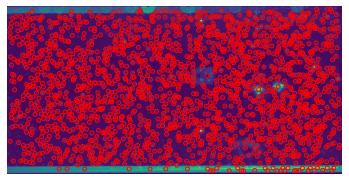

Matched clusters before polywarp:  149
Matched clusters after polywarp:  145
Out of  1954  smFRET peaks and  264  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  54


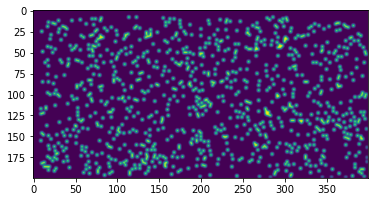

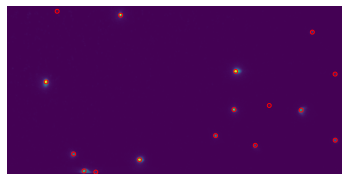

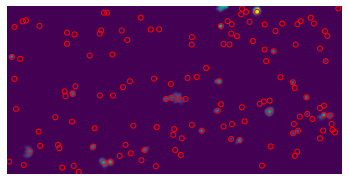

1.6393311422114099 0.030422816074676874
1.6818712566913487 0.07042259027140534
3.064698052253708 0.07685703057552802
1.1026354669588125 0.08000548084924819
0.9277004761997636 0.02068750998680475
1.6393311422114099 0.027164496814770525
64.93740585998593 0.029031053325544807
1.6393311422114099 0.030422816074676697
50.52067588036739 0.016518954142967335
0.9277004761997636 0.02068750998680475
132.6613122818989 0.024061710637854575
132.6613122818989 0.024061710637854575
121.48534526892963 0.013635666752842909
175.46603225205135 0.013798928185666887
50.52067588036739 0.01651895414296755
85.77768407790727 0.018045481876469167
121.48534526892963 0.013635666752842909
175.46603225205135 0.013798928185666887
85.77768407790727 0.018045481876470582
85.77768407790727 0.018045481876471182
121.48534526892963 0.013635666752842909
175.46603225205135 0.013798928185666887
132.6613122818989 0.024061710637854575
69.2278291925376 0.025627737171494892
121.48534526892963 0.013635666752842909
132.6613122818989 

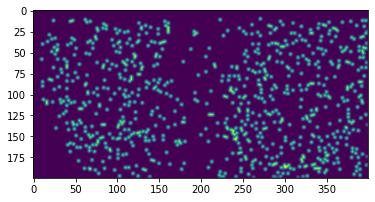

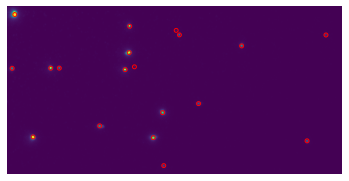

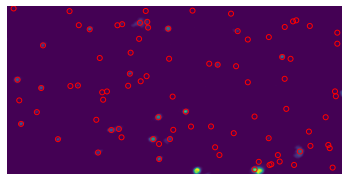

170.9993120533017 0.020634632512828648
177.59095806638214 0.04795184574963842
168.9719542358893 0.05319704744162337
50.394234692699776 0.057157927755013854
155.625172372412 0.01415151363450379
1.046626822384489 0.014357743727677822
1.046626822384489 0.014357743727677853
89.28515151415064 0.01594605446389137
Pos320
 [[ 42.28636701  46.08669337]
 [ 60.10300587 158.12170088]
 [146.03086164  79.88877382]
 [ 75.01685393  94.63483146]
 [144.          94.33826248]
 [146.96086957  54.80108696]
 [173.94696067 158.01859493]
 [180.06796344 131.91131943]
 [250.96624102  69.12705507]
 [ 40.12810968  97.01893325]
 [123.94113924 147.18841421]
 [ 83.95961887  93.97323049]
 [192.90782609  62.05565217]
 [311.89377934 156.95246479]
 [212.94845662 125.19985388]
 [181.03401644 181.88827629]
 [327.99642723  59.92760436]
 [192.90782609  62.05565217]
 [ 53.69899545  30.07445446]
 [ 70.05956776 142.10099831]
 [158.26888106  65.25181233]
 [ 86.45142423  79.23340866]
 [154.56837401  80.76025619]
 [158.84537703  

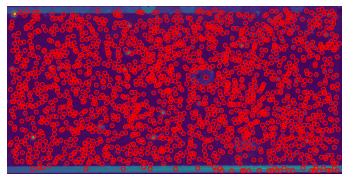

Matched clusters before polywarp:  101
Matched clusters after polywarp:  92
Out of  1866  smFRET peaks and  185  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  49


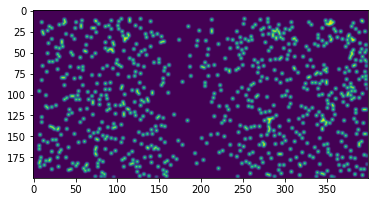

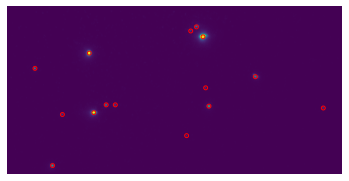

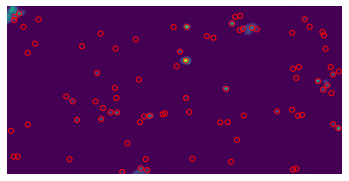

31.390089567824532 0.03235026970219922
175.2416145777033 0.04538774630917346
31.390089567824532 0.06346438995701739
179.54173709412592 0.0657630632831427
0.6141956591103147 0.00962965617529634
0.6141956591103147 0.00962965617529634
1.3981044607336566 0.01527269243725642
1.3981044607336566 0.01527269243725642
Pos345
 [[107.00178635  79.10968203]
 [213.03490603  64.26590297]
 [111.97492163 134.0692505 ]
 [216.93063584 125.67052023]
 [ 73.97508897 182.19039146]
 [122.92486772 126.070194  ]
 [261.04946719  98.01453409]
 [205.98414582  53.61555744]
 [130.94933211 126.23836942]
 [ 82.93347874 135.21192294]
 [321.97432639 125.01398068]
 [213.13194444 108.91743827]
 [121.74408165  65.58875082]
 [225.87708594  51.03940479]
 [125.71933037 120.05843522]
 [231.09589118 114.4882842 ]
 [ 87.84283759 168.35329611]
 [137.0850526  112.96009502]
 [273.60730638  87.65476214]
 [219.89856054  41.94296988]
 [145.41881305 113.01020232]
 [ 96.96514513 121.67381862]
 [335.6914323  116.53381466]
 [228.12232318 

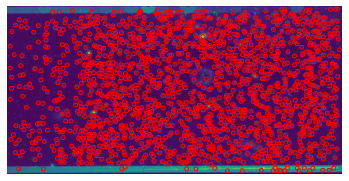

Matched clusters before polywarp:  94
Matched clusters after polywarp:  90
Out of  1699  smFRET peaks and  216  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  41


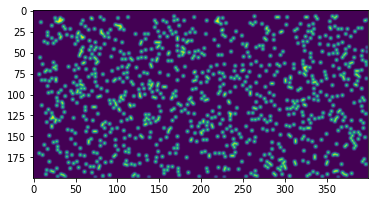

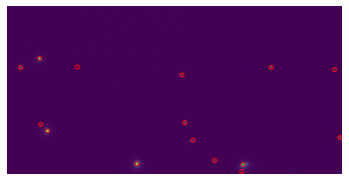

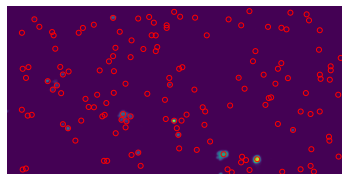

1.3263223994374407 0.0024383908589867805
1.0548477010199424 0.00827939519525882
1.3263223994374407 0.009513438801658811
1.3263223994374407 0.009767591955551923
Pos346
 [[ 72.1177723  145.05569251]
 [ 65.98600884  80.87579774]
 [156.08637804 174.15219993]
 [ 47.86804433  88.77557146]
 [276.02479893  84.7419571 ]
 [340.97681855 147.07713829]
 [225.99072848 170.91655629]
 [198.97007308 136.06781529]
 [193.91108404  93.07978076]
 [203.94629671 152.95692549]
 [334.85533869  85.21239954]
 [ 66.05771768 140.22988127]
 [ 83.31897451 136.66589483]
 [ 76.33654027  70.24714883]
 [165.04746527 166.885553  ]
 [ 58.85350853  78.50032535]
 [288.15263555  79.26188728]
 [350.66275158 143.59941403]
 [236.13939356 164.16436925]
 [208.96871287 129.42859536]
 [206.56501581  85.76594445]
 [216.59851281 145.61451832]
 [346.03512446  81.4024163 ]
 [ 77.19916838 130.77247546]]
Automatically matched beads:  12


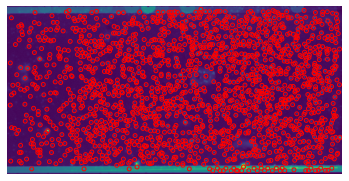

Matched clusters before polywarp:  167
Matched clusters after polywarp:  162
Out of  1705  smFRET peaks and  290  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  55


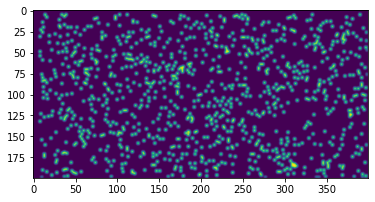

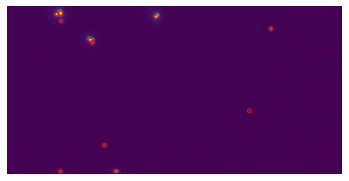

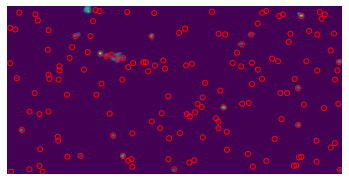

1.0663471828974878 0.026132906234793203
2.509515228496362 0.03677930637726591
2.509515228496362 0.051199474091091934
1.0663471828974878 0.05240910309620272
1.0635587425315154 0.009724622580329904
134.159026134978 0.017821179873403755
134.159026134978 0.017821179873403755
1.0635587425315154 0.019139117980286235
Pos347
 [[ 81.0383592   34.98226164]
 [172.08694344  35.03128761]
 [110.94154148  55.92510342]
 [ 81.0383592   34.98226164]
 [137.94378014 178.02719383]
 [279.85164666  44.74946137]
 [126.0342483  153.84966004]
 [ 87.10102157 177.946084  ]
 [258.03740401 120.08422096]
 [ 95.6810179   29.05166946]
 [183.53698145  32.38677998]
 [122.94300309  53.6816302 ]
 [ 91.98337364  30.17142175]
 [145.9792853  173.61948853]
 [288.15901193  44.0145836 ]
 [135.26331535 149.94443057]
 [ 95.0176556  173.70700359]
 [268.03885851 118.87994957]]
Automatically matched beads:  9


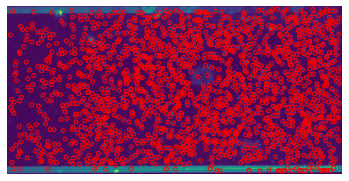

Matched clusters before polywarp:  157
Matched clusters after polywarp:  146
Out of  1709  smFRET peaks and  279  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  52


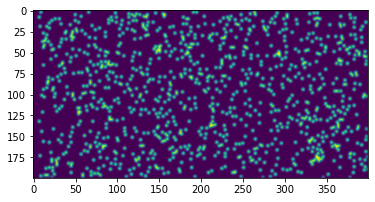

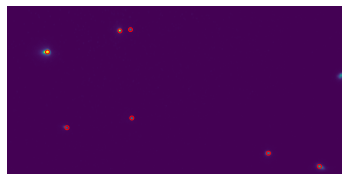

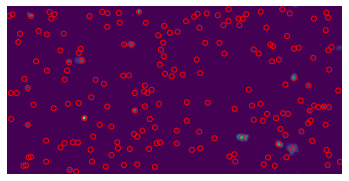

1.2631852574164577 0.027238024466759603
172.66509301856956 0.05673714552154208
0.047051603152936265 0.08061477073515097
154.098378295827 0.08738477648314244
92.308806580038 0.046961299022982926
92.308806580038 0.046961299022982926
92.308806580038 0.04696129902298312
45.81549213602907 0.05612824130381808
114.03982649957447 0.047718571601708955
114.03982649957447 0.047718571601709156
114.03982649957447 0.04865715522436394
114.03982649957447 0.048657155224364174
94.43520097684923 0.04713605743057787
114.03982649957447 0.048657155224364174
146.50733960929372 0.0504100943997834
160.3223608325856 0.05328861228433131
79.13089704164153 0.026305280008883956
89.55211363339718 0.03889870907640042
114.03982649957447 0.048657155224363306
176.86513626058573 0.04968285457195117
43.08643347666247 0.02144724503888988
157.73679287730897 0.04543184243372003
114.03982649957447 0.048657155224363306
1.5214075579378799 0.051267441436609766
89.55211363339718 0.03889870907640042
94.43520097684923 0.04713605743

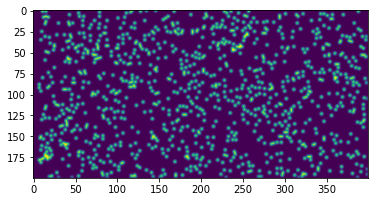

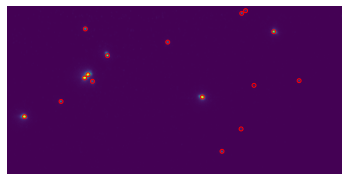

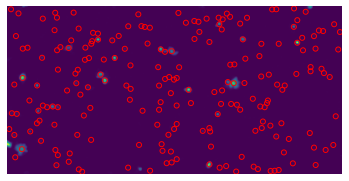

1.6897013957874156 0.03388923114600812
20.812820753430714 0.0416285674165774
66.86123184430147 0.04748885716390196
160.47211190255425 0.05328923037302206
1.5743296993014448 0.007008209458505725
18.67390213283464 0.01558156927620939
18.67390213283464 0.01558156927620939
1.5743296993014448 0.016851833497084003
Pos349
 [[ 53.92278134 119.08563586]
 [216.20124334  99.16708111]
 [110.9659271   80.93827258]
 [110.9659271   80.93827258]
 [127.99049599  61.0952381 ]
 [281.03146315  38.92761276]
 [108.07480469  39.10419922]
 [ 86.96202532 104.84810127]
 [233.12796834 148.21899736]
 [183.00657436  50.90058771]
 [116.23090758  87.90207076]
 [302.99016393  83.21639344]
 [252.98002057  20.83663875]
 [251.05145458 128.18998615]
 [263.12274025  89.9246432 ]
 [ 62.28006068 123.46150261]
 [225.09746145 106.12668946]
 [117.4456994   88.32737428]
 [120.49236957  85.3700452 ]
 [138.45460198  67.9749151 ]
 [290.60141945  46.57931671]
 [118.24513897  43.45817887]
 [ 95.77408881 109.73597498]
 [242.88921552 

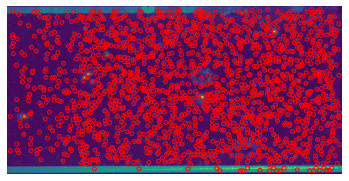

Matched clusters before polywarp:  143
Matched clusters after polywarp:  142
Out of  1682  smFRET peaks and  268  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  52


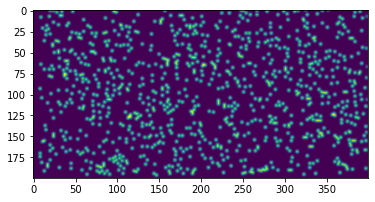

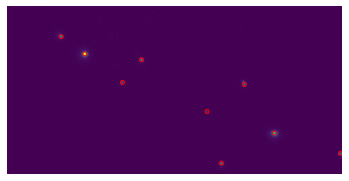

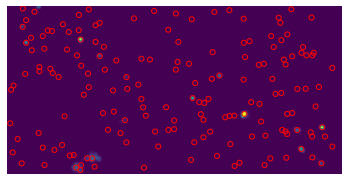

0.18482123288278687 0.011602891326529587
0.09543750019220619 0.01887568981487559
0.18482123288278687 0.02183786488965862
0.18482123288278687 0.022421691564180824
Pos350
 [[110.03921137  58.90690552]
 [282.92743151 127.96486527]
 [ 87.18632873  39.09580278]
 [233.98839458 155.87234043]
 [159.84774575  62.09164819]
 [345.92688607 147.20261988]
 [252.96681441  82.11535402]
 [142.00768974  83.95352725]
 [220.99050141 109.02354499]
 [117.606126    66.26043846]
 [290.81323989 139.25894768]
 [ 96.12336816  50.4757208 ]
 [242.27508871 166.64736176]
 [169.58628787  71.8202661 ]
 [351.25137035 158.04109614]
 [263.49793669  94.73005526]
 [152.10544532  92.57667149]
 [229.33495344 119.36167346]]
Automatically matched beads:  9


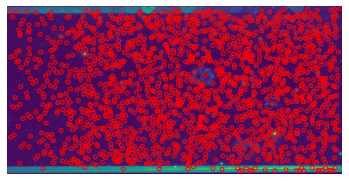

Matched clusters before polywarp:  143
Matched clusters after polywarp:  139
Out of  1740  smFRET peaks and  272  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  51


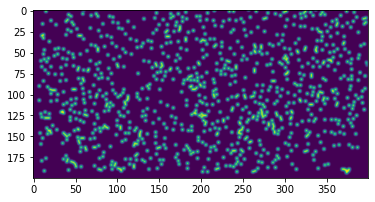

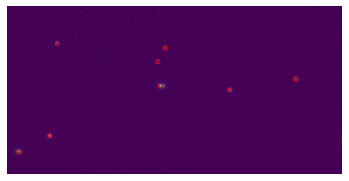

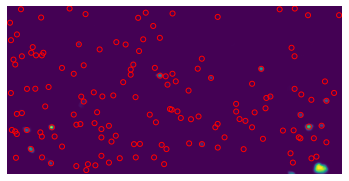

1.1519686578454496 0.008800674353623162
167.07986365034486 0.0394197894649983
171.56741783626464 0.04585102130872115
164.15898411990656 0.056987494105006295
Pos351
 [[ 78.9811828  128.72849462]
 [182.01283019  82.24539913]
 [ 52.9222612  143.9611306 ]
 [ 85.10304054  44.83868243]
 [243.01611553  84.95039766]
 [302.96487521  74.0785686 ]
 [ 85.50039972 140.96929301]
 [186.86657201  95.74533304]
 [ 56.8988648  155.2282983 ]
 [ 92.45890604  56.593991  ]
 [250.32372252  99.58641226]
 [310.68903074  89.76953763]]
Automatically matched beads:  6


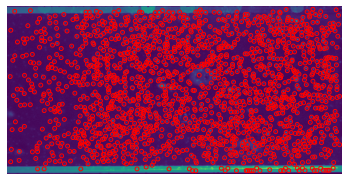

Matched clusters before polywarp:  127
Matched clusters after polywarp:  122
Out of  1673  smFRET peaks and  237  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  51


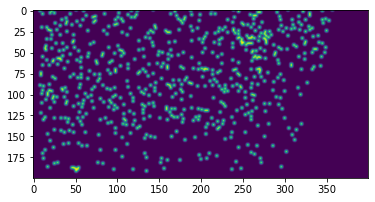

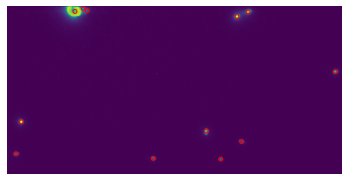

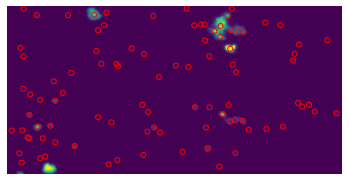

0.5664081926591816 0.016795829782731614
85.41633308528843 0.029605499582221865
83.03474589886181 0.034336367702943606
172.14523888502703 0.04005362733597809
Pos352
 [[ 56.95096474 112.28423073]
 [262.90455551  10.95762937]
 [223.96866816 119.91038007]
 [103.46680549   9.49982759]
 [340.94242715  64.12142171]
 [236.95543175 144.24791086]
 [174.99739896 144.09543818]
 [ 51.12031773 142.04576366]
 [256.95179831 128.21792301]
 [117.97667638   6.98250729]
 [ 59.40025843 128.21572456]
 [267.26141634  28.4905839 ]
 [228.61073553 137.18973271]
 [108.74652007  27.39140425]
 [346.68824174  83.35553821]
 [241.71524687 162.90651767]
 [180.04778032 162.08385502]
 [ 54.39410263 157.54404587]
 [260.89185719 146.92853065]
 [119.99596834  26.74520854]]
Automatically matched beads:  10


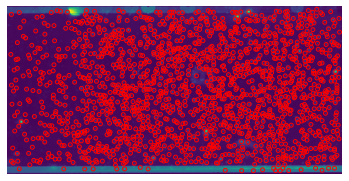

Matched clusters before polywarp:  91
Matched clusters after polywarp:  93
Out of  1656  smFRET peaks and  139  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  66


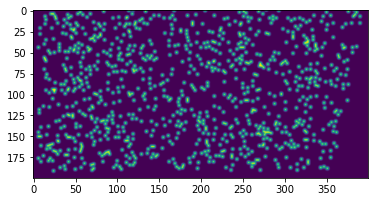

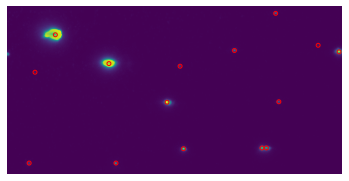

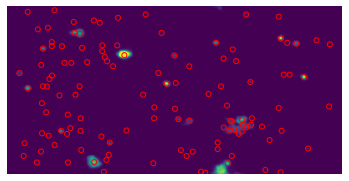

0.9104657839797858 0.02365821254407641
0.39476780602677675 0.02371034076308308
0.39476780602677675 0.029844058684129957
0.9104657839797858 0.03155113495725018
66.76923378478618 0.017876087711952548
0.9104657839797858 0.02365821254407641
0.9104657839797858 0.02365821254407641
0.39476780602677675 0.023710340763083065
0.3038814441704495 0.008874321192610264
0.3038814441704495 0.008874321192610467
0.3038814441704495 0.008874321192610467
0.3038814441704495 0.008874321192610467
Pos379
 [[ 86.05681436  31.94562886]
 [139.4892396   57.71828241]
 [189.99375976  91.94608123]
 [344.9314345   44.08727697]
 [204.02233144 134.21846107]
 [142.02090592 147.7630662 ]
 [280.06191346 135.10256451]
 [248.99578821  43.03580024]
 [285.05122494   9.18429844]
 [290.0235371   89.86106571]
 [ 63.93598897 148.09321759]
 [199.09965157  58.13797909]
 [ 67.8960739   66.86143187]
 [326.25097561  37.92445122]
 [ 90.76641411  48.7026941 ]
 [139.70845222  75.23350121]
 [192.74692395 110.75433109]
 [350.27738616  65.202

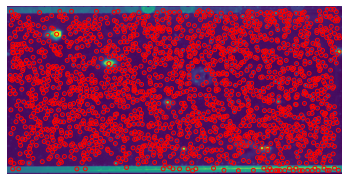

Matched clusters before polywarp:  126
Matched clusters after polywarp:  124
Out of  1869  smFRET peaks and  210  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  59


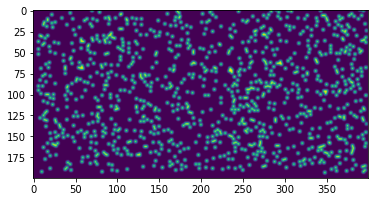

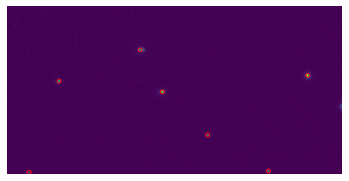

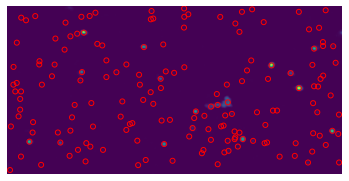

0.6313883211907301 0.010872336015660655
179.10415327286375 0.08130853873006862
41.484267948173006 0.08255542815227043
153.5232469544052 0.08917745984579657
Pos380
 [[315.23349379  69.9522055 ]
 [182.91019308  85.99416255]
 [ 88.8873942   77.98428053]
 [162.90467817  48.14560413]
 [224.88542621 124.99289643]
 [281.08775967 158.02051774]
 [ 62.99495549 162.12789318]
 [321.50112843  86.67476271]
 [188.56233446 101.2053376 ]
 [ 94.10240631  91.25007629]
 [168.4055574   62.88035075]
 [229.79675403 140.76957849]
 [285.31390042 173.9969474 ]
 [ 66.38489949 174.48934458]]
Automatically matched beads:  7


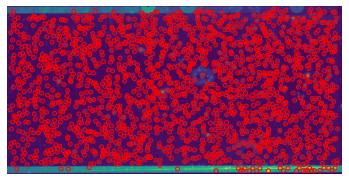

Matched clusters before polywarp:  151
Matched clusters after polywarp:  150
Out of  1847  smFRET peaks and  258  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  58


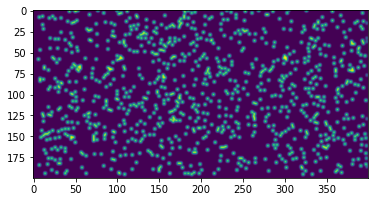

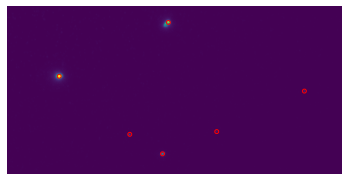

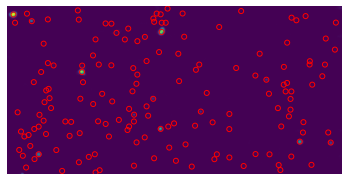

1.1693806005286913 0.01782336646644619
1.1693806005286913 0.02506942910822095
1.1693806005286913 0.030597206898375192
2.1496191792100148 0.03250271117723729
Pos381
 [[ 88.9143638   77.9587581 ]
 [184.05124296  30.00232019]
 [182.8357103  145.87164369]
 [151.10021231 128.87515924]
 [309.13884857  87.10014514]
 [230.826417   125.13663968]
 [ 94.20709913  86.67522761]
 [194.22378151  37.75788705]
 [188.44847173 157.96411794]
 [158.54898412 140.01821238]
 [318.43141981 101.01070043]
 [238.12188775 137.80350592]]
Automatically matched beads:  6


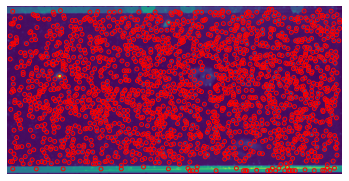

Matched clusters before polywarp:  144
Matched clusters after polywarp:  146
Out of  1832  smFRET peaks and  272  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  53


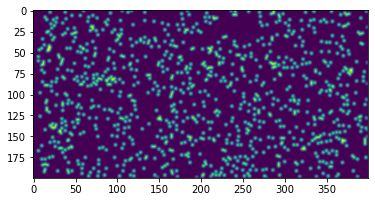

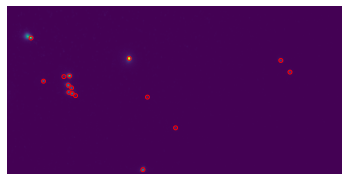

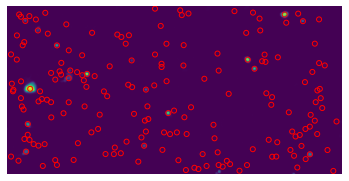

117.65281236669519 0.04688888835892925
117.65281236669519 0.048678885257310664
115.05386738215832 0.06363657439813657
121.86800253352226 0.0790880016148739
86.09703926869817 0.019828357639174517
96.9271574284085 0.02191912833256556
101.3963924375856 0.02242483575730391
101.3963924375856 0.02242483575730391
31.378737702041686 0.013599725896664
68.28507255222439 0.02107007454632787
96.9271574284085 0.02191912833256556
96.9271574284085 0.02191912833256556
113.4032519916088 0.01826087163647092
100.07874787425827 0.023311858978693922
105.60034221991714 0.02355384291417458
105.60034221991714 0.02355384291417458
106.02653876965634 0.017763379858177757
106.02653876965634 0.017763379858177757
106.02653876965634 0.017763379858177757
154.46479717310683 0.02290526107484093
154.46479717310683 0.02290526107484093
154.46479717310683 0.02290526107484093
105.60034221991714 0.02355384291417458
105.60034221991714 0.023553842914174686
167.292606308142 0.01527028970450994
100.07874787425827 0.0241827975494

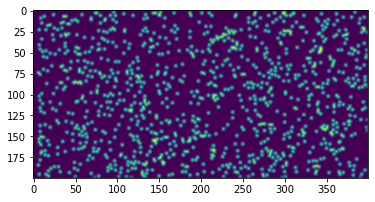

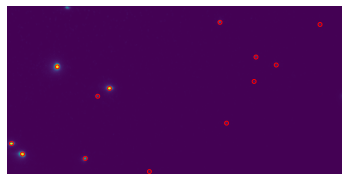

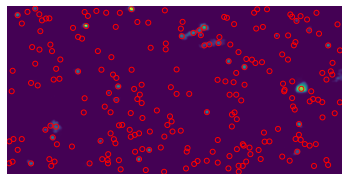

156.2875473436517 0.028662491416343687
56.77798341563399 0.06738662518063172
21.29319175096538 0.06740058590643165
13.700144093494488 0.0695484735316424
111.89499921250093 0.02016307733599424
66.86100910796218 0.03885961908443163
166.94187936850506 0.03941856341176821
123.76173569932392 0.042211464381197945
178.16255783747008 0.01932427289617811
131.93924303127042 0.02056990759161879
131.93924303127042 0.02056990759161879
131.93924303127042 0.02056990759161879
22.53104482022692 0.002607207717053043
55.26760810307165 0.012723571473319999
55.26760810307165 0.012723571473319999
178.16255783747008 0.01932427289617811
55.26760810307165 0.012723571473320398
55.26760810307165 0.012723571473320398
131.93924303127042 0.02056990759161879
131.93924303127042 0.02056990759161879
131.93924303127042 0.02056990759161879
131.93924303127042 0.02056990759161879
3.680031877207736 0.021341201573884413
87.28783586104062 0.024989212095467173
131.93924303127042 0.02056990759161879
131.93924303127042 0.0205699

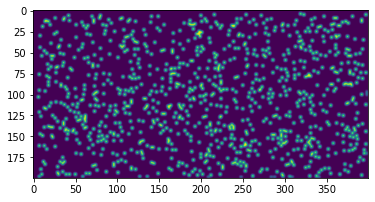

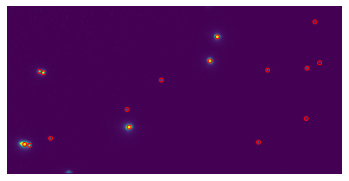

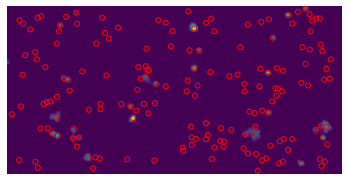

1.5261454903879346 0.018347530261067814
2.3594682749329805 0.028841149331229044
2.3594682749329805 0.03610448629926882
1.5261454903879346 0.03896301258578458
Pos384
 [[150.03476869 133.07496764]
 [229.03649607  51.9424881 ]
 [223.03166623  73.02223374]
 [ 54.05025657 151.26120911]
 [ 71.92027359  86.92187667]
 [ 67.03002018  85.11125126]
 [ 59.89137127 153.95980297]
 [ 78.8785265  146.06864331]
 [274.74884259  80.83564815]
 [267.04306969 146.99060298]
 [311.08507844  78.87748997]
 [177.04178696  91.91885732]
 [146.95884437 119.03570455]
 [311.91599887 126.30156705]
 [321.56410256  73.38974359]
 [317.09987232  37.04241736]
 [157.9793569  133.41076484]
 [239.00828813  51.15192379]
 [232.33035293  73.15277582]
 [ 62.39719317 148.90991203]
 [ 79.80080121  83.41636536]
 [ 76.27228218  82.23546567]
 [ 66.92513678 149.79416025]
 [ 86.11471883 143.37251753]
 [284.94289274  81.68247552]
 [276.32480211 147.57275743]
 [320.90925837  80.07880081]
 [187.60281385  90.51731574]
 [156.21342603 117.285

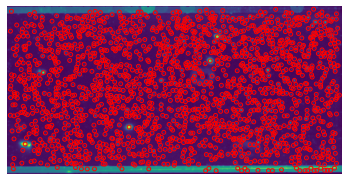

Matched clusters before polywarp:  144
Matched clusters after polywarp:  140
Out of  1792  smFRET peaks and  281  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  49


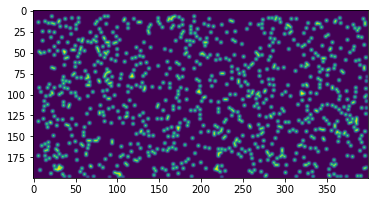

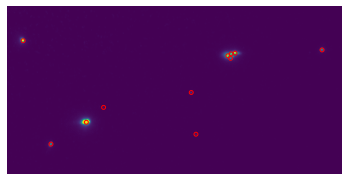

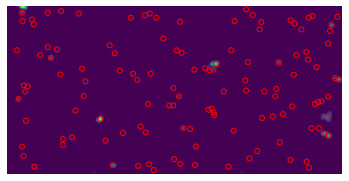

170.42915605456062 0.030196226997608603
1.4966247018578493 0.03466176002848706
170.42915605456062 0.04244371450334826
170.42915605456062 0.04490940340612195
170.42915605456062 0.030196226997608603
1.4966247018578493 0.03466176002848706
114.12733953310202 0.036237365644528216
98.70582489648758 0.038157743998722606
154.82205318993618 0.023000365489285808
73.08072999987833 0.029327717543293667
73.08072999987833 0.029327717543293667
73.08072999987833 0.02932771754329371
73.08072999987833 0.029327717543293667
73.08072999987833 0.029327717543293667
73.08072999987833 0.029327717543293667
73.08072999987833 0.02932771754329371
94.19111398646649 0.02650742847063714
75.70076738608736 0.031448549537732955
75.70076738608736 0.031448549537732955
75.70076738608736 0.031448549537732955
73.08072999987833 0.029327717543293667
75.70076738608736 0.031448549537732955
75.70076738608736 0.031448549537732955
95.48545785122224 0.04211523676983836
55.11017154438642 0.05104487105321429
55.11017154438642 0.051044

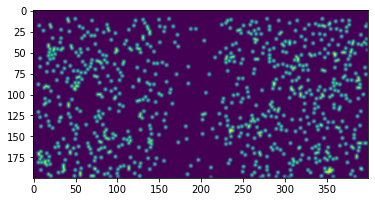

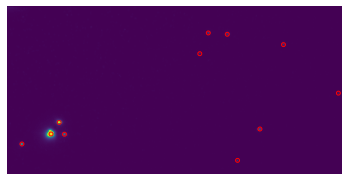

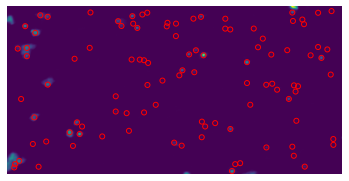

0.7426040206100705 0.013448193713433053
142.86328696562734 0.045148768317269904
128.43578880711308 0.04602795237971036
31.97595810419764 0.048615347089060006
Pos386
 [[ 74.06457192 149.93046988]
 [ 82.94875922 138.03849765]
 [ 46.11370262 160.94460641]
 [ 86.05573946 151.9613492 ]
 [266.10678871 145.96236969]
 [216.87260838  56.88447566]
 [234.06969755  57.93279621]
 [285.99591551  66.10292916]
 [208.87573835  75.84073507]
 [335.99097173 110.0394393 ]
 [ 86.53374952 139.4740305 ]
 [ 94.01540193 128.89335045]
 [ 59.85271449 148.52201175]
 [ 98.82042285 139.71973426]
 [277.63620646 135.55734634]
 [230.69923121  47.50738142]
 [248.06369394  48.78213184]
 [299.45091345  58.43179813]
 [222.86229319  66.45605459]
 [349.54640795 102.97383979]]
Automatically matched beads:  10


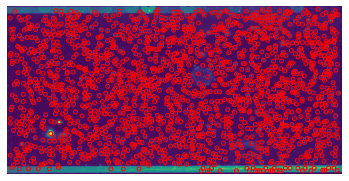

Matched clusters before polywarp:  101
Matched clusters after polywarp:  98
Out of  1812  smFRET peaks and  201  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  48


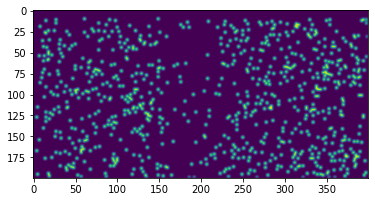

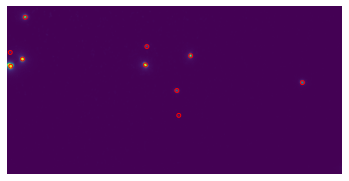

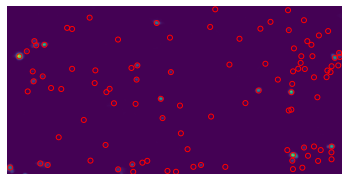

151.94117636843728 0.04861779698975097
7.601674195852533 0.05955657925105345
19.232736932954772 0.06976990405331025
163.7410190228976 0.07043444358502923
0.827260841795219 0.004781913576019076
0.827260841795219 0.004781913576019076
0.827260841795219 0.0080870094991208
0.827260841795219 0.00808700949912081
Pos411
 [[ 41.92023434  83.12257774]
 [154.04917112  86.9519528 ]
 [ 31.05577787  89.00881993]
 [195.02191963  77.99634673]
 [ 44.02474301  45.33756146]
 [299.94669691 100.01502694]
 [183.02407353 109.9290925 ]
 [154.99663583  69.99814971]
 [ 29.99558174  77.15905744]
 [185.0628858  132.92901235]
 [ 60.66901378  70.81252386]
 [173.08785636  76.56963298]
 [ 49.85738553  77.31993694]
 [214.51777724  68.34938032]
 [ 63.26717945  32.56687919]
 [316.639182    93.21579306]
 [201.77941428 100.05931975]
 [174.44599151  59.81427147]
 [ 49.42480566  64.70486896]
 [203.44768418 122.84053461]]
Automatically matched beads:  10


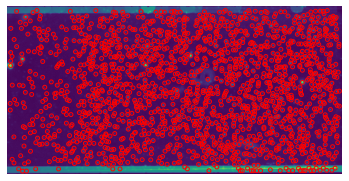

Matched clusters before polywarp:  92
Matched clusters after polywarp:  92
Out of  1704  smFRET peaks and  189  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  48


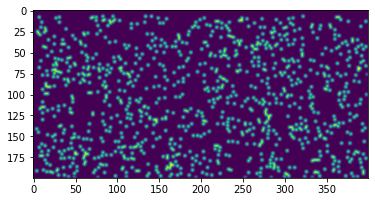

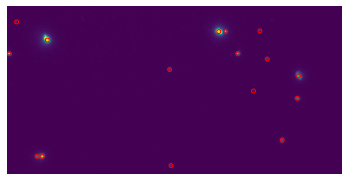

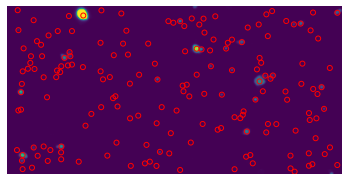

1.2900301025818317 0.008660557870005081
0.9820611138229617 0.009207907989551288
1.2900301025818317 0.010342626082414569
0.9820611138229617 0.013343249910010076
Pos412
 [[ 67.98993216  60.97040758]
 [225.87234765  50.08484816]
 [ 32.09939148  74.27383367]
 [ 64.16056472 166.93252886]
 [242.86692818  70.99607725]
 [231.72609532  50.88019832]
 [301.0144708   89.04145985]
 [296.0814579  110.82182457]
 [285.90435179 148.97089363]
 [179.06066909  86.83636679]
 [268.06438127  75.77703456]
 [181.94617356 173.24423288]
 [261.03459561  49.85951379]
 [ 39.95833333  45.34722222]
 [255.95083548 104.94023136]
 [ 83.47272025  53.4907444 ]
 [240.25995366  46.2947667 ]
 [ 48.71605497  65.94497155]
 [ 78.34460303 159.9915609 ]
 [257.57034548  66.6293245 ]
 [246.71395507  46.30568745]
 [313.12256554  87.21795717]
 [311.88736878 107.59556265]
 [298.01269985 145.79921435]
 [195.25690275  80.86930739]
 [284.5268012   71.58717775]
 [196.19055401 168.71306787]
 [277.88381677  45.82753763]
 [ 55.31397048  36.8

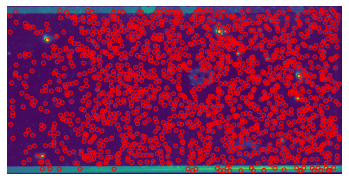

Matched clusters before polywarp:  133
Matched clusters after polywarp:  130
Out of  1570  smFRET peaks and  252  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  51


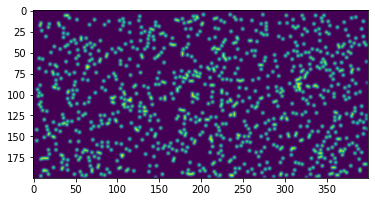

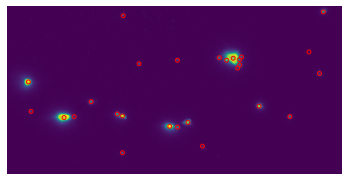

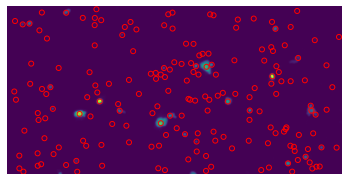

1.6663651033774338 0.013264336928027538
1.259565152436197 0.03442826684966986
1.6663651033774338 0.038112770557613654
139.82125784101422 0.038478338367647295
Pos413
 [[ 51.16237946  96.01978546]
 [ 86.00157761 127.9502799 ]
 [237.6778467   71.6515225 ]
 [133.93021929 124.212266  ]
 [263.08438764 113.04765033]
 [194.02446837 130.08283655]
 [320.05588465  26.25042868]
 [133.93021929 124.212266  ]
 [110.053834   112.98952764]
 [289.221483   123.81722511]
 [225.03637511  70.92125736]
 [136.95979899  33.73823664]
 [186.85947712  73.14297386]
 [ 54.03741788 121.9117395 ]
 [243.84802531  69.16866681]
 [211.90493791 152.13409225]
 [316.19044861  83.05386824]
 [306.6223176   64.23175966]
 [243.84802531  69.16866681]
 [ 65.99024236  91.71217406]
 [ 98.45444899 124.47561148]
 [253.4306012   70.79756176]
 [152.0105102  123.18327033]
 [277.04751229 114.66548893]
 [211.8616612  129.35841824]
 [336.03809618  28.64092453]
 [147.26539845 121.38777189]
 [123.34217335 109.94611551]
 [305.13513022 124.305

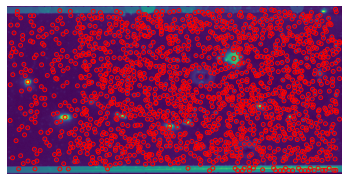

Matched clusters before polywarp:  137
Matched clusters after polywarp:  127
Out of  1598  smFRET peaks and  274  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  46


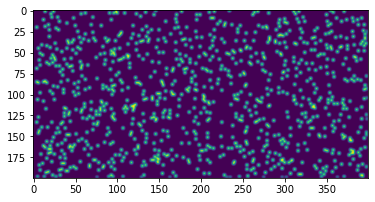

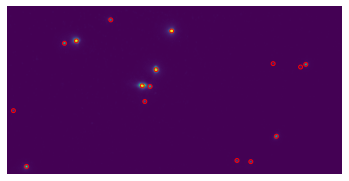

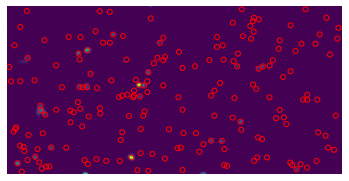

1.0633538657617694 0.006353723939329408
1.0633538657617694 0.008172700912888306
0.7652315656600794 0.008989406105933972
1.0633538657617694 0.009929774600101358
Pos414
 [[181.90373381  42.91287783]
 [168.14597701  78.07157785]
 [157.09499184  93.30050536]
 [ 95.04091752  51.99653204]
 [ 52.01625686 167.98191425]
 [ 84.95394538  55.79502167]
 [162.82785343  93.89726558]
 [304.95681123  71.21162498]
 [278.10750163 137.06457926]
 [126.09325681  33.19446981]
 [255.87623177 160.18289318]
 [158.05787781 107.02756086]
 [ 39.11794374 118.12492726]
 [243.023537   159.89553442]
 [274.19662447  71.07369902]
 [299.82198661  73.9921875 ]
 [197.17736617  45.58959488]
 [182.82745397  80.90815027]
 [170.09763058  95.68650516]
 [109.95001824  54.3726766 ]
 [ 64.05337615 169.08079228]
 [ 99.10160059  56.56066253]
 [177.26519093  96.28359222]
 [319.7691906   76.60236468]
 [292.70280582 142.2814788 ]
 [141.55596838  35.26679276]
 [269.2031402  165.40190666]
 [172.40937913 110.05920399]
 [ 52.17331459 117.9

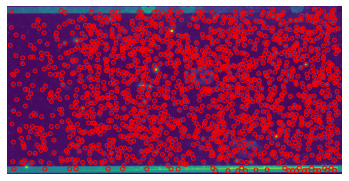

Matched clusters before polywarp:  127
Matched clusters after polywarp:  123
Out of  1635  smFRET peaks and  266  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  46


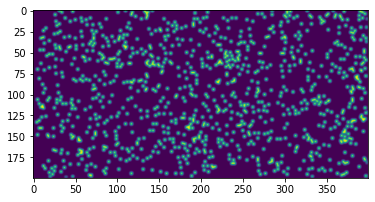

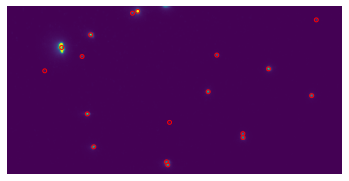

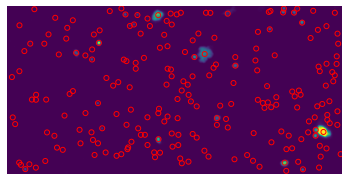

172.66928320309708 0.059138544550942015
118.69272834397276 0.06369299607169605
119.24164266411913 0.06739808276895382
159.17123677701667 0.07256606240317634
12.99856806795886 0.02380505781163997
7.92776624988279 0.024008317876547315
7.92776624988279 0.02400831787654743
153.57018196242055 0.02431648132798815
77.57375387807444 0.011432916941962752
77.57375387807444 0.011432916941963153
73.93568216427818 0.012412248934385148
147.0714320432513 0.01282006685239637
93.77663747952535 0.010410289783199099
77.57375387807444 0.011432916941962752
73.93568216427818 0.012412248934385148
147.0714320432513 0.01282006685239637
93.77663747952535 0.01041028978320229
77.57375387807444 0.011432916941962752
105.32473575624931 0.015952746895819676
158.6499722641266 0.01841242294226327
93.77663747952535 0.01041028978320229
91.35190722306649 0.010868611134020994
91.35190722306649 0.010868611134021064
77.57375387807444 0.011432916941962752
93.77663747952535 0.01041028978320229
91.35190722306649 0.0108686111340

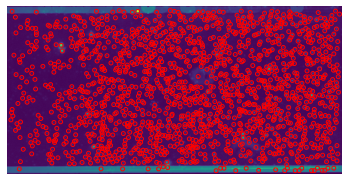

Matched clusters before polywarp:  149
Matched clusters after polywarp:  142
Out of  1563  smFRET peaks and  274  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  51


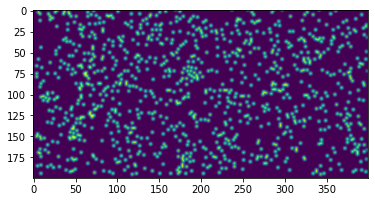

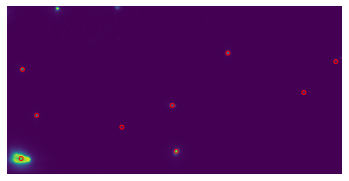

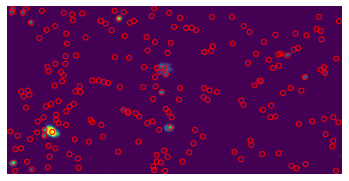

179.3978662549126 0.02970649267410992
179.3978662549126 0.04882888575108427
179.3978662549126 0.056175927857072115
179.69989367476344 0.05830575392888789
8.974496168169788 0.03306855531342643
8.974496168169788 0.03306855531342643
8.974496168169788 0.03306855531342665
19.330532180053932 0.0350586743317819
15.016686010287916 0.009555688252236016
15.016686010287916 0.009555688252236016
8.974496168169788 0.03306855531342643
132.22888883590974 0.0388905912156138
15.016686010287916 0.009555688252236016
118.63902212037219 0.02439625819342117
134.9560237631822 0.02942166429566344
24.119283555800408 0.03482762373798946
15.016686010287916 0.009555688252236016
84.22488410527188 0.01528044454573969
118.63902212037219 0.02439625819342117
104.52587410804833 0.02822456469936971
84.22488410527188 0.01528044454573969
118.63902212037219 0.02439625819342117
115.43498374393671 0.02455551899337531
169.53740782241297 0.03597481618198166
115.43498374393671 0.02455551899337531
104.52587410804833 0.02822456469

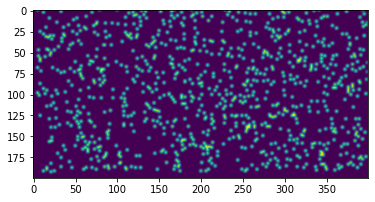

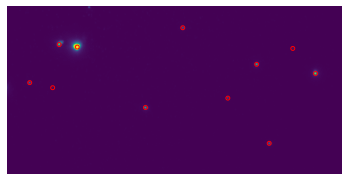

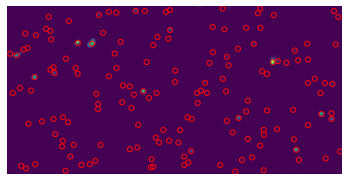

0.323167483960416 0.011651557427182869
1.0081130258022584 0.014992888098000966
1.0081130258022584 0.019073543424474124
1.0081130258022584 0.021798209529293667
Pos417
 [[101.15082288  44.034751  ]
 [316.95283515  65.96923493]
 [ 84.0520545   43.02022726]
 [261.87021631  59.78618968]
 [162.0508579  100.88587769]
 [ 56.06291287  79.1931425 ]
 [276.07949791 132.82372203]
 [194.03569421  27.80747611]
 [236.02738854  90.71146497]
 [294.16463415  44.24085366]
 [110.76845701  60.01999991]
 [328.6464766   84.92978479]
 [ 94.26858814  57.6636736 ]
 [274.86715695  76.35551799]
 [172.97283867 115.51913301]
 [ 67.18186359  92.41850227]
 [286.06780707 148.6823484 ]
 [207.38586953  42.67544276]
 [248.38413484 107.20872869]
 [307.96084194  61.9481537 ]]
Automatically matched beads:  10


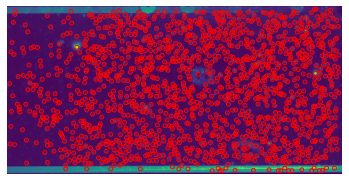

Matched clusters before polywarp:  113
Matched clusters after polywarp:  110
Out of  1528  smFRET peaks and  246  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  44


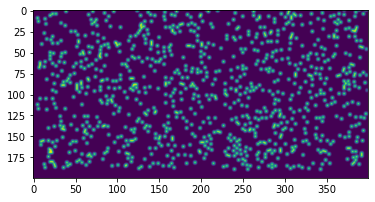

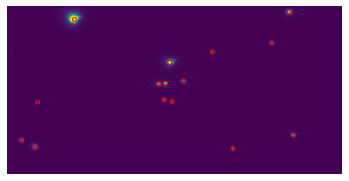

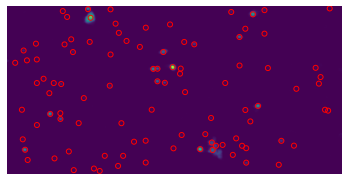

0.5952836448378318 0.020854768885335932
0.2709543645280448 0.028096920776017418
1.5464961639571022 0.0307994419431018
0.2709543645280448 0.03099672226948893
1.3487567059852927 0.008728939506781302
1.3487567059852927 0.008728939506781302
1.0727584489250412 0.012298749576319571
1.5392995730507553 0.013728041601779603
Pos418
 [[ 99.13044957  13.07353584]
 [186.04285714  54.01316638]
 [293.03829559   8.98124933]
 [178.98096886  73.97750865]
 [174.02770943  74.14849684]
 [299.13059723 118.34424409]
 [243.06157635 132.79187192]
 [ 62.99019608 127.11764706]
 [276.9977911   36.0645314 ]
 [197.18435121  72.09244673]
 [179.02304147  88.98502304]
 [187.86963864  90.76865924]
 [222.9947717   44.83408853]
 [ 50.96255756 127.98933035]
 [ 64.01627219  92.2433432 ]
 [108.33526297  34.81900074]
 [195.36296036  74.40941087]
 [304.90993838  28.62665743]
 [191.62789165  93.41060799]
 [185.05484408  93.94904601]
 [308.08265608 141.16600788]
 [252.97183814 153.36807166]
 [ 71.92211382 151.08250078]
 [288.68

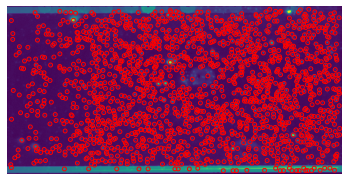

Matched clusters before polywarp:  150
Matched clusters after polywarp:  145
Out of  1674  smFRET peaks and  278  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  52


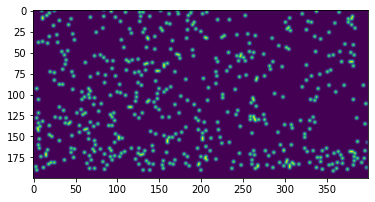

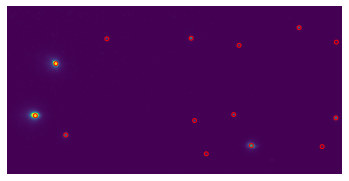

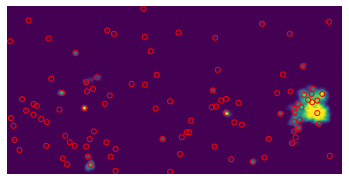

1.0651210226927195 0.015306091058252442
0.19331941449867127 0.023745060678781744
179.80668058550134 0.048089459286689125
3.8773238001752373 0.058445438089870676
Pos445
 [[ 81.12944523  55.32268848]
 [ 64.90760085 102.93370073]
 [204.1719457   30.76470588]
 [261.94207356 127.13142885]
 [337.97150611 101.14789688]
 [245.07100835  99.9541661 ]
 [ 92.01025427 121.04293946]
 [303.93521505  20.26236559]
 [127.00089847  32.24079066]
 [248.01995305  36.85856808]
 [219.05489478 135.91399817]
 [325.96276437 127.82931189]
 [337.06621125  32.03678403]
 [ 91.15252787  75.10278935]
 [ 72.2198982  122.63052657]
 [215.03338436  52.28381922]
 [269.8318175  150.63712039]
 [347.15011912 125.6359984 ]
 [253.7125963  122.27068927]
 [100.02389531 140.4220871 ]
 [313.80894181  42.98019533]
 [137.89480463  52.55390886]
 [258.83784055  58.9408086 ]
 [228.48376182 158.10588021]
 [334.50234343 151.87611333]
 [347.84044326  56.28765423]]
Automatically matched beads:  13


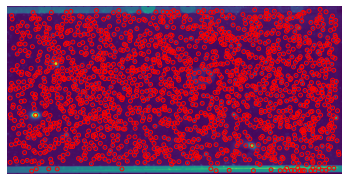

Matched clusters before polywarp:  25
Matched clusters after polywarp:  25
Out of  1741  smFRET peaks and  79  clusters
Percentage of matched smFRET peaks:  1
Percentage of matched clusters:  31


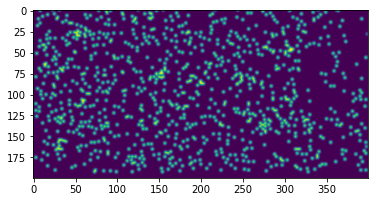

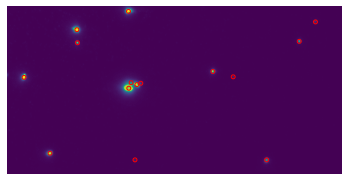

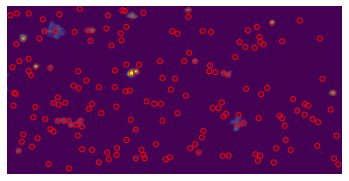

0.6293358866706096 0.02375802043999096
0.6293358866706096 0.024112151756657943
0.6293358866706096 0.024947216775800026
168.31225943409174 0.03210108859191967
96.90875840865378 0.014332091580498422
0.3750325007297985 0.016865988074631154
0.3750325007297985 0.016900010676860786
16.192686434710915 0.01717909602577935
Pos446
 [[101.04451525  28.23079199]
 [149.00228565  11.11817245]
 [ 51.04726017  72.8999843 ]
 [ 75.94893155 140.99867198]
 [223.95284969  64.97391476]
 [148.07443931  79.18314223]
 [ 98.96301131  40.71845083]
 [153.91361658  77.03865688]
 [301.06372881  36.14169492]
 [274.54041161 141.39611741]
 [316.00551809  18.95778899]
 [241.86143844  69.77813897]
 [152.97261316 146.88018258]
 [110.48371122  44.11635626]
 [157.75662649  27.52923094]
 [ 62.0366803   87.5686974 ]
 [ 85.51222617 157.07453216]
 [234.7954153   82.77143949]
 [157.79652824  97.82543621]
 [111.01045888  56.08087436]
 [165.2003773   94.56650229]
 [313.88304979  55.52694905]
 [283.6459746  163.81525961]
 [328.795

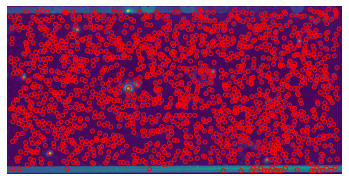

Matched clusters before polywarp:  152
Matched clusters after polywarp:  151
Out of  1671  smFRET peaks and  232  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  65


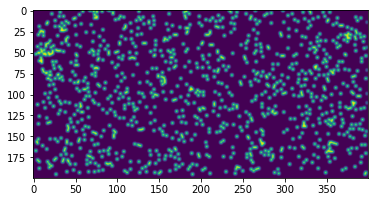

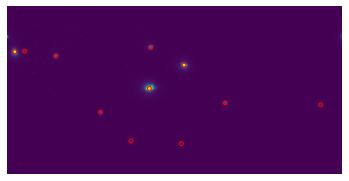

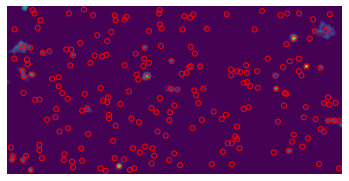

7.057463056033912 0.03945770978690945
6.0207690499008395 0.04301149327078402
6.471697954499875 0.050032959609503436
33.29363198641543 0.059519542310113194
65.2342487620791 0.03070190828988916
65.2342487620791 0.03070190828988916
65.2342487620791 0.030701908289889262
172.26718222558412 0.03201419743423075
81.74289460821092 0.020386399130804447
81.74289460821092 0.020386399130804804
164.59855054562192 0.024403538783345637
116.30176505483665 0.02805582027602718
110.08541265660853 0.018917064993172136
148.2621885066954 0.024995994956693253
101.72809487870833 0.026276159298573055
13.971437293611094 0.028463006731311136
167.39321691066203 0.02983773254704474
126.16991145844433 0.029953674424885803
76.8412018875792 0.030211684451327846
65.2342487620791 0.03070190828988916
167.39321691066203 0.029837732547044173
90.3690932067609 0.03014981200357652
65.2342487620791 0.03070190828988916
65.2342487620791 0.03070190828988916
1.7203944805114757 0.01776804867469286
167.39321691066203 0.0298377325470

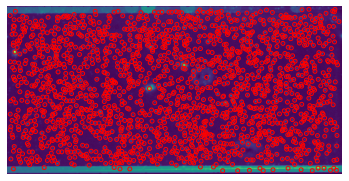

Matched clusters before polywarp:  60
Matched clusters after polywarp:  59
Out of  1756  smFRET peaks and  264  clusters
Percentage of matched smFRET peaks:  3
Percentage of matched clusters:  22


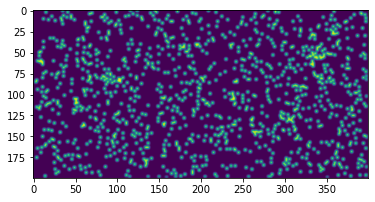

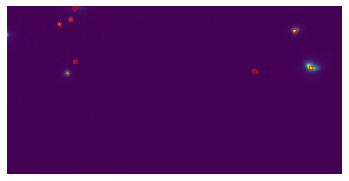

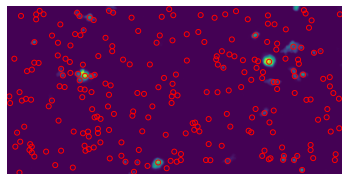

0.562446043785737 0.051272502976545675
84.4430874517767 0.06681781223028821
156.28105347785004 0.07414312398183515
3.454192056324304 0.07937540941777958
145.80223931872354 0.03666661450645221
145.80223931872354 0.03666661450645221
145.80223931872354 0.03666661450645261
145.80223931872354 0.03666661450645261
31.723869532552865 0.03014667185803557
0.865821990282315 0.03497100535881808
145.80223931872354 0.03666661450645221
36.363368536145046 0.03725511587338212
67.00842749321876 0.029640692676461498
31.723869532552865 0.03014667185803557
0.865821990282315 0.03497100535881808
158.06975457231619 0.041975303870619825
0.865821990282315 0.03497100535881808
158.06975457231619 0.04197530387061849
136.03778716943793 0.04204743275410433
24.502335423154324 0.04927945056463289
0.865821990282315 0.03497100535881808
158.06975457231619 0.04197530387061849
175.83136176574735 0.05077808359562742
19.259960250346627 0.05238967482523937
158.06975457231619 0.041975303870619825
19.259960250346627 0.052389674

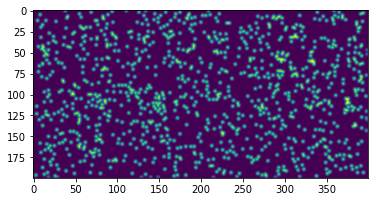

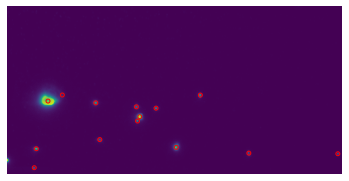

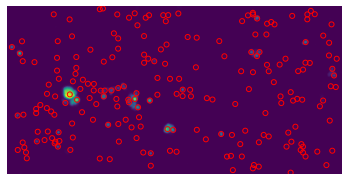

0.45067622457625534 0.01636738650412036
0.0514656044051675 0.027030999232683157
0.45067622457625534 0.027777292665752254
0.45067622457625534 0.02785362586359052
Pos449
 [[ 74.33392815 104.61723242]
 [155.84515216 120.06429077]
 [ 60.93313859 149.90408958]
 [191.08448797 146.10636821]
 [114.96793974 107.00507268]
 [209.18427975  98.9695188 ]
 [169.97831911 111.9957635 ]
 [155.84515216 120.06429077]
 [ 60.05513895 166.98125276]
 [152.0248223  110.07399692]
 [120.12237612 140.94716836]
 [335.31539424 150.30663329]
 [255.16212217 151.98171634]
 [ 86.9160105   98.03412073]
 [ 83.84518848 109.32937982]
 [167.75385755 123.89500438]
 [ 72.98929047 152.90552973]
 [201.0659723  152.05178014]
 [127.55969531 111.12223888]
 [223.2630574  104.34002882]
 [182.66347618 116.17131147]
 [165.71002194 127.86983434]
 [ 71.07060265 170.24560753]
 [164.68285474 114.89703993]
 [131.09683388 144.71782136]
 [348.84654728 158.43962219]
 [267.42136971 157.59514544]
 [ 96.95763171 103.82332166]]
Automatically matc

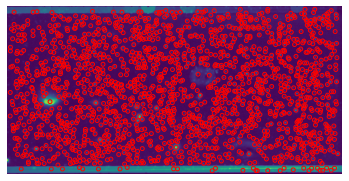

Matched clusters before polywarp:  161
Matched clusters after polywarp:  158
Out of  1702  smFRET peaks and  296  clusters
Percentage of matched smFRET peaks:  9
Percentage of matched clusters:  53


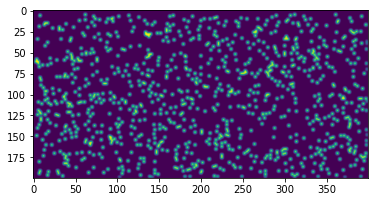

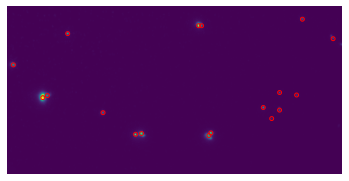

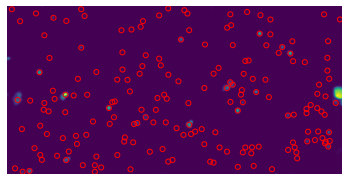

0.7462139018012061 0.01472021913366367
1.2772730413732127 0.0361341116057165
0.7462139018012061 0.03624342156191697
0.10733590807852879 0.036841715428346265
Pos450
 [[207.07893748  39.09146723]
 [150.97804209 140.10704483]
 [154.93975129 138.83490566]
 [217.02428007 140.9264522 ]
 [ 87.96695265  48.83285669]
 [217.02428007 140.9264522 ]
 [266.21428571 113.65306122]
 [ 38.10962874  78.21502163]
 [121.04996526 120.93907978]
 [207.07893748  39.09146723]
 [ 69.13108432 105.0444114 ]
 [279.89759036  99.46987952]
 [301.11640678  32.05064407]
 [328.07964602  48.07487007]
 [281.00905292 114.04735376]
 [296.99023136 101.85449871]
 [275.02590481 123.95798215]
 [221.8380556   40.81099276]
 [163.85513459 140.02865013]
 [169.31151544 139.32860207]
 [232.74606318 138.99519326]
 [102.0515642   47.66727009]
 [230.98706687 141.38389222]
 [280.79568533 115.86387438]
 [ 52.25984478  76.11232026]
 [134.15999901 120.12750363]
 [224.6206973   40.90729945]
 [ 83.27391397 104.36404979]
 [295.77384519 102.2429

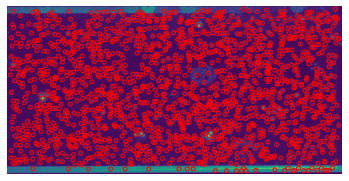

Matched clusters before polywarp:  147
Matched clusters after polywarp:  140
Out of  1705  smFRET peaks and  262  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  53


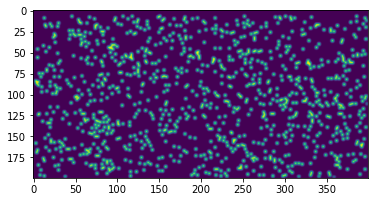

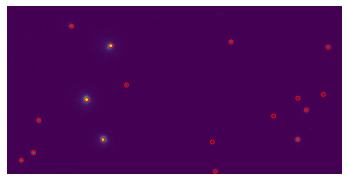

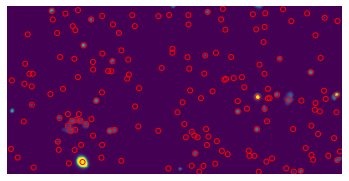

150.8888259487686 0.04328603425535246
164.83890398986634 0.0451747004368247
30.432855202371528 0.047361830686646726
164.5613792279725 0.05683730398964057
0.8303726252184738 0.0125739861397239
1.2790501289992722 0.014320053582534709
127.32097310524438 0.017421708691414045
127.32097310524438 0.017421708691414045
Pos451
 [[106.06898243 112.08510194]
 [125.24009729  65.05469076]
 [122.11555141 148.06361623]
 [ 60.06246351 161.09136019]
 [298.01712034 146.13986901]
 [ 90.90430697  46.04030279]
 [236.10768357  58.21896291]
 [ 62.01658443 132.83538925]
 [307.07934403 121.93218772]
 [325.0377863   62.01883502]
 [224.1948216  175.03537681]
 [321.89862011 104.95982352]
 [275.01888554 125.01034037]
 [298.89770842 107.91225811]
 [220.07517577 149.25959978]
 [119.22519224 108.08745591]
 [141.46585965  59.06780373]
 [134.04899204 144.61612836]
 [ 70.52754407 156.39387303]
 [312.30826625 145.23760643]
 [105.60609532  40.96305551]
 [251.52326899  55.80684304]
 [ 75.42662701 127.03220622]
 [320.1686287

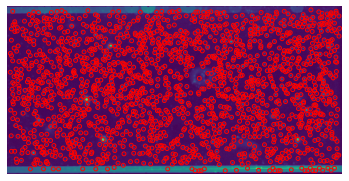

Matched clusters before polywarp:  158
Matched clusters after polywarp:  155
Out of  1762  smFRET peaks and  285  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  54


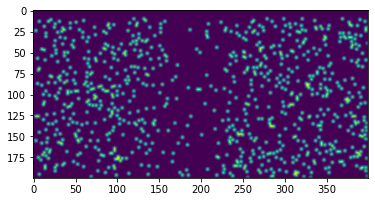

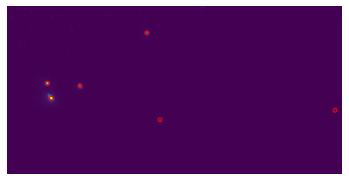

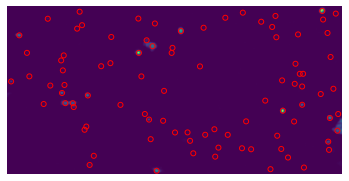

0.9702796639231641 0.011571900921436958
2.719145620125025 0.08844637714269701
162.7948342468292 0.10551074842032752
35.71499430307545 0.12370964234849895
Pos452
 [[ 68.95972289 115.08239369]
 [ 64.9691084  102.92101369]
 [ 95.85041408 105.8852657 ]
 [156.89315587  55.0121497 ]
 [168.96445498 134.73341232]
 [328.87182308 124.04741504]
 [ 86.89754442 106.70510766]
 [ 83.38210235  93.03291361]
 [113.20549806  95.43013249]
 [174.47031643  47.33854144]
 [186.19747143 126.89035605]
 [346.50377321 118.58771644]]
Automatically matched beads:  6


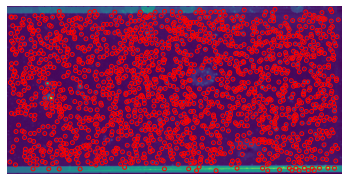

Matched clusters before polywarp:  110
Matched clusters after polywarp:  106
Out of  1690  smFRET peaks and  231  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  45


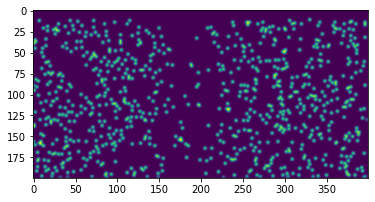

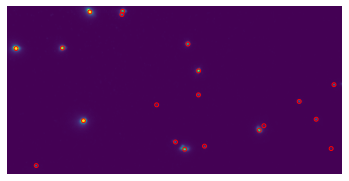

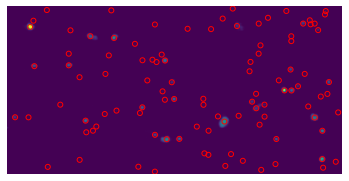

4.086775597515203 0.023808602810277732
0.6554935610465213 0.03478061937263188
0.6554935610465213 0.042252124252159476
0.6554935610465213 0.04261006407284144
105.16053957256844 0.00844161483740632
49.639164298012034 0.016111109254742177
49.639164298012034 0.016111109254742177
49.639164298012034 0.016111109254742222
105.16053957256844 0.00844161483740632
105.16053957256844 0.00844161483740632
105.16053957256844 0.008441614837406393
105.16053957256844 0.008441614837406393
173.24373157431705 0.006013182077898627
173.24373157431705 0.006013182077898627
173.24373157431705 0.006013182077898682
105.16053957256844 0.008441614837406436
173.24373157431705 0.006013182077898627
173.24373157431705 0.006013182077898627
49.639164298012034 0.016111109254742222
142.12251063635065 0.01691849666902688
173.24373157431705 0.006013182077898627
173.24373157431705 0.006013182077898627
49.639164298012034 0.016111109254742222
142.12251063635065 0.01691849666902688
173.24373157431705 0.006013182077898627
173.2437

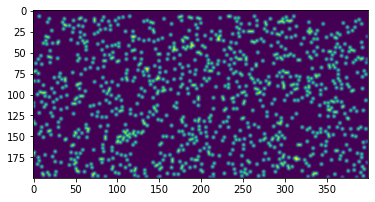

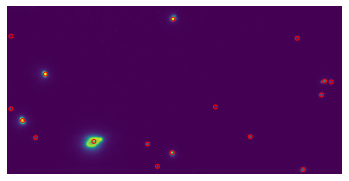

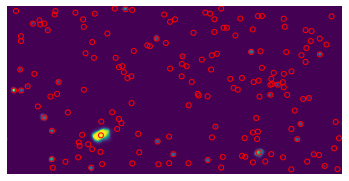

27.24298838624668 0.02701717586178667
1.8324996153684163 0.03701761565518431
7.4014046777246145 0.038519296377003354
36.430562291803355 0.04845593316287011
61.42180355540418 0.020821941004622976
44.92767917497111 0.023674288022527405
44.92767917497111 0.023674288022527405
137.24341483097805 0.026392660575495497
125.40339625090928 0.01724675617351171
125.40339625090928 0.017246756173511735
79.3478751751862 0.019988077446757638
87.16189828771205 0.02325911238101449
107.57471536825206 0.013205041432374472
107.57471536825206 0.013205041432374668
79.72004055897126 0.018714353484819927
66.98684688610996 0.01890638416897518
107.57471536825206 0.013205041432374472
163.66949798077235 0.019268019085334796
163.66949798077235 0.019268019085334796
163.66949798077235 0.019268019085334796
107.57471536825206 0.013205041432374472
163.66949798077235 0.019268019085334796
163.66949798077235 0.019268019085334796
163.66949798077235 0.019268019085334796
107.57471536825206 0.013205041432375003
87.161898287712

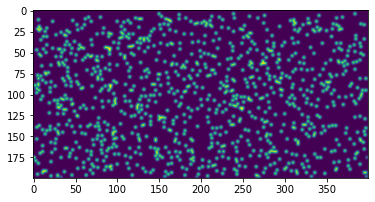

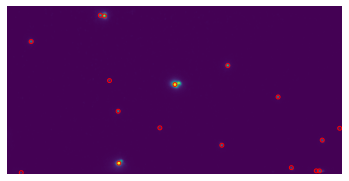

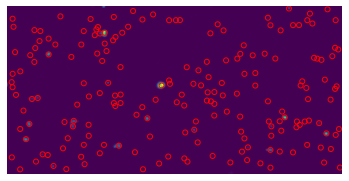

0.32916350491809093 0.010878604713377055
1.0784037557114725 0.013651575335505853
1.0784037557114725 0.016907240251686013
1.0784037557114725 0.01885684292536423
Pos479
 [[132.97562422 165.9731369 ]
 [183.97496582  94.06030902]
 [115.96573553  31.00416232]
 [227.96136364  75.88863636]
 [128.7080292  118.50364964]
 [273.89361702 103.77021277]
 [222.96801196 146.92316891]
 [ 49.05342533  56.90418926]
 [313.98873636 170.95441746]
 [315.10005498 142.80208906]
 [287.15023923 167.91770335]
 [120.11920764  90.84188185]
 [ 41.80237877 176.2305581 ]
 [166.97405858 133.15158398]
 [331.10370581 132.01742656]
 [313.98873636 170.95441746]
 [148.45289785 166.37702616]
 [200.05098861  94.60528446]
 [135.76368421  31.62789867]
 [248.47946911  77.37502474]
 [148.02080238 118.85547635]
 [294.38045088 106.30427718]
 [242.78408139 150.30064474]
 [ 68.61778431  54.81389806]
 [331.98368862 174.11282624]
 [334.6097488  145.92880802]
 [306.25815935 170.97795019]
 [140.17289067  90.80598329]
 [ 59.11117343 174.7

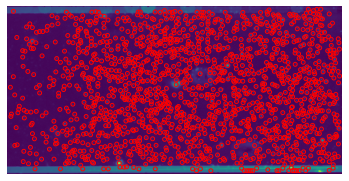

Matched clusters before polywarp:  157
Matched clusters after polywarp:  154
Out of  1535  smFRET peaks and  280  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  55


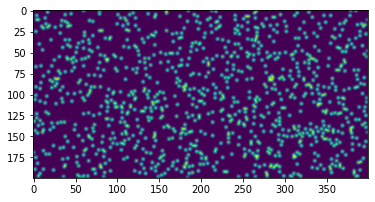

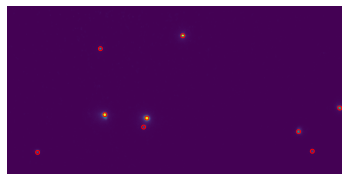

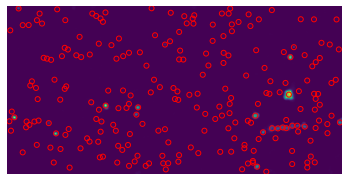

0.24506800702784237 0.0093847105577914
0.7111018082273012 0.019306678765068627
2.0050306932539677 0.019820453380093455
0.24506800702784237 0.022158938083798034
Pos480
 [[117.07286972 117.9683145 ]
 [155.94178897 120.11017453]
 [187.9943609   45.09962406]
 [ 57.85922665 151.18479199]
 [305.20918367 149.89522595]
 [153.88430327 128.7737074 ]
 [135.85339586 121.92500301]
 [174.27416757 125.21938019]
 [207.37756135  49.96321777]
 [ 74.16075315 156.29363273]
 [325.4961394  156.05832302]
 [171.25801656 133.42166074]]
Automatically matched beads:  6


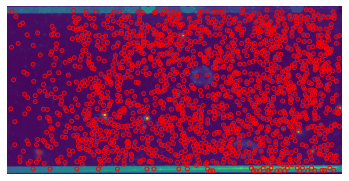

Matched clusters before polywarp:  131
Matched clusters after polywarp:  126
Out of  1579  smFRET peaks and  262  clusters
Percentage of matched smFRET peaks:  7
Percentage of matched clusters:  48


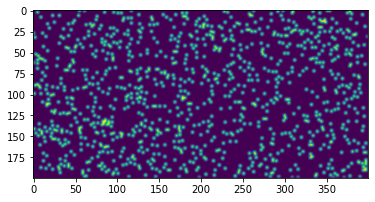

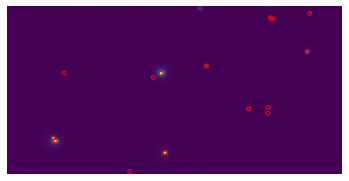

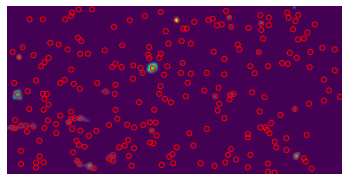

38.860056256588216 0.04610609679110835
38.1881559967708 0.0513913825267859
170.53829381192648 0.053943691666382076
169.88848878234293 0.05399793229544146
29.435972487961394 0.01898420054064354
35.97792213032039 0.028899811274048514
35.97792213032039 0.02889981127404856
170.58889974909223 0.030870051447477294
41.88733258910055 0.016800438362864496
41.88733258910055 0.016800438362864684
30.803782021814342 0.01757348910538068
129.176254364497 0.018103165014473545
129.17076984065343 0.012803649092551892
41.88733258910055 0.016800438362864496
30.803782021814342 0.01757348910538068
129.176254364497 0.018103165014473545
129.17076984065343 0.012803649092551892
30.803782021814342 0.01757348910538068
7.236617515690434 0.02084144530961105
139.09127045109253 0.024205516745164024
129.17076984065343 0.012803649092551892
148.50119553956114 0.015723033053605277
30.803782021814342 0.01757348910538068
7.236617515690434 0.0208414453096108
129.17076984065343 0.012803649092552204
30.803782021814342 0.01757

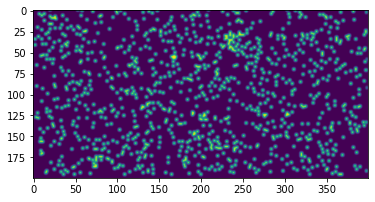

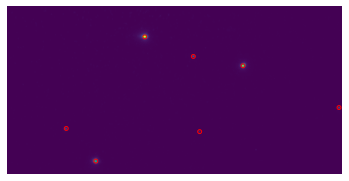

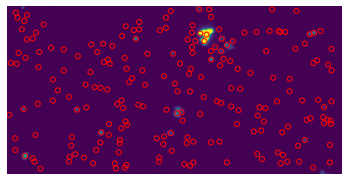

1.140709466465201 0.02152457327896442
1.140709466465201 0.030975509872112575
1.140709466465201 0.037687825398586464
0.8027188748930624 0.04624288656405651
1.140709466465201 0.021524573278964426
1.140709466465201 0.037687825398586464
1.140709466465201 0.037687825398586464
1.140709466465201 0.037687825398586554
171.25501706879945 0.034677333607945456
1.140709466465201 0.037687825398586464
1.140709466465201 0.037687825398586554
66.4373179529746 0.04473340182701705
86.16061744838642 0.025200006655720912
100.24152070878793 0.030418436587584013
171.25501706879945 0.034677333607945456
155.75390444088288 0.034887850031642735
86.16061744838642 0.025200006655720697
100.24152070878793 0.030418436587584013
105.86485792211697 0.03163037902124564
171.25501706879945 0.034677333607945456
100.24152070878793 0.030418436587584013
171.25501706879945 0.034677333607945456
155.75390444088288 0.034887850031642645
155.75390444088288 0.034887850031642645
110.0921803676304 0.02761049855973489
105.86485792211697 

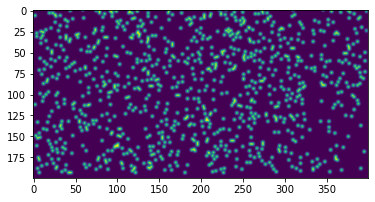

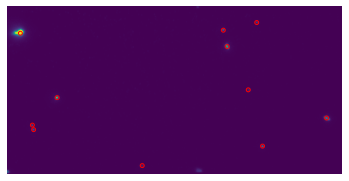

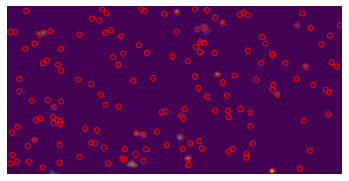

24.979647202235473 0.046732822763035156
65.23952098153386 0.0593527401094905
141.07565648434164 0.06656961103634358
34.374296696261595 0.07354371267529256
104.13297894498314 0.026898904235948914
104.13297894498314 0.026898904235948914
84.70848628017066 0.03421190044206917
150.05399147920437 0.034745691617138405
128.6340295953382 0.008479182923331618
128.6340295953382 0.008479182923331618
128.6340295953382 0.008479182923331618
128.6340295953382 0.008479182923331717
128.6340295953382 0.008479182923331618
128.6340295953382 0.008479182923331618
1.797919866502007 0.014234055258175634
1.797919866502007 0.014234055258175634
Pos483
 [[230.0085034   41.94274376]
 [263.78021978 131.76923077]
 [322.14231715 104.40814382]
 [226.85239018  26.91472868]
 [ 55.11668758 119.80959849]
 [ 55.11668758 119.80959849]
 [256.97453734  19.14398215]
 [154.03565478 151.05564812]
 [250.94392833  80.85442933]
 [247.92752974  60.01033501]
 [279.99496564 151.21151583]
 [338.65909167 125.70029547]
 [244.4637247   45.

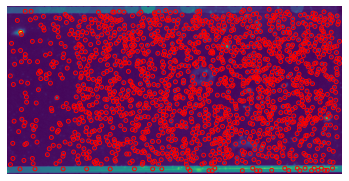

Matched clusters before polywarp:  130
Matched clusters after polywarp:  130
Out of  1545  smFRET peaks and  242  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  53


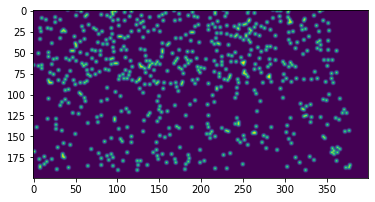

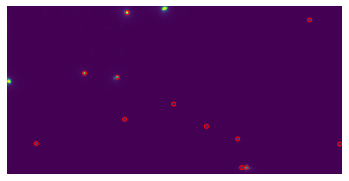

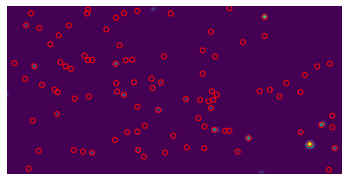

0.9175023755869776 0.022942593842803755
0.9175023755869776 0.029136264625321703
40.63842296684051 0.03575311231338089
0.9175023755869776 0.03590193357975049
0.9175023755869776 0.011075665873915038
2.42406921167171 0.022719854673923453
40.27901303509724 0.0227488406108824
40.27901303509724 0.0227488406108824
Pos484
 [[139.08955224   7.66666667]
 [100.94186047  63.43488372]
 [129.07925047  68.02716177]
 [247.06591998 146.92174725]
 [ 59.02755166 128.14652473]
 [243.00742983 121.02449092]
 [307.11566538  12.13232697]
 [138.93118514 105.18077553]
 [213.07036929 110.04332655]
 [183.10712665  90.25374489]
 [247.06591998 146.92174725]
 [156.50940481  28.7376059 ]
 [117.45472332  84.04641669]
 [147.37505037  87.76597236]
 [264.96557495 170.83409434]
 [ 72.98030892 148.10889638]
 [257.26929431 144.52439514]
 [323.46986104  35.89975917]
 [153.87276467 126.21347606]
 [228.70221482 132.95051919]
 [198.66165421 112.44032281]
 [260.8418388  170.79187531]]
Automatically matched beads:  11


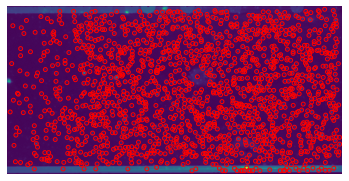

Matched clusters before polywarp:  82
Matched clusters after polywarp:  80
Out of  1581  smFRET peaks and  139  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  57


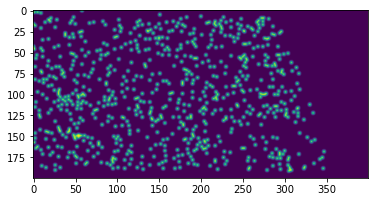

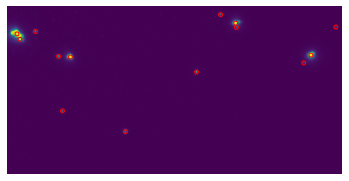

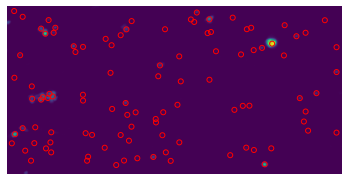

0.5887468102303582 0.012343412209474647
0.5613001952056763 0.01842982354943314
0.5887468102303582 0.021338728767730995
0.5887468102303582 0.024560401037893465
Pos511
 [[ 90.04434251  47.83792049]
 [316.00252433  44.04620701]
 [241.03242971  14.92701428]
 [ 40.00534188  26.04469373]
 [205.04888889  59.22222222]
 [ 45.09514036  32.09091458]
 [ 79.00318471  47.06390658]
 [226.00539499   6.81387283]
 [ 57.02982732  25.00062794]
 [141.01290323 114.93548387]
 [303.95836606  49.03809898]
 [241.03242971  14.92701428]
 [104.46382858  69.1209905 ]
 [324.60754663  68.10551413]
 [255.84586975  38.68177898]
 [ 55.66258921  47.78669351]
 [219.86169762  83.2147071 ]
 [ 58.40865641  52.83343871]
 [ 93.7042014   68.49774489]
 [242.04093828  30.75149239]
 [ 72.7377192   45.65738918]
 [154.53998872 137.57567808]
 [317.93067412  75.18296103]
 [256.42886355  42.58435358]]
Automatically matched beads:  12


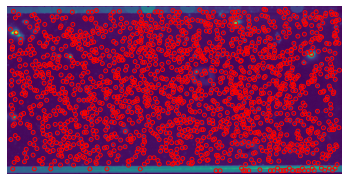

Matched clusters before polywarp:  142
Matched clusters after polywarp:  141
Out of  1665  smFRET peaks and  208  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  67


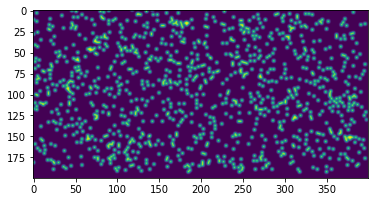

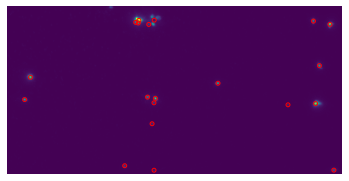

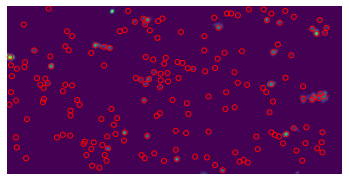

178.15036948448892 0.05202714899305088
9.870345224121662 0.06973359459754466
9.076314489760417 0.07245872223726754
166.32052002344216 0.07578408053248821
34.45816226624403 0.01942075376246158
166.69674563682685 0.02049729024041825
57.26447801874434 0.021879634535527402
57.26447801874434 0.021879634535527402
33.66029788161336 0.012322905200055214
14.914491620645382 0.019013640278647083
14.914491620645382 0.019013640278647083
14.914491620645382 0.019013640278647083
14.914491620645382 0.019013640278647083
179.31312340378318 0.019382219154417513
36.32492832114208 0.01957723589543636
174.50241369903725 0.020118190890077287
14.914491620645382 0.019013640278646677
118.75484881506553 0.019024272850121378
1.8250629925572985 0.02036058460359685
1.8250629925572985 0.02036058460359685
139.66048537678665 0.017369147962037413
14.914491620645382 0.019013640278647083
1.8250629925572985 0.02036058460359685
1.6617061120580774 0.020400508513083563
20.402213274772322 0.021632332565859575
57.26447801874434

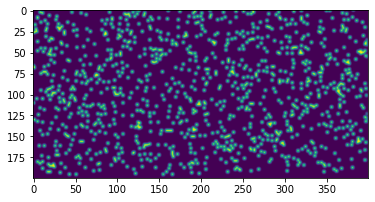

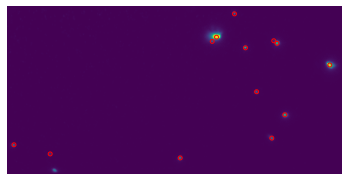

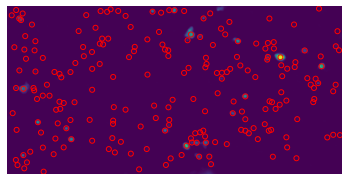

1.0075797264567241 0.010631740167337261
1.0075797264567241 0.01899124670330539
1.1488790290881816 0.019624364843714485
1.0075797264567241 0.0202448562975869
Pos513
 [[325.95971981  60.26774959]
 [275.09567164  41.09164179]
 [245.25477707  45.59235669]
 [284.00915764 107.03963649]
 [188.07927723 147.84128276]
 [234.07824934  13.8938992 ]
 [ 36.14349077 137.85435147]
 [268.96758563 127.13132832]
 [255.9379085   85.88039216]
 [214.95939086  39.96301668]
 [ 70.12483247 145.10051694]
 [275.09567164  41.09164179]
 [341.79163747  77.2010376 ]
 [293.50441142  57.217926  ]
 [264.66722186  61.23348956]
 [300.45498799 122.60301618]
 [204.6147696  161.74283921]
 [254.74161753  30.14047667]
 [ 52.58292515 149.19958115]
 [288.47565345 143.91888591]
 [274.72686459 101.45310711]
 [234.2666349   55.24476467]
 [ 85.66099618 157.68421181]
 [290.56564161  54.85866639]]
Automatically matched beads:  12


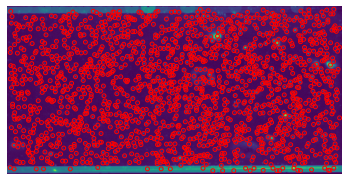

Matched clusters before polywarp:  175
Matched clusters after polywarp:  171
Out of  1668  smFRET peaks and  313  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  54


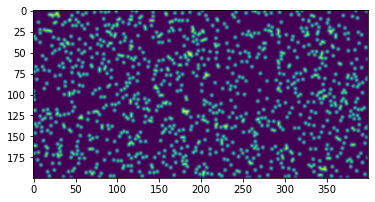

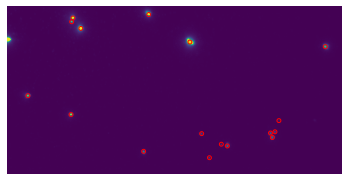

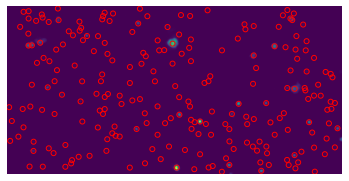

159.72243429307795 0.030769741149876004
160.80026217044426 0.037944347896138965
114.54371348953254 0.04350703039858983
170.24514823715677 0.05035215194448069
108.00499033250935 0.014475127427583521
96.07197565469119 0.01830913088198404
96.07197565469119 0.01830913088198404
96.07197565469119 0.01830913088198404
108.00499033250935 0.014475127427583008
96.07197565469119 0.01830913088198404
102.69208454272643 0.019776596524924837
109.00258740483287 0.02145101533214312
108.00499033250935 0.014475127427583008
4.800282154471074 0.017599488934184386
4.800282154471074 0.017599488934184792
4.800282154471074 0.017599488934184792
Pos514
 [[116.02341137  43.12374582]
 [148.97637795  30.02362205]
 [148.97637795  30.02362205]
 [148.97637795  30.02362205]
 [103.00492611  52.98029557]
 [ 94.86        34.86486486]
 [156.03214286  19.92121849]
 [247.7491475  150.9764833 ]
 [288.98925482 143.34911689]
 [287.29632405 139.24670607]
 [291.3955889  138.15389969]
 [231.37181184 161.6574882 ]
 [224.34742617 139

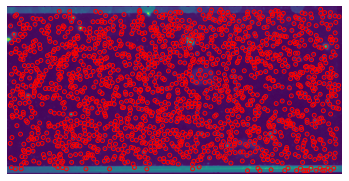

Matched clusters before polywarp:  41
Matched clusters after polywarp:  39
Out of  1645  smFRET peaks and  299  clusters
Percentage of matched smFRET peaks:  2
Percentage of matched clusters:  13


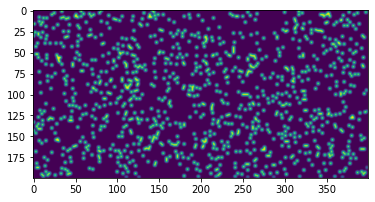

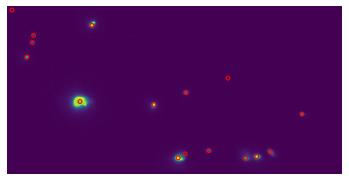

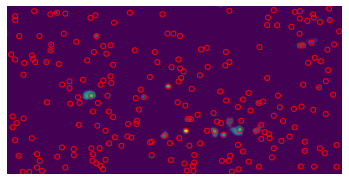

0.8306708524574109 0.011188399750056467
0.8306708524574109 0.012231002250287804
0.8306708524574109 0.014113397902001787
1.300866041231246 0.02559420889112378
Pos515
 [[ 99.97690394 106.02221021]
 [162.87528284 107.94143485]
 [187.02345195 154.02737106]
 [258.09546795 153.03116354]
 [106.05330882  35.01503028]
 [ 46.173674    65.91429495]
 [299.89524371 115.0634827 ]
 [192.00058747  95.17037366]
 [ 51.23160309  52.00208464]
 [213.01520325 148.19340363]
 [ 52.03554165  45.21637759]
 [229.68589744  81.72051282]
 [113.15608408 109.82502036]
 [180.8258273  113.0506249 ]
 [202.7444337  161.70683765]
 [274.57266028 160.70222586]
 [124.2269351   40.46990261]
 [ 64.88902888  69.0656866 ]
 [316.11763252 122.01778877]
 [210.13977397 101.98853769]
 [ 69.7481021   55.81141626]
 [230.9446976  155.16757393]
 [ 70.90784996  49.27011175]
 [248.45988548  88.88325977]]
Automatically matched beads:  12


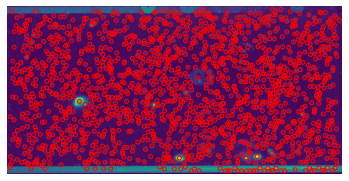

Matched clusters before polywarp:  177
Matched clusters after polywarp:  168
Out of  1626  smFRET peaks and  322  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  52


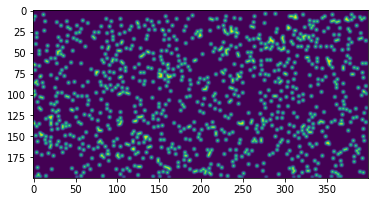

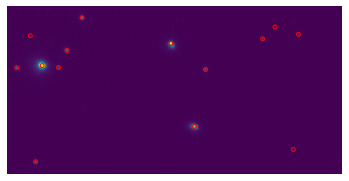

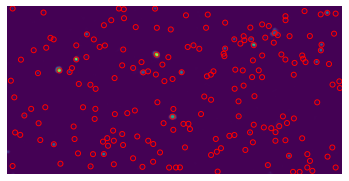

1.1089938319590205 0.017336909195725485
0.11652837431726362 0.019389409534084308
1.1089938319590205 0.0194409859859709
1.1089938319590205 0.022780744815841365
Pos516
 [[ 61.93338051  76.01327357]
 [178.00247843  57.07044493]
 [197.03359089 131.216321  ]
 [ 94.77808219  32.87795766]
 [ 82.02427184  62.88552384]
 [ 55.19773635 164.15690191]
 [ 36.26072041  79.24013722]
 [207.91284184  78.12394051]
 [ 74.10475733  78.00816915]
 [259.8441358   49.88148148]
 [294.12051258  45.82088005]
 [270.79735683  38.79823789]
 [289.61843318 150.03502304]
 [ 46.12977099  48.87022901]
 [ 78.60453327  76.83070375]
 [196.53680178  56.96049657]
 [217.85499513 133.05099772]
 [115.29806299  33.27976228]
 [101.46239826  63.16338161]
 [ 72.37207976 164.78910392]
 [ 55.32989631  78.63347841]
 [228.11542482  80.97903377]
 [ 93.68125371  78.73590417]
 [280.39341705  53.06921764]
 [313.22475196  48.98803952]
 [291.62863519  42.18199191]
 [308.08715691 154.36316662]
 [ 67.81559039  49.41686641]]
Automatically matche

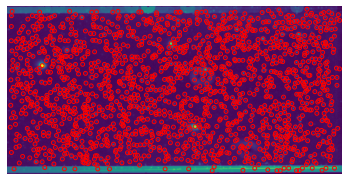

Matched clusters before polywarp:  151
Matched clusters after polywarp:  142
Out of  1598  smFRET peaks and  285  clusters
Percentage of matched smFRET peaks:  8
Percentage of matched clusters:  49


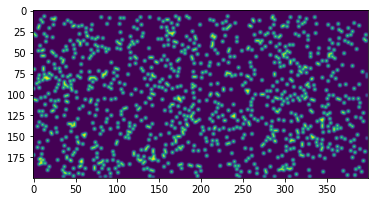

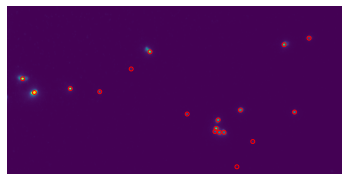

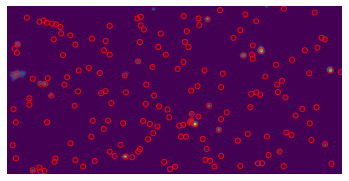

153.65772964266495 0.05584031939780711
2.6325285935364855 0.06657444330683099
172.5897695737402 0.06786480189941464
2.5133503419012766 0.06990687844778933
34.49320395266454 0.015849067293918315
114.28607496566066 0.016846846256794643
114.28607496566066 0.016846846256794643
82.58294961599931 0.02209695009960609
8.906058733438686 0.012774643200984186
169.07835919056592 0.015806091136416223
169.07835919056592 0.015806091136416223
169.07835919056592 0.015806091136416223
169.07835919056592 0.01580609113641554
114.28607496566066 0.016846846256794414
64.58220571395937 0.017086862671056777
64.58220571395937 0.017086862671056777
169.07835919056592 0.01580609113641554
169.07835919056592 0.01580609113641554
159.90100624159462 0.017934264176665656
159.90100624159462 0.017934264176665656
103.51111577772137 0.01725706611916564
103.51111577772137 0.01725706611916564
103.51111577772137 0.01725706611916763
103.51111577772137 0.01725706611916763
103.51111577772137 0.017257066119166088
103.51111577772137

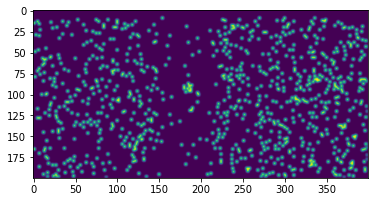

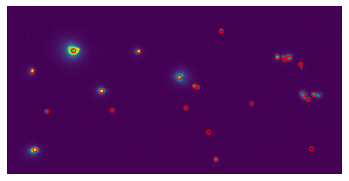

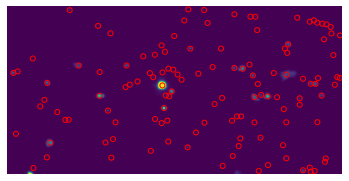

1.4131896166063542 0.006737414666750211
1.4131896166063542 0.00851738757184557
1.4131896166063542 0.009059835561476756
1.5934468501458694 0.01195137372667606
Pos518
 [[109.93900156 106.27583322]
 [ 51.01635345 162.22677574]
 [ 47.27998862  90.9486776 ]
 [142.08621872  70.10524511]
 [ 84.92859577  70.08398637]
 [270.92352126  72.97389094]
 [196.02630062 101.00655714]
 [184.93980252  93.9399447 ]
 [302.96665389 105.2054427 ]
 [280.97664308  73.96152319]
 [215.05118534 167.83782328]
 [ 59.30188679 125.73584906]
 [294.97779546 107.91021356]
 [218.17525773  49.93172967]
 [247.22413793 116.22413793]
 [119.94327177 123.98153034]
 [293.02603868  82.01780586]
 [196.02630062 101.00655714]
 [186.96646604 121.04267548]
 [302.11500615 156.33825338]
 [133.03756061 100.33837457]
 [ 71.77366562 153.97661717]
 [ 69.7331906   81.6019292 ]
 [167.17549359  64.07167583]
 [107.34856762  63.35402637]
 [293.96241046  69.80071831]
 [217.9367221   95.96408864]
 [204.24271731  88.03624509]
 [326.87886413 104.073

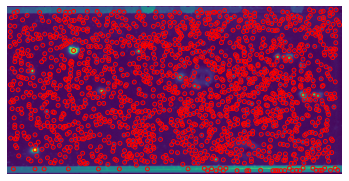

Matched clusters before polywarp:  114
Matched clusters after polywarp:  111
Out of  1618  smFRET peaks and  245  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  45


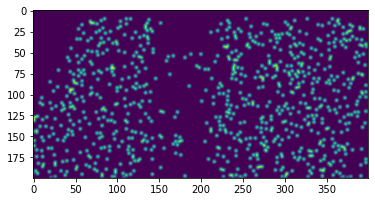

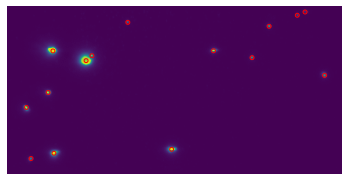

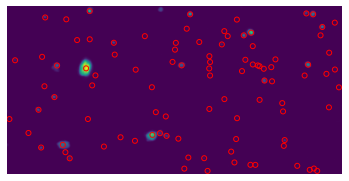

160.88816711278312 0.025955936642935388
152.33063634845323 0.045244933762135536
161.39123341068375 0.04808180336456288
6.146457083942479 0.05451851060143592
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.012510013892146002
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
119.13212449423855 0.016217647012681052
38.63410666712038 0.02251601570554835
112.85483816191147 0.01251001389214598
112.85483816191147 0.01251001389214598
1.2746658899741392 0.019250972730058862
1.2746658899741392 0.019250972730058862
Pos543
 [[ 59.05777778  70.10829932]
 [ 65.93500266 164.90682616]
 [ 55.88243993 107.86229205]
 [ 36.92051421 123.01520913]
 [207.9180014   69.95286266]
 [ 93.72957611  73.50625672]
 [255.94713656  44.93769666]
 [240

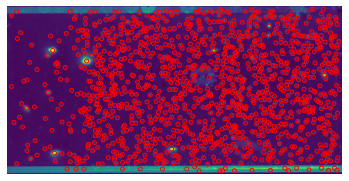

Matched clusters before polywarp:  77
Matched clusters after polywarp:  70
Out of  1259  smFRET peaks and  204  clusters
Percentage of matched smFRET peaks:  5
Percentage of matched clusters:  34


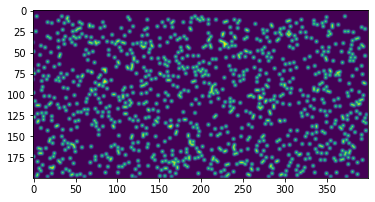

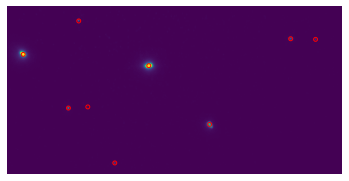

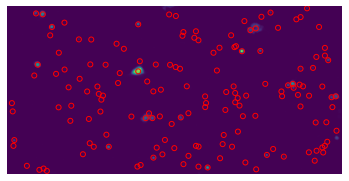

0.611100957638409 0.03258545447928541
134.36795311683625 0.04915873807932904
134.79201767103893 0.05635398840129628
30.870346397914414 0.058552117337781207
24.134154289109333 0.03751096883218044
24.134154289109333 0.03751096883218056
24.134154289109333 0.03751096883218056
25.91704315224291 0.04812976875105841
154.87334189438707 0.02262875392589242
99.99981377494824 0.024265293595469004
11.721934709391165 0.03522785566336049
24.134154289109333 0.03751096883218056
108.23985603069372 0.019901681947442556
108.23985603069372 0.019901681947442556
108.23985603069372 0.019901681947442556
154.87334189438707 0.02262875392589242
108.23985603069372 0.019901681947442556
154.87334189438707 0.02262875392589242
99.99981377494824 0.024265293595469004
167.37194264708614 0.02457224436822435
108.23985603069372 0.019901681947442556
154.87334189438707 0.02262875392589242
99.99981377494824 0.024265293595469004
167.37194264708614 0.02457224436822435
108.23985603069372 0.019901681947442556
154.87334189438707 0

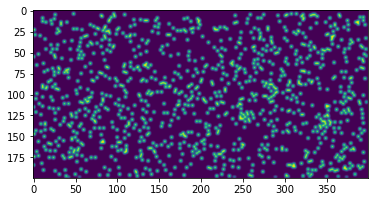

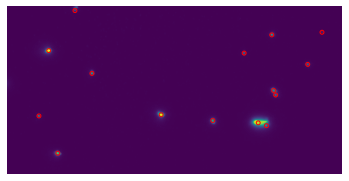

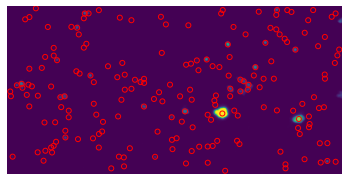

0.8326698404341217 0.020452109365822906
0.8326698404341217 0.045222694829488
0.677391593557986 0.04586602075372724
0.8326698404341217 0.048086298207613794
1.7457851936217061 0.010638473460645392
1.7457851936217061 0.017974324582814272
0.8326698404341217 0.020452109365822868
1.7457851936217061 0.020811213543688683
Pos545
 [[ 59.02463768  63.78985507]
 [162.9302766  119.13772739]
 [ 69.04825737 156.09490617]
 [263.09112218  44.95692939]
 [211.96529415 124.94809499]
 [ 98.97867408  82.03739762]
 [266.10145773  97.81166181]
 [237.84081398  62.92787396]
 [266.10145773  97.81166181]
 [296.03641488  72.12874859]
 [ 82.99505373  24.96332935]
 [256.55109688 127.43398535]
 [307.98118311  42.95507468]
 [ 84.64204131  63.15272657]
 [187.33792755 122.2089027 ]
 [ 92.66049866 157.04036471]
 [288.76314843  49.48779177]
 [234.56122217 127.64443256]
 [124.10883968  84.18369293]
 [290.33685996 100.35048251]
 [263.45126627  66.07742991]
 [292.14668231 104.50303463]
 [321.59320336  76.58643302]
 [108.7895

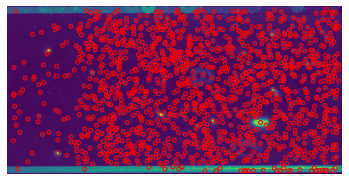

Matched clusters before polywarp:  161
Matched clusters after polywarp:  153
Out of  1319  smFRET peaks and  334  clusters
Percentage of matched smFRET peaks:  11
Percentage of matched clusters:  45


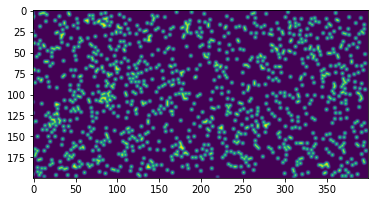

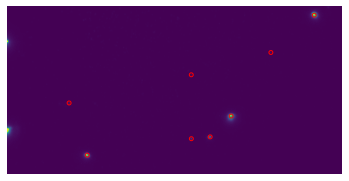

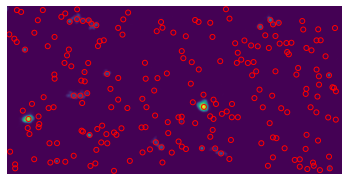

30.504672157242524 0.07600259042438962
171.85634930196628 0.07601248610842622
179.98219176342724 0.08149723241760866
17.467847709525756 0.08344366502376963
107.57802777923062 0.0209692346546588
107.57802777923062 0.0209692346546588
107.57802777923062 0.02096923465465896
83.86140698993111 0.0344289058130392
107.57802777923062 0.02096923465465896
40.059782765760836 0.02920371897329189
60.8280233516198 0.03349909164419221
83.86140698993111 0.0344289058130392
60.8280233516198 0.03349909164419221
122.43925671286436 0.03914524556898655
131.92531733155639 0.03918092413719721
131.92531733155639 0.03918092413719747
16.350700544839103 0.030794620889226028
60.8280233516198 0.03349909164419221
122.43925671286436 0.03914524556898655
131.92531733155639 0.03918092413719721
16.350700544839103 0.030794620889226028
88.21828536324348 0.03643712945384542
88.21828536324348 0.036437129453845446
177.52101089260728 0.03664729763074117
16.350700544839103 0.030794620889226028
60.8280233516198 0.0334990916441924

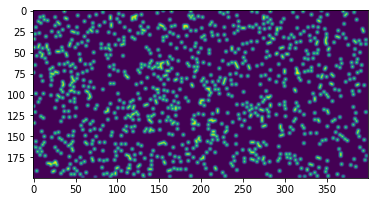

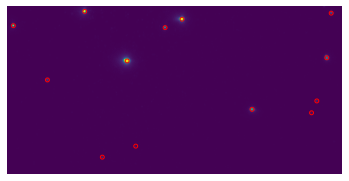

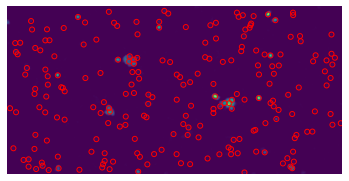

0.986994429831877 0.0053992337039686375
1.1653686984645264 0.009661643971086613
0.986994429831877 0.009788218471808212
0.986994429831877 0.010322987278527254
Pos547
 [[ 92.54782609  18.66956522]
 [131.96551724  63.14505423]
 [181.00577534  24.89792088]
 [248.01709574 107.03429826]
 [314.06322657  58.11103203]
 [319.94666878  15.98464947]
 [ 59.97322226  81.82133294]
 [140.73615635 141.11074919]
 [300.06925469 108.98916423]
 [117.70198958  27.42636053]
 [156.38509708  72.89195509]
 [206.74962623  34.84234399]
 [270.50950526 117.54017519]
 [339.03114929  70.57781542]
 [343.20611316  29.7935045 ]
 [ 83.37391185  89.99867599]
 [163.95661434 150.82259671]
 [324.93280349 120.89374146]]
Automatically matched beads:  9


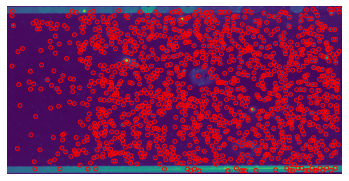

Matched clusters before polywarp:  140
Matched clusters after polywarp:  138
Out of  1313  smFRET peaks and  301  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  45


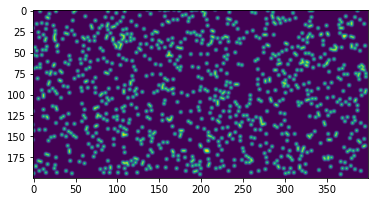

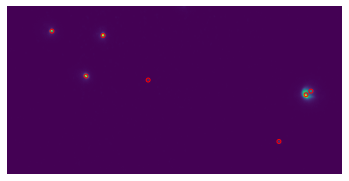

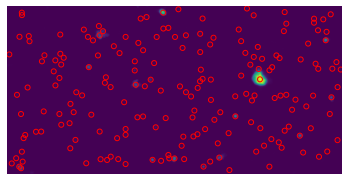

155.8047390660771 0.06317437272709527
147.5673113323861 0.07071398655203953
36.67595662596734 0.08221265817183056
153.5553149863319 0.08860876870849715
52.315795769569554 0.05341357378338246
52.315795769569554 0.05341357378338246
52.315795769569554 0.05341357378338266
119.00276934414646 0.05986676647104232
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.030263929923036954
69.32178425908936 0.030263929923036954
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.030263929923036954
69.32178425908936 0.030263929923036954
69.32178425908936 0.03026392992303691
69.32178425908936 0.03026392992303691
69.32178425908936 0.030263929923036954
69.32178425908936 0.030263929923036954
168.20849892269842 0.03158686753321477
168.20849892269842 0.03158686753321477


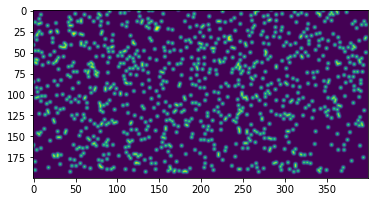

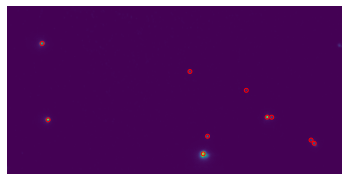

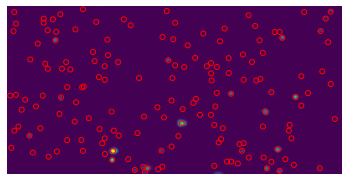

25.92208249985592 0.030558709591171667
155.846788048517 0.03536966540227341
26.56540951589292 0.03673487501505936
156.490115064554 0.04605827896633302
102.44221786297821 0.020076468209366358
102.44221786297821 0.020076468209366358
102.44221786297821 0.020076468209366774
102.44221786297821 0.020076468209366774
102.44221786297821 0.020076468209366358
102.44221786297821 0.020076468209366358
102.44221786297821 0.020076468209366774
47.13415441954465 0.023131512674589603
134.13745293263554 0.0186262859665394
134.13745293263554 0.0186262859665394
98.78877763504731 0.019380269293125637
98.78877763504731 0.019380269293125637
134.13745293263554 0.0186262859665394
98.78877763504731 0.019380269293125637
98.78877763504731 0.019380269293125637
98.78877763504731 0.019380269293125637
134.13745293263554 0.0186262859665394
49.18451728240488 0.024939399716435023
49.18451728240488 0.024939399716435023
30.54493362948375 0.0402586060765002
134.13745293263554 0.0186262859665394
98.78877763504731 0.0193802692

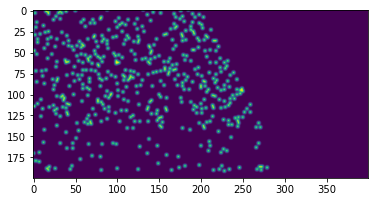

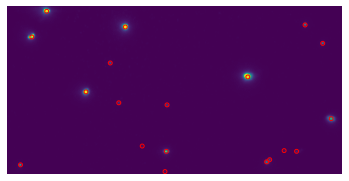

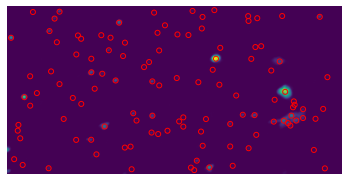

161.613387473059 0.042197106270693265
144.43080233848448 0.04590601846259113
161.05444412011286 0.05169338653573053
158.43729050749766 0.05488540415776516
80.23739796384315 0.021941453240131005
27.86211428560016 0.027321486050046362
27.86211428560016 0.027321486050046362
80.23739796384315 0.03396853132853539
27.067097038921332 0.011743826466035473
0.8843783777810174 0.016597030835318757
0.8843783777810174 0.016597030835318757
0.8843783777810174 0.01659703083531879
Pos550
 [[133.20570143  18.91397224]
 [ 62.02283105   5.80974125]
 [100.07131636  78.24818527]
 [248.92230359  62.02755454]
 [ 50.05509479  28.99229858]
 [173.00504959 130.07989179]
 [298.25225225  13.59459459]
 [265.93873979 139.92065344]
 [120.92680514  51.9495549 ]
 [172.89992099  89.08427706]
 [265.93873979 139.92065344]
 [129.05727319  88.01199527]
 [295.02042939 129.37349883]
 [171.96696429 150.22321429]
 [150.09268454 127.15458457]
 [280.9430727  128.93106996]
 [154.77106688  41.79236868]
 [ 82.9377191   27.20271828]
 

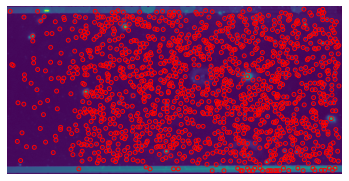

Matched clusters before polywarp:  88
Matched clusters after polywarp:  87
Out of  1324  smFRET peaks and  141  clusters
Percentage of matched smFRET peaks:  6
Percentage of matched clusters:  61


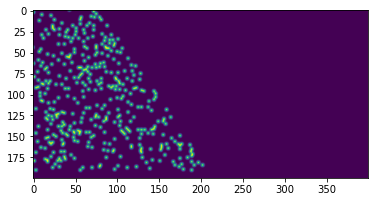

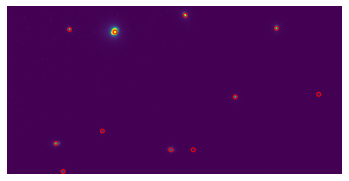

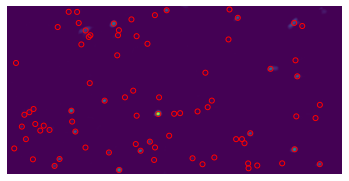

1.2529495936644444 0.009577740169071945
1.2529495936644444 0.010064337761988071
0.9759286975084691 0.010226814860484174
1.2529495936644444 0.011582772576515734
Pos577
 [[126.97480231  20.06371019]
 [189.99819535   4.13264155]
 [ 84.94306931  19.3019802 ]
 [274.99779304  13.13462482]
 [ 76.19533333 124.15122222]
 [236.29761905  78.71428571]
 [179.98113065 128.00722254]
 [ 80.93918312 149.04308797]
 [115.92200604 112.09090909]
 [198.94871795 127.77777778]
 [314.09542118  74.10450891]
 [145.41110044  46.39173125]
 [209.72696209  31.26031691]
 [103.8706571   43.93584185]
 [293.07390716  43.50995507]
 [ 90.95860579 148.08247848]
 [255.11995868 106.12026419]
 [196.15322648 154.39423446]
 [ 97.46280647 173.83083634]
 [133.50426664 136.97847546]
 [216.61826982 154.39495872]
 [331.60375562 103.98845776]]
Automatically matched beads:  11


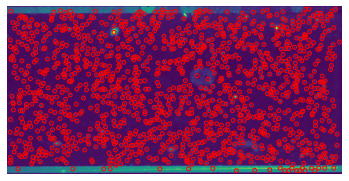

Matched clusters before polywarp:  59
Matched clusters after polywarp:  60
Out of  1344  smFRET peaks and  132  clusters
Percentage of matched smFRET peaks:  4
Percentage of matched clusters:  45


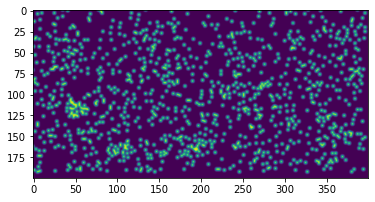

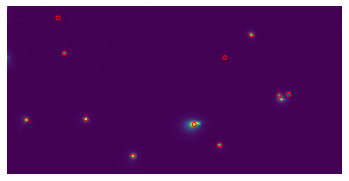

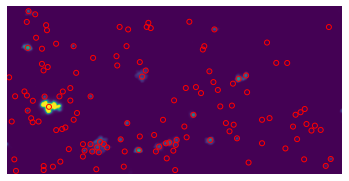

0.4858138241064119 0.02411511454772334
4.04194472287932 0.02460632483948763
1.6890062414430398 0.025435812033690382
3.6654233581933173 0.02643906095330943
1.6890062414430398 0.025435812033690167
156.41452789183924 0.02654106175558432
0.4858138241064119 0.030042264081873733
0.4858138241064119 0.030042264081873733
129.5582517459402 0.013014706170929967
151.48434109592935 0.023922471864042442
151.48434109592935 0.023922471864042553
151.48434109592935 0.023922471864042553
157.83379131956377 0.015869711390125843
151.48434109592935 0.023922471864042553
0.9036652950761014 0.024982224381446493
3.6760393631792594 0.027460895241178986
151.48434109592935 0.023922471864042553
178.1332935465646 0.024425540432476706
153.9435479387178 0.029332693767303825
1.5952376254480696 0.03204974197807135
178.1332935465646 0.024425540432476706
10.88895917239208 0.03304613498499086
74.57394049542734 0.033989136924227885
55.74855687567314 0.03563219614668371
1.5952376254480696 0.03204974197807135
10.88895917239208

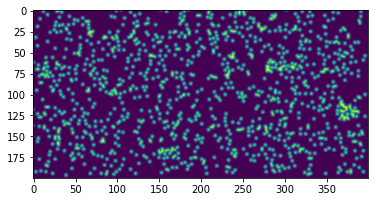

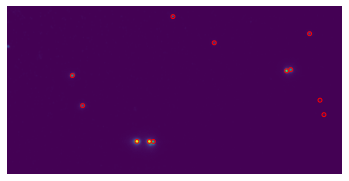

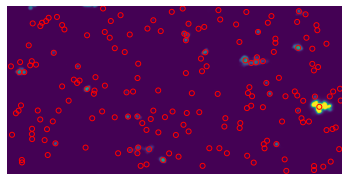

0.6158041215569507 0.01272237635334753
0.7715553733390615 0.03173952180887301
175.283261470502 0.065142960674642
174.9732190799253 0.06716470370493736
Pos579
 [[143.88619325 131.09537693]
 [155.01494551 130.99898806]
 [284.1567199   63.96069176]
 [ 83.9309746   71.16670284]
 [155.01494551 130.99898806]
 [284.1567199   63.96069176]
 [174.09629045  16.04498816]
 [ 95.0149477   98.12360248]
 [299.11744387  30.02047866]
 [213.01184416  39.99220779]
 [313.11976854 103.87148432]
 [309.08722542  90.95180209]
 [165.09503438 146.50298486]
 [176.49631181 146.5854824 ]
 [302.31561576  82.4431281 ]
 [106.19888803  86.07484776]
 [180.06784429 146.62953573]
 [306.02146205  81.29272091]
 [198.42844545  32.43143848]
 [115.53105788 113.58909041]
 [323.37448047  48.51100141]
 [236.11119445  56.52400399]
 [336.26939504 122.65504607]
 [332.69678262 109.38141929]]
Automatically matched beads:  12


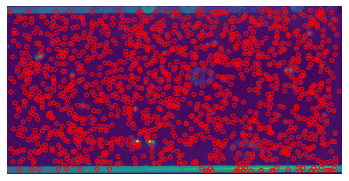

Matched clusters before polywarp:  178
Matched clusters after polywarp:  174
Out of  1343  smFRET peaks and  320  clusters
Percentage of matched smFRET peaks:  12
Percentage of matched clusters:  54


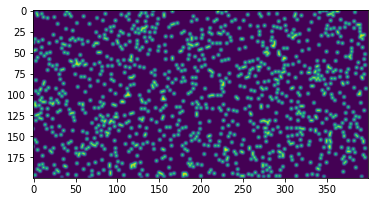

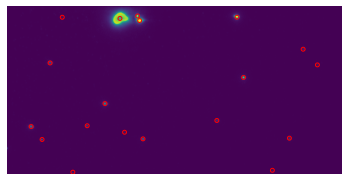

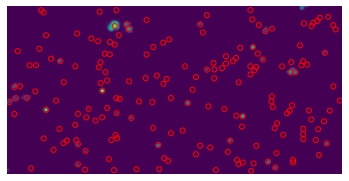

0.07462046120073759 0.023134917325526246
0.07462046120073759 0.02351134020335223
0.2699450158864796 0.02434854059778978
0.07462046120073759 0.03170099345004951
1.0705804505236607 0.009278719308138207
103.74896777100763 0.014136880279795731
103.74896777100763 0.014136880279795731
0.9771422464337067 0.014158933829486773
Pos580
 [[230.00234624  20.90363667]
 [128.03627482  22.9793598 ]
 [238.1849828   75.09613439]
 [141.9935312   21.0216895 ]
 [113.06228388 100.12516542]
 [ 46.00909699 123.04209588]
 [147.88426454 132.82079057]
 [ 62.85812779  64.89784424]
 [ 96.82715376 121.86041439]
 [280.96972789 130.90969388]
 [215.09564447 114.97069479]
 [293.03206981  48.109128  ]
 [304.83341039  62.96085683]
 [ 84.0901789  164.22654253]
 [130.23824959 126.99976846]
 [265.84417917 159.78037186]
 [257.01603406  33.18257996]
 [149.91456678  33.96593632]
 [262.83836943  88.31943324]
 [166.09693891  31.74852177]
 [135.95202379 111.80940945]
 [ 68.3148921  132.55608312]
 [170.63438974 144.21568135]
 [ 85

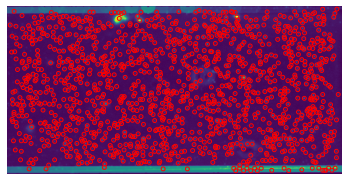

Matched clusters before polywarp:  197
Matched clusters after polywarp:  196
Out of  1319  smFRET peaks and  378  clusters
Percentage of matched smFRET peaks:  14
Percentage of matched clusters:  51


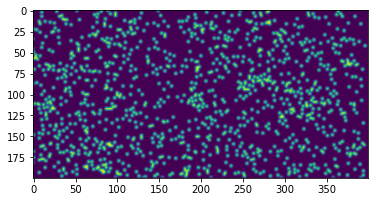

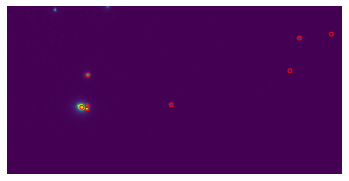

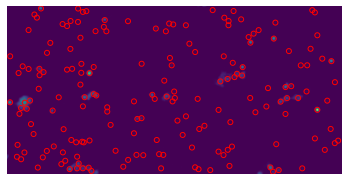

1.2899732682680167 0.008644571355005307
5.51050154309116 0.04668356859312165
5.537956592224382 0.04866740310221743
10.173308319460883 0.04903095398905207
Pos581
 [[ 92.01445016 108.00404115]
 [ 98.01076171  79.18745081]
 [290.10281503  42.81877492]
 [172.92565056 105.07265968]
 [280.82324752  72.05750585]
 [317.99405802  37.96924152]
 [114.74220092 115.13587707]
 [120.50103381  85.53896028]
 [313.88825364  52.46078289]
 [196.54483136 113.11875232]
 [305.31381207  82.34074302]
 [343.17003347  48.98583633]]
Automatically matched beads:  6


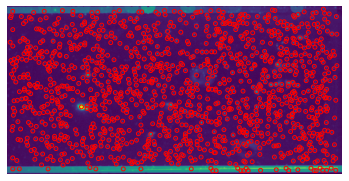

Matched clusters before polywarp:  178
Matched clusters after polywarp:  174
Out of  1255  smFRET peaks and  344  clusters
Percentage of matched smFRET peaks:  13
Percentage of matched clusters:  50


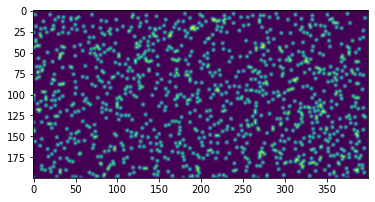

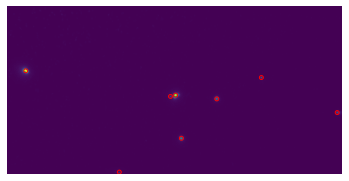

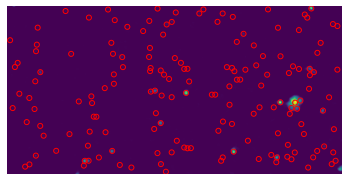

1.0295810012761084 0.011788613170417418
159.5179692893178 0.056536597299433146
155.25134545219782 0.06756388068206927
176.0965433589559 0.07787341749483251
Pos582
 [[ 39.10212278  78.05393001]
 [176.02922454 100.14149306]
 [182.92885541 138.9047918 ]
 [213.19335724 102.9222369 ]
 [325.90110694 114.05992132]
 [124.93364929 172.14980424]
 [171.09672506 101.2916984 ]
 [ 63.5939301   81.56746354]
 [200.60321752 104.34608429]
 [205.78642773 143.76984565]
 [238.28129999 107.87981449]
 [348.39241351 120.75858013]
 [148.87084841 174.56531258]
 [195.93011219 105.46811774]]
Automatically matched beads:  7


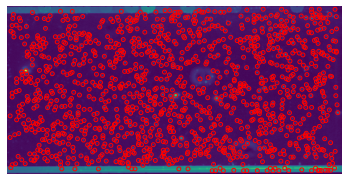

Matched clusters before polywarp:  159
Matched clusters after polywarp:  154
Out of  1232  smFRET peaks and  319  clusters
Percentage of matched smFRET peaks:  12
Percentage of matched clusters:  48


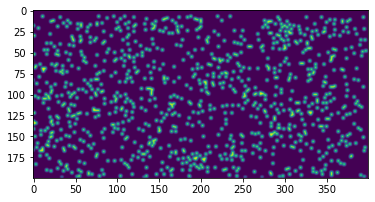

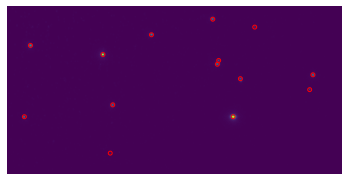

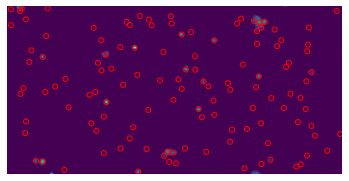

1.0246437138428075 0.0025000196044862527
1.0246437138428075 0.002693808593699705
1.0246437138428075 0.0027574638648432018
1.0246437138428075 0.0038225361348666895
Pos583
 [[107.89915966  66.90876351]
 [228.07572732 122.06374786]
 [ 41.97549592  59.99183197]
 [152.04273103  48.96299775]
 [213.03989867  74.86827106]
 [300.0855526   83.08089214]
 [207.85152339  33.059219  ]
 [118.0485495  113.86312431]
 [213.03989867  74.86827106]
 [234.10559541  89.10416069]
 [296.83018868  96.11590296]
 [246.96482314  40.05042017]
 [134.29986658  66.92092163]
 [253.16218302 124.199972  ]
 [ 67.96073044  58.35339764]
 [178.71109078  49.00733251]
 [238.9119924   76.19139192]
 [326.31271794  86.12924487]
 [234.86657285  34.94137721]
 [143.0784216  113.0046924 ]
 [240.12516983  72.71916698]
 [259.93333116  89.46744009]
 [323.2877224   99.71413544]
 [273.19987969  42.28470665]]
Automatically matched beads:  12


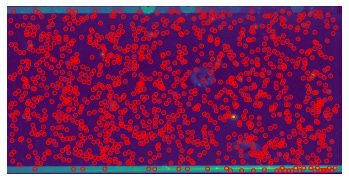

Matched clusters before polywarp:  151
Matched clusters after polywarp:  149
Out of  1208  smFRET peaks and  307  clusters
Percentage of matched smFRET peaks:  12
Percentage of matched clusters:  48


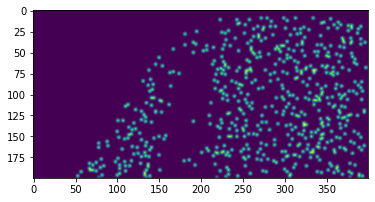

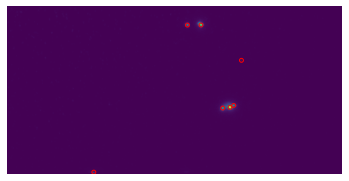

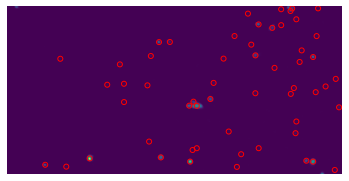

1.8601654091967461 0.03317031464357707
27.60919747127258 0.04935317392194248
27.60919747127258 0.05191869962644739
27.60919747127258 0.0870309190868564
3.519803528076592 0.041372100496010776
3.519803528076592 0.041372100496010776
3.519803528076592 0.041372100496010776
27.60919747127258 0.04935317392194248
3.519803528076592 0.041372100496010776
3.519803528076592 0.041372100496010776
0.884955420432066 0.050724278789404185
18.987772445505076 0.05585930191669313
68.80617201471986 0.029187051204742076
71.44102012236438 0.03088060006425672
71.33005986699433 0.042332069190885745
18.987772445505076 0.05585930191669313
3.519803528076592 0.041372100496010755
18.987772445505076 0.05585930191669313
179.01638239323213 0.062361387342062986
44.691473166120666 0.06742682609588471
44.691473166120666 0.06742682609588471
100.6087741877122 0.07091307459623594
18.987772445505076 0.07968413539867814
70.35271309604234 0.08046091023705156
44.691473166120666 0.06742682609588471
165.51746066940436 0.09821930443

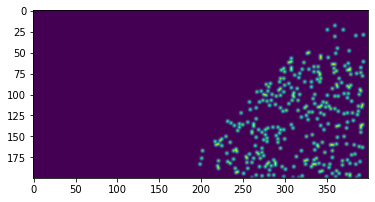

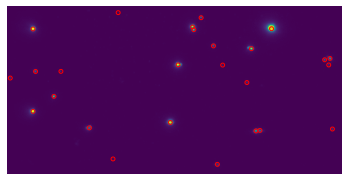

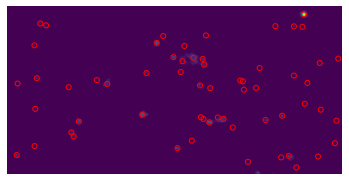

178.2335219951453 0.060366855401486515
128.060776936031 0.06312726725082668
178.2335219951453 0.07136345058797387
56.39239226861017 0.0837625225988327
0.2820764103042671 0.005390168880938348
0.2820764103042671 0.005390168880938348
1.1682200735849377 0.009482965257643871
1.1682200735849377 0.009482965257643871
Pos609
 [[ 33.01612903 121.87419355]
 [ 32.          46.01250977]
 [165.92743807  79.09049859]
 [161.04716996 128.94538298]
 [233.07365269  62.20688623]
 [178.1266475   43.02983465]
 [178.1266475   43.02983465]
 [301.07476636  73.02803738]
 [185.86890244  34.87042683]
 [ 85.03562253 136.96966403]
 [ 34.9210004   85.22747122]
 [198.08965383  60.10540646]
 [301.07476636  73.02803738]
 [240.97865065 137.9836414 ]
 [202.93337218 168.85120435]
 [308.14171657 135.14251497]
 [229.82014388  93.81438849]
 [ 11.90909091  91.68899522]
 [301.07476636  73.02803738]
 [206.85        77.90869565]
 [ 70.0948069  118.68282009]
 [ 70.36965279  43.30573782]
 [202.99475165  76.62373015]
 [195.67353341

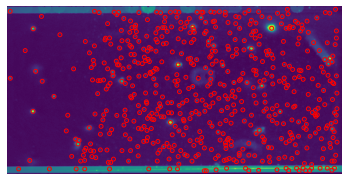

Matched clusters before polywarp:  15
Matched clusters after polywarp:  14
Out of  577  smFRET peaks and  86  clusters
Percentage of matched smFRET peaks:  2
Percentage of matched clusters:  16


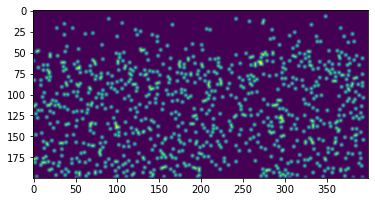

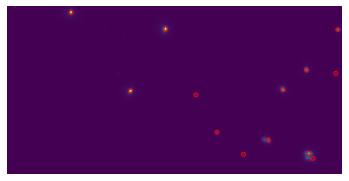

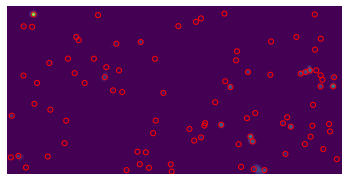

9.633953527618672 0.03183250258463365
0.6864605355998507 0.0477978611970152
9.473480504295031 0.06626931402705048
101.03357357257802 0.0666398636274229
41.02847254392612 0.015241463709784122
41.02847254392612 0.015241463709784122
159.22588591026712 0.025499697229181068
41.60326802899561 0.026880207645964806
0.9137467950584645 0.011934888634359006
0.9137467950584645 0.011934888634359006
0.9137467950584645 0.011934888634359006
0.9137467950584645 0.011934888634359006
Pos610
 [[125.99214847  99.80442541]
 [159.04951943  42.04993732]
 [290.1524857  155.04417042]
 [266.28363456  95.90672609]
 [314.73595506  41.45505618]
 [287.09293905  77.97988332]
 [255.12997118 140.93717579]
 [186.10426929 102.82922824]
 [313.8819788   81.1639576 ]
 [231.12786762 156.02933434]
 [159.40611174 100.46834698]
 [191.79159117  43.75332325]
 [322.43864102 157.93827654]
 [298.81728387  99.73995171]
 [349.1638475   44.94463881]
 [320.38310447  81.7867714 ]
 [285.35944622 145.68420904]
 [219.16409202 104.20159834]
 

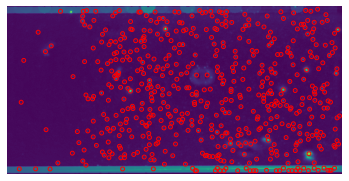

Matched clusters before polywarp:  78
Matched clusters after polywarp:  74
Out of  547  smFRET peaks and  242  clusters
Percentage of matched smFRET peaks:  13
Percentage of matched clusters:  30


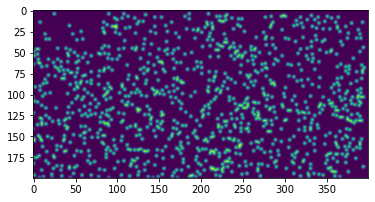

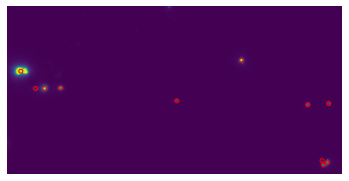

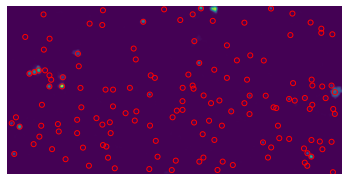

0.14570857573043222 0.016067670043616724
0.7974787617116569 0.01611907259041829
1.0061386235696064 0.019065108763920143
27.641683934892836 0.026873812883380973
Pos611
 [[273.92        63.96      ]
 [ 37.13309388  75.93529849]
 [ 65.09803502  95.05165766]
 [362.87034137 178.9642969 ]
 [343.04842615 112.02905569]
 [ 49.89114266  95.08823529]
 [358.17143776 174.90929559]
 [261.06911485  72.68471604]
 [ 59.06528918  81.90931947]
 [ 80.92329646  97.82131604]
 [335.53331647 168.58191702]
 [321.43176811 113.58495646]
 [ 72.58259755  97.78503442]
 [334.3638694  164.67100755]]
Automatically matched beads:  7


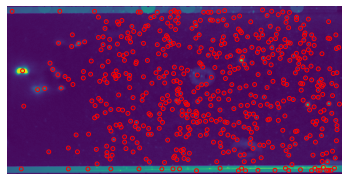

Matched clusters before polywarp:  70
Matched clusters after polywarp:  69
Out of  538  smFRET peaks and  302  clusters
Percentage of matched smFRET peaks:  12
Percentage of matched clusters:  22


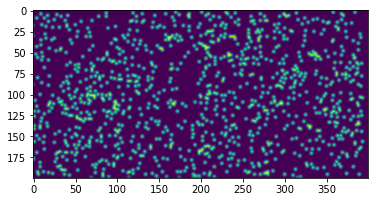

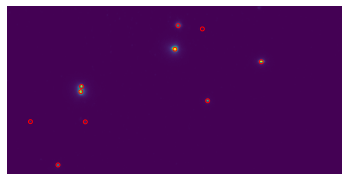

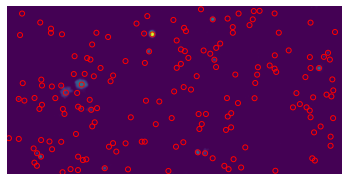

1.370146379350481 0.014928916919654481
2.9543484513888942 0.029900389355822243
1.384849969489992 0.04239651345164675
2.555040058720975 0.04560850759465282
Pos612
 [[169.02150056  53.2944009 ]
 [246.97834126  63.1856841 ]
 [ 88.47134576  92.81257489]
 [198.94205052 101.10698366]
 [173.02279531  32.92849919]
 [200.14123448  62.30458153]
 [279.06107587  74.05116841]
 [113.8921318  100.85290763]
 [229.9301468  109.56276059]
 [203.12544378  40.75475469]]
Automatically matched beads:  5


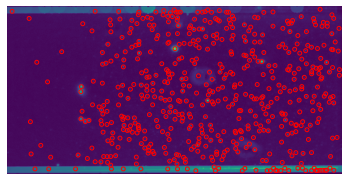

Matched clusters before polywarp:  95
Matched clusters after polywarp:  96
Out of  541  smFRET peaks and  332  clusters
Percentage of matched smFRET peaks:  17
Percentage of matched clusters:  28


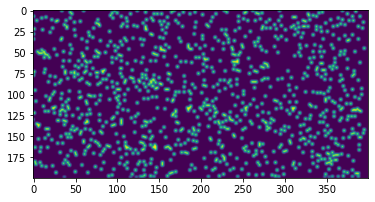

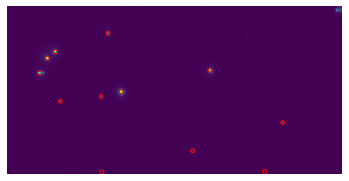

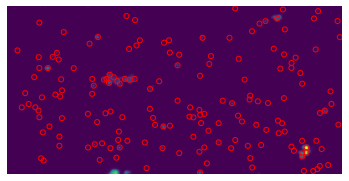

0.29376916993006846 0.023833027099555305
177.30073872570324 0.04791667661353283
173.5802883230404 0.055252028187484016
176.6652610347181 0.06239099567883331
133.14840574838192 0.02365862520070604
133.14840574838192 0.023658625200706156
0.29376916993006846 0.023833027099555305
16.145279370659352 0.03127399378262109
133.14840574838192 0.02365862520070604
133.14840574838192 0.02365862520070604
133.14840574838192 0.02365862520070604
133.14840574838192 0.023658625200706156
120.57871701784042 0.02233978949178924
133.14840574838192 0.02365862520070604
133.14840574838192 0.02365862520070604
133.14840574838192 0.023658625200706156
84.72072319617719 0.02187928079297852
133.14840574838192 0.023658625200706156
153.57654253870308 0.02395731319811169
153.57654253870308 0.02395731319811169
133.14840574838192 0.023658625200706156
153.57654253870308 0.02395731319811169
116.77133667334793 0.028004521659290415
133.21141190829135 0.0284319290527393
153.57654253870308 0.02395731319811169
116.77133667334793

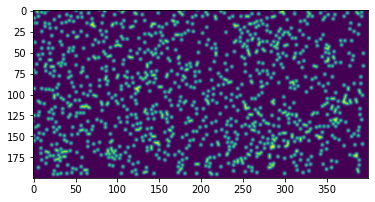

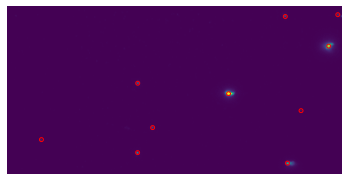

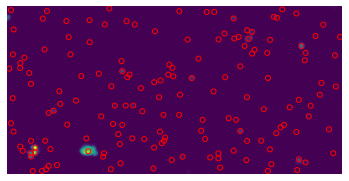

178.21049134568602 0.08558302122165923
16.180642474723236 0.09167888340659879
95.34463414896177 0.1013582053729238
11.440621559679307 0.10944353457785963
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519818
90.50255708864502 0.02917418484661524
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519818
1.8906717210736825 0.021154778884519818
29.219852161002308 0.022097370674506272
152.7993148697188 0.020987125097285977
152.7993148697188 0.02098712509728681
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519818
152.7993148697188 0.020987125097285977
152.7993148697188 0.02098712509728681
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519818
1.8906717210736825 0.021154778884519283
1.8906717210736825 0.021154778884519818
1.8906717210736825 0.021154778884519818
135.77152411308558 0.021200875758965478
1.8906717210736825 0.021154778884519283
1.890671721073

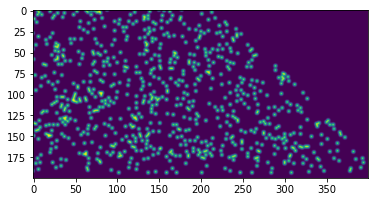

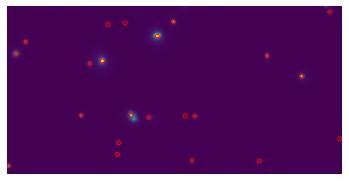

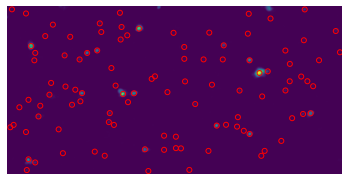

0.940087511886173 0.017262843141451233
0.940087511886173 0.026926840710759726
144.0372389997674 0.029029220557219508
0.940087511886173 0.030812216633553775
Pos615
 [[157.03990133  26.04790576]
 [107.03576487  52.12924929]
 [289.0139528   63.87962001]
 [ 21.93838863 149.59241706]
 [ 88.95022265 103.08889949]
 [258.17710843  46.05322158]
 [ 27.99817911  46.85948248]
 [190.95686275 101.9372549 ]
 [ 95.03300448  55.09399103]
 [150.99614382 103.30776446]
 [122.04769351 126.99374511]
 [110.10750853  19.78327645]
 [249.84814106 141.91484418]
 [120.93351425 137.75169607]
 [183.99886278  50.2723251 ]
 [133.78277418  72.83657941]
 [316.0343911   87.37949462]
 [ 47.71570129 168.33889917]
 [114.28821955 122.47740315]
 [284.49540059  68.5927124 ]
 [ 54.8381771   66.03876318]
 [218.01695672 123.42530648]
 [122.3156987   75.19506808]
 [176.05219616 124.50979206]
 [148.47334984 147.6035846 ]
 [139.02854056  39.44079659]
 [276.88811363 164.96950841]
 [147.14292722 158.36187853]]
Automatically matched b

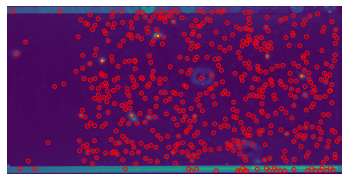

Matched clusters before polywarp:  64
Matched clusters after polywarp:  60
Out of  550  smFRET peaks and  159  clusters
Percentage of matched smFRET peaks:  10
Percentage of matched clusters:  37


In [330]:
# MAIN CYCLE
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
#     path1 = os.path.join(beads_dir,pos+'.tiff')
    path1 = os.path.join(beads_dir,pos,'A_Red','img_000000000.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        if len(img_beads_F.shape) == 3:
            img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - si.restoration.rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue

        #print(image_array)

        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)  

        # Calculating the shift between the FASTQ and cluster images using cross-correlation
        shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
        shift = shift[0]
        # Translation of the FASTQ sequences in the FOV to match the cluster image
        x_FQ = np.subtract(x_FQ,X_c-shift[1])
        y_FQ = np.subtract(y_FQ,Y_c-shift[0])
        max_image = Image.fromarray(image_array_max_t)
        max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
        fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
        fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
        fig, ax = plt.subplots()
        ax.imshow(fastq_image1)
        plt.show()

        # Selecting the library sequences for further analysis
        idx = [i for i,x in enumerate(seq_t) if library_seq in x]
        x_FQ = [x_FQ[i] for i in idx]
        y_FQ = [y_FQ[i] for i in idx]
        seq_t = [seq_t[i] for i in idx]

        # Calculating the transformation based on automatically-selected beads
        movie_centers = blob_detection(
            np.asarray(img_beads_F),
            min_sigma=1,
            max_sigma=10,
            threshold=0.01
        )

        seq_centers = blob_detection(
            image_array_seq_t,
            min_sigma=1,
            max_sigma=10,
            threshold=0.0001, # Was 0.00001 for 19/07/2022
         )
        
        a = run(seq_centers, apriori_tr(movie_centers))
    
        uknmatchstars_coord = []
        refmatchstars_coord = []
        if len(a[0].refmatchstars) >= 3:
            for i in range (len(a[0].refmatchstars)):
                uknmatchstars_coord.append(a[0].uknmatchstars[i].x)
                uknmatchstars_coord.append(a[0].uknmatchstars[i].y)
                refmatchstars_coord.append(a[0].refmatchstars[i].x)
                refmatchstars_coord.append(a[0].refmatchstars[i].y)

            refmatchstars_coord = np.array(refmatchstars_coord)
            uknmatchstars_coord = np.array(uknmatchstars_coord)

            refmatchstars_coord = np.reshape ( refmatchstars_coord, ( int(len(a[0].refmatchstars)), 2 ) )
            uknmatchstars_coord = np.reshape ( uknmatchstars_coord, ( int(len(a[0].uknmatchstars)), 2 ) )
            result_coord = np.concatenate ((refmatchstars_coord,uknmatchstars_coord ), axis = 0)
            print (pos+"\n", result_coord )
            np.save (os.path.join(pos_direct, pos + "_matching_beads"), result_coord)
        else:
            log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                           transformation estimate based on manually selected beads\n""")
            continue
#         res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
#         movie_centers1 = movie_centers[idx[np.where(res != inf)]]
#         seq_centers1 = seq_centers[np.where(res != inf)]
        movie_centers1 = apriori_tr_inv(uknmatchstars_coord)
        seq_centers1 = refmatchstars_coord
        print('Automatically matched beads: ',seq_centers1.shape[0])
        rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
        # Reading the smFRET movie
#             path_smFRET_file = os.path.join(path_smFRET,pos+'.tiff')
        path_smFRET_file = os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff')
        if not os.path.exists(path_smFRET_file):
            continue

        img_smFRET = io.imread(path_smFRET_file)

        # Averaging the first 10 frames to select peaks
        img_t = np.mean(img_smFRET[0:10,::], axis = 0)
        img_t = img_t.astype("ushort")
        rb_rad = 10

        red = img_t[256:,:]
        green = img_t[:256,:]
        red = red - si.restoration.rolling_ball(red, radius=rb_rad)
        green = green - si.restoration.rolling_ball(green, radius=rb_rad)
        green = transform.warp(green,tr_R2G, preserve_range = True)
        combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
        fig, ax = plt.subplots()
        ax.imshow(combined)
        blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
        CM = []
        r = 3
        [h,w] = red.shape
        n_frames = img_smFRET.shape[0]

        for i, blob in enumerate(blobs_log):
            x, y, d = blob
            if x>r and x<(h-r) and y>r and y<(w-r):
                temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                CM.append(np.flip(np.add(temp, [x-r,y-r])))

                c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                ax.add_patch(c)
        ax.set_axis_off()
        plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
        plt.show()


        smFRET_centers = np.array(CM)
        FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
        res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 4)
        movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
        seq_centers1 = FQ_centers[np.where(res != inf)]

        if seq_centers1.shape[0]<4:
            print('Not enough smFRET peaks (<4)')
            log_file.write('Not enough smFRET peaks (<4)')
            continue

        tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
        tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
        np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
        np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
        log_file.write('Matched clusters before polywarp: ' + str(seq_centers1.shape[0])+'\n')
        print('Matched clusters before polywarp: ',seq_centers1.shape[0])

        res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 4) # Was 4 for 19/07/2022
        centers_matched = smFRET_centers[idx[np.where(res != inf)]]
        idx_t = np.where(res != inf)
        seq_matched = [seq_t[i] for i in idx_t[0]]
        FQ_centers_matched = FQ_centers[idx_t]


        centers_red = centers_matched
        centers_green = tr_R2G(centers_matched)
        r = 3
        # Weed out positions that are too close to the edge
        idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                         (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
        centers_red = centers_red [idx_t]
        centers_green = centers_green [idx_t]
        seq_matched = [seq_matched[i] for i in idx_t[0]]

        matched_sequences.append(seq_matched)
        matched_centers_red.append(centers_red)
        matched_centers_green.append(centers_green)
        good_pos.append(pos)
        log_file.write('Matched clusters after polywarp: ' + str(len(seq_matched))+'\n')
        log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
        log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
        log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
        print('Matched clusters after polywarp: ',len(seq_matched))
        print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
        print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
        print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
        # Saving transformed bead and molecule images for QC
        img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
        img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
        img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
        img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
        centers_red_tfd = tr(centers_red)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))

        centers_red_tfd = tr(smFRET_centers)
        img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))

        img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))

        img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
        img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [299]:
idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
x_FQ = [x_coord[i] for i in idx]
y_FQ = [y_coord[i] for i in idx]
seq_t = [sequence[i] for i in idx]
print(len(seq_t))


# Selecting the library sequences for further analysis
idx = [i for i,x in enumerate(seq_t) if library_seq in x]
x_FQ = [x_FQ[i] for i in idx]
y_FQ = [y_FQ[i] for i in idx]
seq_t = [seq_t[i] for i in idx]
print(len(seq_t))

839
212


In [169]:
cv2.destroyAllWindows()


In [289]:
print(uknmatchstars_coord
     )
print(refmatchstars_coord)
print(apriori_tr_inv(uknmatchstars_coord))
rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)

print(rough_tr1.params)

[[ 78.88382524  30.3282569 ]
 [ 96.12348196  26.01102873]
 [148.97664712 146.62180215]
 [164.58163242 122.65675114]
 [138.84426975 142.43887848]
 [339.82425819 146.46740126]
 [270.01315275  99.05299786]
 [ 73.09175283 139.06518161]
 [266.78297471 134.92005379]]
[[ 72.89899142  65.00466657]
 [ 87.05277384  61.08197713]
 [142.95605859 180.09675988]
 [157.92808049 157.11873693]
 [131.95997482 177.0008095 ]
 [333.88392776 179.94918804]
 [262.01930215 130.96473645]
 [ 66.94482759 174.02681992]
 [258.94775661 166.13398894]]
[[ 53.18321097  12.25245476]
 [ 81.97068069   4.93855465]
 [170.99279527 206.20967359]
 [196.93587118 166.06825331]
 [154.03489625 199.27683764]
 [489.95034085 204.85972367]
 [373.00566252 126.01673205]
 [ 44.12519848 194.01466214]
 [367.81236128 185.97884943]]
[[ 5.96868704e-01  4.42700340e-03  3.95201532e+01]
 [-4.42700340e-03  5.96868704e-01  5.82478600e+01]
 [ 0.00000000e+00  0.00000000e+00  1.00000000e+00]]


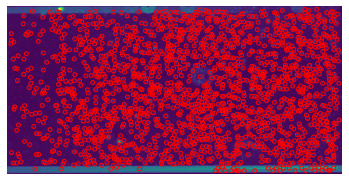

In [291]:
fig, ax = plt.subplots()
ax.imshow(combined)
blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=1000) # Was 1000 for 19/07/2022
#             Was 300 for 06/09/2022
CM = []
r = 3
[h,w] = red.shape
n_frames = img_smFRET.shape[0]

for i, blob in enumerate(blobs_log):
    x, y, d = blob
    if x>r and x<(h-r) and y>r and y<(w-r):
        temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
        CM.append(np.flip(np.add(temp, [x-r,y-r])))

        c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
        ax.add_patch(c)
ax.set_axis_off()
plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
plt.show()

In [300]:
smFRET_centers = np.array(CM)
FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
seq_centers1 = FQ_centers[np.where(res != inf)]
print(FQ_centers)


[[1351.7 2237.9]
 [1351.5 2208.6]
 [1347.8 2130. ]
 [1346.9 2176.5]
 [1346.8 2294.6]
 [1343.5 2193.5]
 [1342.3 2223.4]
 [1336.3 2184.5]
 [1334.5 2280.7]
 [1327.4 2145.5]
 [1324.3 2275.3]
 [1324.1 2281.9]
 [1323.4 2222.9]
 [1323.  2129.6]
 [1320.2 2112. ]
 [1316.  2214. ]
 [1315.6 2223.9]
 [1310.8 2158. ]
 [1308.9 2110.7]
 [1304.3 2255.4]
 [1302.8 2139.2]
 [1302.2 2099.3]
 [1293.8 2253.3]
 [1293.8 2112. ]
 [1293.5 2232.8]
 [1290.3 2238.4]
 [1289.7 2269.8]
 [1287.3 2235.8]
 [1287.  2217.1]
 [1287.  2186.1]
 [1285.8 2155.6]
 [1284.8 2116.5]
 [1283.4 2123. ]
 [1281.3 2176.3]
 [1280.9 2256.9]
 [1278.3 2247.8]
 [1276.6 2264.2]
 [1274.4 2122.9]
 [1273.6 2157.7]
 [1271.3 2212.2]
 [1269.8 2188.1]
 [1268.1 2225. ]
 [1267.1 2159.6]
 [1266.7 2208.5]
 [1265.1 2204. ]
 [1264.3 2104.4]
 [1263.5 2100.6]
 [1262.  2233.4]
 [1259.7 2295. ]
 [1259.5 2164.2]
 [1257.4 2211.5]
 [1256.5 2111.4]
 [1253.5 2200.3]
 [1253.2 2295.7]
 [1251.8 2223.5]
 [1248.4 2177.7]
 [1247.8 2219. ]
 [1247.1 2294.2]
 [1246.7 2249.

In [59]:
cv2.destroyAllWindows()


In [216]:
# DO NOT RUN BY DEFAULT! Removing the last position.
matched_sequences = matched_sequences[:-1]
matched_centers_red = matched_centers_red[:-1]
matched_centers_green = matched_centers_green[:-1]
good_pos = good_pos[:-1]

In [194]:
src = rough_tf1(smFRET_centers)
dst = FQ_centers
tree = spatial.KDTree(src)
print(len(src), len(dst))
res, idx = tree.query(dst, k=1, distance_upper_bound=8)
for i in range(0, len(idx)):
#     i = 0
    idx_t = np.argwhere(idx == idx[i])
    # print(len(idx_t))
    # print(idx)
    if len(idx_t) > 1:
        res_t = [res[j] for j in idx_t]
        if res[i] > min(res_t): res[i] = inf

idx_t1 = np.argwhere(res < inf)
print(len(idx_t1))

1095 1313
136


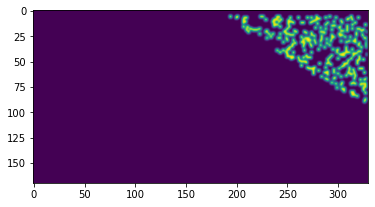

387 2571 [ 6. 11.]
194.4000000000001 341.0 6.099999999999909 97.09999999999991


In [159]:
# fastq_image = generate_img(y_coord,x_coord, 0, 0, max_y, max_x, 1, True, 1)
# image_array_FQ1 = np.asarray(fastq_image)
# idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+330) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170)]
# x_FQ = [x_coord[i] for i in idx]
# y_FQ = [y_coord[i] for i in idx]
# x_FQ = np.subtract(x_FQ,X_c-shift[1])
# y_FQ = np.subtract(y_FQ,Y_c-shift[0])
# fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, 170, 330, 1, True, 1)
# # image_array_FQ_t = image_array_FQ1[ Y_c:Y_c+170, X_c:X_c+330]
# # fig, ax = plt.subplots()
# # ax.imshow(image_array_FQ_t)
# # plt.show()
# fig, ax = plt.subplots()
# ax.imshow(fastq_image1)
# plt.show()
# print(X_c,Y_c, shift)
# print(min(x_FQ),max(x_FQ), min(y_FQ), max(y_FQ))

In [212]:
print(len(good_pos), len(matched_sequences), len(matched_centers_red), len(matched_centers_green))

79 79 79 79


In [310]:
# Extracting traces, Gauss fit version

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
    img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff'))
    seq_matched = matched_sequences[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            red2 = red1[y0:y1,x0:x1]
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            green2 = green1[y0:y1,x0:x1]
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))


    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

FileNotFoundError: [Errno 2] No such file or directory: 'H:\\221020_FC_Nano_Ha_CCR5Ctrl\\NoCas9\\Pos194.tiff'

In [331]:
# Extracting traces Standard version

for i, pos in enumerate(good_pos):
    # Reading the smFRET movie
#     img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))
    img_smFRET = io.imread(os.path.join(path_smFRET,pos,'B_Green','img_000000000.tiff'))
    seq_matched = matched_sequences[i]
    centers_red = matched_centers_red[i]
    centers_green = matched_centers_green[i]
    n_traces = len(centers_red)
    [h,w] = [256,512]
    n_frames = img_smFRET.shape[0]

    weights_red = np.zeros([n_traces,2*r+1,2*r+1])
    weights_green = np.zeros([n_traces,2*r+1,2*r+1])
    traces_red =  np.zeros([n_traces,n_frames])
    traces_green = np.zeros([n_traces,n_frames])
    # Extracting the traces from matched smFRET peaks
    # Extracting the traces from matched smFRET peaks
    # Select matching peaks from peak_locations and their sequences


    for j,coord in enumerate(centers_red):
        x, y = coord
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_red[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

        x, y = centers_green[j]
        x0 = int(x-r)
        x1 = int(x+r+1)
        y0 = int(y-r)
        y1 = int(y+r+1)
        dx = x-x0
        dy = y-y0

        it = np.nditer(weights_green[j], flags=['multi_index'], op_flags=['readwrite'])
        for w1 in it:
            yt,xt = it.multi_index
            w1[...] = 2*exp(-0.4*((xt-dx)**2+(yt-dy)**2))
        it.close()

    for i in range(n_frames):
        if i%100 == 0: print("Working on frame "+str(i))
        red1 = img_smFRET[i,256:,:]
        red1 = red1 - si.restoration.rolling_ball(red1, radius=rb_rad)
        green1 = img_smFRET[i,:256,:]
        green1 = green1 - si.restoration.rolling_ball(green1, radius=rb_rad)

        for j,coord in enumerate(centers_red):
            x, y = coord
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            red2 = red1[y0:y1,x0:x1]
            traces_red[j,i] = np.sum(np.multiply(weights_red[j],red2))

            x, y = centers_green[j]
            x0 = int(x-r)
            x1 = int(x+r+1)
            y0 = int(y-r)
            y1 = int(y+r+1)
            dx = x-x0
            dy = y-y0
            green2 = green1[y0:y1,x0:x1]
            traces_green[j,i] = np.sum(np.multiply(weights_green[j],green2))


    # Save traces and sequences
    frame_rate = 5
    mdict = {
        "time": np.divide(range(n_frames),frame_rate),
        "Cy3": traces_green,
        "Cy5": traces_red,
        "Seq": seq_matched
    }

    savemat(os.path.join(current_direct, pos + "_traces.mat"), mdict)

Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on frame 300
Working on frame 400
Working on frame 0
Working on frame 100
Working on frame 200
Working on f

# Main pipeline ends here

In [ ]:

    root = tk.Tk()
    root.attributes("-topmost", True)
    root.withdraw()
    labels_res = []
    posX_res = []
    posY_res = []
    file_path = fd.askopenfilename(title = "Choose the position list", initialdir = "D:/Experiments/MUSCLE DONUTS/20220824_FC_Nano_Cas9_CCR5/parameter")
    pos_file = open(file_path)
    data = json.load(pos_file)
    POS = data['POSITIONS']

    labels = [P['LABEL'] for P in POS]
    posX = [P['DEVICES'][0]['X'] for P in POS]
    posY = [P['DEVICES'][0]['Y'] for P in POS]
    
    for i,x in enumerate(labels):
        x = int(2329 + (posX[i] - 28522.9)/0.34)
        y = int(2042 - (posY[i] + 1313.3)/0.34)
        if (x > 0 ) and (y > 0):
            if (y+y_border<2866) and (x+x_border < 2944) :
                labels_res.append (labels[i])
                posX_res.append (posX[i])
                posY_res.append( posY[i])
    
    
    X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos279']
    #X_c, Y_c = scaling_seq(X_c[0], Y_c[0])

In [ ]:
app_dir = "C:/Users/panf/Documents/Muscle_intermediates/test_folder_4/"
for pos in labels_res :
    for current_dir,dirs, files in os.walk(app_dir) :
        for el in files: 
            print(el.split('.')[-2])
            print(pos)
            if el.split('.')[-2] == pos:
                img1 = io.imread(current_dir + '/' + el) #reading the stack of images
                
                img1 = img1.astype("ushort") #turn from float format to ushort
                img1 = img1 [256:512, 0:512]
                plt.figure()
                plt.imshow(img1)


In [ ]:
X_c = [posX[i] for i,x in enumerate(labels) if labels[i]=='Pos148']
Y_c = [posY[i] for i,x in enumerate(labels) if labels[i]=='Pos148']

x_c, y_c = scaling_seq (X_c[0], Y_c[0])
print (x_c, y_c)

In [ ]:
import math
seq_coord = np.empty([0,2], dtype=int)
fret_coord = np.empty([0,2], dtype=int)
current_direct = "D:/nanobio/uppsala/muscle/Muscle_Misha/beads/"
for current_dir,dirs, files in os.walk(current_direct) :
        for el in files: 
            coord = np.load(current_dir + '/' + el) 
            length = len(coord)
            fret_coord = np.concatenate ((fret_coord, coord[0:int(length/2)] ), axis = 0 )
            seq_coord = np.concatenate ((seq_coord, coord[int(length/2):length] ), axis = 0 )

seq_coord = seq_coord * 1.7
#print(seq_coord)
#print(fret_coord)
distance1 = []
length = len(seq_coord)
print (length)
res = np.concatenate ((seq_coord, fret_coord), axis = 1)
for i in range(length):
    
    distance1.append(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))
    print(math.sqrt(math.pow((seq_coord[i][0] - fret_coord[i][0]),2) + math.pow((seq_coord[i][1] - fret_coord[i][1]),2)))


In [218]:
processed_pos = []

In [250]:
# ALTERNATIVE MAIN CYCLE to reanalyse the data with existing manual bead coordinates
for pos in labels_res :
#     for current_dir,dirs, files in os.walk(beads_dir) :
# #         for el in files:     
#             if el.split('.')[-2] == pos:
    path1 = os.path.join(beads_dir,pos+'.tiff')
    if os.path.exists(path1)&(not os.path.exists(os.path.join(path_smFRET, pos + "_traces.mat")))&(not pos in processed_pos):
#         data['sequence'] = []
        processed_pos.append(pos)
        pos_direct = os.path.join(current_direct, pos)
        os.makedirs(pos_direct, exist_ok=True)
        log_file = open(os.path.join(pos_direct, pos + "_log.txt"), 'w')
        log_file.write('Working on: '+ pos+'\n')
        FRET_coord = []
        seq_coord = []
        point = []
        counter = 0
        rb_rad = 10
        img_beads_F = io.imread(path1) #reading the stack of images
        if len(img_beads_F.shape) == 3:
            img_beads_F = np.mean(img_beads_F, axis = 0) #averaging by the stack
        img_beads_F = img_beads_F.astype("ushort") #turn from float format to ushort
        img_beads_F = img_beads_F [256:512, 0:512]
        img_beads_F = img_beads_F - si.restoration.rolling_ball(img_beads_F, radius=rb_rad)
        image_array_F = transform.warp(img_beads_F, apriori_tr_inv, output_shape = [y_border, x_border])
        image_array_F = img_as_ubyte(image_array_F)
        #img = io.imread(current_dir + '/' + el) #initial reading of original averaging image
        #img = cv2.imread(app.st)
#         plt.figure()
#         plt.imshow(img1)
#         plt.figure()
#         plt.imshow(seq)

        image_array_F = np.asarray(image_array_F) #array from FRET image
#         plt.figure()
#         plt.imshow(image_array_F)
        
        idx = [i for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 X_c = [posX_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
#                 Y_c = [posY_res[i] for i,x in enumerate(labels_res) if labels_res[i]==pos]
        X_c = [posX_res[i] for i in idx]
        Y_c = [posY_res[i] for i in idx]

        X_c, Y_c = scaling_seq(X_c[0], Y_c[0])
#         print (X_c, Y_c)
        point.append(X_c)
        point.append(Y_c)
        point = np.array(point)
        image_array_seq_t = image_array_seq[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_max_t = image_array_max[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        image_array_FQ_t = image_array_FQ[ Y_c:Y_c+y_border, X_c:X_c+x_border]
        idx = [i for i,x in enumerate(x_coord) if x_coord[i] >= X_c and (x_coord[i] <= X_c+x_border) and (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+y_border)]
        x_FQ = [x_coord[i] for i in idx]
        y_FQ = [y_coord[i] for i in idx]
        seq_t = [sequence[i] for i in idx]
        if len(seq_t)<100:
            log_file.write('Not enough (<100) clusters: '+ str(len(seq_t))+ '\n')
            continue



#                 for i in range (len(sequence)):
#                     if (x_coord[i] >= X_c) and (x_coord[i] <= X_c+330): 
#                         if (y_coord[i] >= Y_c) and (y_coord[i] <= Y_c+170):
#                                 data['sequence'].append({
#                                                      'X': x_coord[i],
#                                                      'Y': y_coord[i],
#                                                      'sequence': sequence[i]
#                                                         })

        #print(image_array)
        v_min, v_max = np.percentile(image_array_F, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_F)
        better_contrast_image_array = exposure.rescale_intensity(image_array_F, in_range=(v_min, v_max))
        better_contrast_img = Image.fromarray(better_contrast_image_array)
        better_contrast_img.save(pos_direct + '/'+pos + '_contr.tif')
        better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        #reading by cv2 to make possible circles in color
        #img_jpg = io.imread('C:/Users/panf/Documents/Muscle_intermediates/AVG_G10_1_1_MMStack_Pos0.ome.jpg')
        #img_array = img_as_int(img)
        # displaying the image
        # setting mouse handler for the image
        # and calling the click_event() function
        image_seq = Image.fromarray(image_array_seq_t)
        image_seq.save (pos_direct + '/'+ pos+'_seq.tif')

        image_fastq = Image.fromarray(image_array_FQ_t)
#         plt.figure()
#         plt.imshow(image_fastq)
        image_fastq.save (pos_direct + '/'+ pos+'_fastq.tif')

        v_min, v_max = np.percentile(image_array_seq_t, (0, 99.8))
        if v_max == 0: v_max = np.max(image_array_seq_t)
        better_contrast_image_array_2 = exposure.rescale_intensity(image_array_seq_t, in_range=(v_min, v_max))
        better_contrast_img_2 = Image.fromarray(better_contrast_image_array_2)
        better_contrast_img_2.save(pos_direct + '/'+''+ pos+'_contr_MIN_seq_stack.tif')
        better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')     

#         plt.figure()
#         plt.imshow( Image.fromarray(image_array_seq_t))     
        
        # User clicks of beads with "q" for exit when done
        FRET_coord = []
        seq_coord = []
#         cv2.namedWindow(pos) 
#         cv2.namedWindow(pos+'_seq') 
#         cv2.setMouseCallback(pos,  click_event_FRET)
#         cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#         #cv2.setMouseCallback('image1',  click_event)
#         while(1):
#             cv2.imshow(pos,better_contrast_img)
#             cv2.imshow(pos+'_seq',better_contrast_img_2)
#             k = cv2.waitKey(1)&0xFF 
#             #if cv2.waitKey(20) & 0xFF == 27: #press Esc to quit
#             if k == ord('q'): # Press 'q' to finish
#                 if len(seq_coord) == len(FRET_coord):
#                     break
#                 else:
#                     counter = 0
#                     cv2.destroyAllWindows()
#                     FRET_coord = []
#                     seq_coord = []
#                     cv2.namedWindow(pos) 
#                     cv2.namedWindow(pos+'_seq') 
#                     cv2.setMouseCallback(pos,  click_event_FRET)
#                     cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                     better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                     better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
#             elif k == ord('r'): # Press 'r' to restart
#                 counter = 0
#                 cv2.destroyAllWindows()
#                 FRET_coord = []
#                 seq_coord = []
#                 cv2.namedWindow(pos) 
#                 cv2.namedWindow(pos+'_seq') 
#                 cv2.setMouseCallback(pos,  click_event_FRET)
#                 cv2.setMouseCallback(pos+'_seq',  click_event_seq)
#                 better_contrast_img_2 = cv2.imread(pos_direct + '/'+pos+ '_contr_MIN_seq_stack.tif')
#                 better_contrast_img = cv2.imread(pos_direct + '/'+pos + '_contr.tif')
        
#         cv2.destroyAllWindows()
        
        # If the user selected at least three beads we proceed with analysis
        if os.path.exists(pos_direct + '/' + pos+'_manual_coord.npy'): 
            result = np.load(pos_direct + '/' + pos+'_manual_coord.npy')
#             seq_coord = np.reshape(seq_coord,(int((counter+1)/2), 2))
            
#             FRET_coord = np.reshape(FRET_coord,(int((counter+1)/2), 2))
#             FRET_coord = apriori_tr_inv(FRET_coord)
            split = int(len(result)/2)
            FRET_coord = result[:split,:]
            seq_coord = result[split:,:]
#             np.save(pos_direct + '/' + pos+'_manual_coord', result)
            
            # Calculating the shift between the FASTQ and cluster images using cross-correlation
            shift = phase_cross_correlation(image_array_max_t,image_array_FQ_t)
            shift = shift[0]
            # Translation of the FASTQ sequences in the FOV to match the cluster image
            x_FQ = np.subtract(x_FQ,X_c-shift[1])
            y_FQ = np.subtract(y_FQ,Y_c-shift[0])
            max_image = Image.fromarray(image_array_max_t)
            max_image.save(os.path.join(pos_direct,pos+'_MAX_seq.png'))
            fastq_image1 = generate_img(y_FQ,x_FQ, 0, 0, y_border, x_border, 1, True, 1)
            fastq_image1.save(os.path.join(pos_direct,pos+'_FQ_aligned.png'))
            fig, ax = plt.subplots()
            ax.imshow(fastq_image1)
            plt.show()


            # Selecting the library sequences for further analysis
            idx = [i for i,x in enumerate(seq_t) if library_seq in x]
            x_FQ = [x_FQ[i] for i in idx]
            y_FQ = [y_FQ[i] for i in idx]
            seq_t = [seq_t[i] for i in idx]

            # Calculating the first rough transformation based on manually-selected beads
            rough_tr = transform.estimate_transform("similarity", src=FRET_coord, dst=seq_coord)
            np.save(os.path.join(pos_direct, pos + "_man_bead_tr"), rough_tr)
            # Refining the transformation based on automatically-selected beads
            movie_centers = blob_detection(
                np.asarray(img_beads_F),
                min_sigma=1,
                max_sigma=10,
                threshold=0.01
            )

            seq_centers = blob_detection(
                image_array_seq_t,
                min_sigma=1,
                max_sigma=10,
                threshold=0.0001, # Was 0.00001 for 19/07/2022; 0.0001 for 06/09/2022
             )
            
            res, idx = count_nearest_pts(rough_tr(movie_centers), seq_centers, 8)
            movie_centers1 = movie_centers[idx[np.where(res != inf)]]
            seq_centers1 = seq_centers[np.where(res != inf)]
            print('Automatically matched beads: ',seq_centers1.shape[0])
            if seq_centers1.shape[0] >2:
                log_file.write("Detected " + str(seq_centers1.shape[0]) + " matched beads. Updating the manual transformation\n")                
                rough_tr1 = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            else:
                log_file.write("""Not enough (<3) automatically detected and matched beads to update the initial
                               transformation estimate based on manually selected beads\n""")
                rough_tr1 = rough_tr

            np.save(os.path.join(pos_direct, pos + "_auto_bead_tr"), rough_tr1)
            # Reading the smFRET movie
            img_smFRET = io.imread(os.path.join(path_smFRET,pos+'.tiff'))

            # Averaging the first 10 frames to select peaks
            img_t = np.mean(img_smFRET[0:10,::], axis = 0)
            img_t = img_t.astype("ushort")
            rb_rad = 10
            #print(img1[10:20,10:20])
            #img = np.zeros([20,20])
            #img[10,5] = 1000
            red = img_t[256:,:]
            green = img_t[:256,:]
            red = red - si.restoration.rolling_ball(red, radius=rb_rad)
            green = green - si.restoration.rolling_ball(green, radius=rb_rad)
            green = transform.warp(green,tr_R2G, preserve_range = True)
            combined = red + green # Consider adding the red excitation channel, though there are some difficulties, e.g. beads and int scaling
            fig, ax = plt.subplots()
            ax.imshow(combined)
            blobs_log = blob_log(combined, max_sigma=10, num_sigma=10, threshold=300) # Was 1000 for 19/07/2022; 300 for 06/09/2022
            CM = []
            r = 3
            [h,w] = red.shape
            n_frames = img_smFRET.shape[0]

            for i, blob in enumerate(blobs_log):
                x, y, d = blob
                if x>r and x<(h-r) and y>r and y<(w-r):
                    temp = ndimage.measurements.center_of_mass(combined[int(x-r):int(x+r+1),int(y-r):int(y+r+1)])
                    CM.append(np.flip(np.add(temp, [x-r,y-r])))

                    c = plt.Circle(CM[-1], 3, color="red", linewidth=1, fill=False)
                    ax.add_patch(c)
            ax.set_axis_off()
            plt.savefig(os.path.join(pos_direct, pos + "_smFRET_peaks.tif"))
            plt.show()
            
            
            smFRET_centers = np.array(CM)
            FQ_centers = np.concatenate((x_FQ, y_FQ)).reshape((-1, 2), order='F')
            res, idx = count_nearest_pts(rough_tr1(smFRET_centers), FQ_centers, 8)
            movie_centers1 = smFRET_centers[idx[np.where(res != inf)]]
            seq_centers1 = FQ_centers[np.where(res != inf)]

            # Calculating the polynomial tranformation between FRET peaks and clusters
            
#             if seq_centers1.shape[0]>=9:
#                 order = 2
#             if seq_centers1.shape[0]>=4:
#                 order = 1
#             else: continue
            if seq_centers1.shape[0]<4: 
                log_file.write('Not enough smFRET peaks (<4)')
                continue
            
            tr = transform.estimate_transform("similarity", src=movie_centers1, dst=seq_centers1)
            tr_inv = transform.estimate_transform("similarity", src=seq_centers1, dst=movie_centers1)
            np.save(os.path.join(pos_direct, pos + "_final_tr"), tr)
            np.save(os.path.join(pos_direct, pos + "_final_tr_inv"), tr_inv)
            log_file.write('Matched clusters before polywarp: ' + str(seq_centers1.shape[0])+'\n')
            print('Matched clusters before polywarp: ',seq_centers1.shape[0])
            
#             kx,ky = Polywarp.polywarp(seq_centers1[:,0],seq_centers1[:,1],movie_centers1[:,0],movie_centers1[:,1],degree=order)
# #             print(kx)
# #             print(ky)
#             tr = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr.params = par        

#             kx,ky = Polywarp.polywarp(movie_centers1[:,0],movie_centers1[:,1],seq_centers1[:,0],seq_centers1[:,1],degree=order)
#             tr_inv = transform.PolynomialTransform()
#             #tr.estimate(src,dst,order = 2)

#             order1 = 2*order
#             pidx = 0
#             par = np.zeros([2,int((order1+1)*(order1+2)/2)])
#             for j in range(order1 + 1):
#                 for i in range(j + 1):
#                     if (j-i)<=order and i<=order:
#                         par[0, pidx] = kx[j - i,i]
#                         par[1, pidx] = ky[j - i,i]
#                     else:
#                         par[0, pidx] = 0
#                         par[1, pidx] = 0
#                     pidx += 1
#             tr_inv.params = par

            res, idx = count_nearest_pts(tr(smFRET_centers), FQ_centers, 8) # Was 4 for 19/07/2022
            centers_matched = smFRET_centers[idx[np.where(res != inf)]]
            idx_t = np.where(res != inf)
            seq_matched = [seq_t[i] for i in idx_t[0]]
            FQ_centers_matched = FQ_centers[idx_t]
            
            
            centers_red = centers_matched
            centers_green = tr_R2G(centers_matched)
            r = 3
            # Weed out positions that are too close to the edge
            idx_t = np.where((centers_red[:,0]>r) & (centers_red[:,0]<(w-r)) & (centers_red[:,1]>r) & (centers_red[:,1]<(h-r))  & 
                             (centers_green[:,0]>r) & (centers_green[:,0]<(w-r)) & (centers_green[:,1]>r) & (centers_green[:,1]<(h-r)))
            centers_red = centers_red [idx_t]
            centers_green = centers_green [idx_t]
            seq_matched = [seq_matched[i] for i in idx_t[0]]
            
            matched_sequences.append(seq_matched)
            matched_centers_red.append(centers_red)
            matched_centers_green.append(centers_green)
            good_pos.append(pos)
            log_file.write('Matched clusters after polywarp: ' + str(len(seq_matched))+'\n')
            log_file.write('Out of ' + str(len(smFRET_centers)) + ' smFRET peaks and ' + str(len(FQ_centers)) + ' clusters'+'\n')
            log_file.write('Percentage of matched smFRET peaks: ' + str(int(100*len(seq_matched)/len(smFRET_centers)))+'\n')
            log_file.write('Percentage of matched clusters: ' + str(int(100*len(seq_matched)/len(FQ_centers)))+'\n')
            print('Matched clusters after polywarp: ',len(seq_matched))
            print('Out of ',len(smFRET_centers), ' smFRET peaks and ', len(FQ_centers), ' clusters')
            print('Percentage of matched smFRET peaks: ',int(100*len(seq_matched)/len(smFRET_centers)))
            print('Percentage of matched clusters: ',int(100*len(seq_matched)/len(FQ_centers)))
            # Saving transformed bead and molecule images for QC
            img_beads_tfd = Image.fromarray(transform.warp(img_beads_F, tr_inv, output_shape = [y_border, x_border]))
            img_beads_tfd.save(os.path.join(pos_direct, pos + "_beads_transformed.tif"))
            img_smFRET_tfd = Image.fromarray(transform.warp(combined, tr_inv, output_shape = [y_border, x_border]))
            img_smFRET_tfd.save(os.path.join(pos_direct, pos + "_smFRET_transformed.tif"))
            centers_red_tfd = tr(centers_red)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_matched_transformed.tif"))
            
            centers_red_tfd = tr(smFRET_centers)
            img_centers_red_tfd = generate_img(centers_red_tfd[:,1],centers_red_tfd[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_smFRET_peaks_all_transformed.tif"))
            
            img_centers_red_tfd = generate_img(FQ_centers_matched[:,1],FQ_centers_matched[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_matched.tif"))
                    
            img_centers_red_tfd = generate_img(FQ_centers[:,1],FQ_centers[:,0], 0, 0, y_border, x_border, 1, True, 1)
            img_centers_red_tfd.save(os.path.join(pos_direct, pos + "_FQ_lib_all.tif"))
        else:   log_file.write('Not enough manually matched beads\n')

# Save good pos data to be able to extract traces later
frame_rate = 5
mdict1 = {
    "good_pos": good_pos,
    "matched_sequences": matched_sequences,
    "matched_centers_red": matched_centers_red,
    "matched_centers_green": matched_centers_green
}

savemat(os.path.join(current_direct, "good_pos.mat"), mdict1)


In [205]:
print(Y_c,X_c
     )

1896 -73
